In [1]:
%matplotlib inline 
import json
import numpy as np
import operator
import os
import pandas
import pylab as plt
import random
from ase.data import reference_states, atomic_numbers
from sklearn.neighbors import KernelDensity
from pyiron_atomistics import Project

In [2]:
import matplotlib as mpl
mpl.rc('font', family='Times New Roman')
plt.rcParams["mathtext.fontset"] = "stix"

In [3]:
from pyiron_atomistics.thermodynamics.interfacemethod import freeze_one_half, remove_selective_dynamics, set_server, create_job_template, fix_iso, fix_z_dir, half_velocity, minimize_pos, minimize_vol, next_calc, npt_solid, npt_liquid, next_step_funct, round_temperature_next, strain_circle, analyse_minimized_structure, get_press, get_center_point, get_strain_lst, get_nve_job_name, plot_solid_liquid_ratio, ratio_selection, plot_equilibration, plot_melting_point_prediction, calc_temp_iteration, get_initial_melting_temperature_guess, validate_convergence, initialise_iterators, get_voronoi_volume, check_for_holes

In [4]:
pr = Project('melting')

In [5]:
input_file = os.path.join(pr.path, 'input.json')
output_file = os.path.join(pr.path, 'output.json')

In [6]:
# Parameters
input_file = "input.json"
output_file = "output.json"


In [7]:
pr.job_table()

,id,status,chemicalformula,job,subjob,projectpath,project,timestart,timestop,totalcputime,computer,hamilton,hamversion,parentid,masterid
0,19,finished,Fe4394,temp_heating_1625_0,/temp_heating_1625_0,/scratch/janssen/pyiron_meltingpoint/,melting/,2023-06-28 08:06:49.070773,2023-06-28 08:06:51.689618,2.0,pyiron@ljubi#12,Lammps,0.1,NaN,None
1,20,finished,Fe4394,temp_heating_1687_5,/temp_heating_1687_5,/scratch/janssen/pyiron_meltingpoint/,melting/,2023-06-28 08:06:52.706454,2023-06-28 08:06:54.354728,1.0,pyiron@ljubi#12,Lammps,0.1,NaN,None
2,21,finished,Fe4394,temp_heating_1718_75,/temp_heating_1718_75,/scratch/janssen/pyiron_meltingpoint/,melting/,2023-06-28 08:06:55.346286,2023-06-28 08:06:57.026526,1.0,pyiron@ljubi#12,Lammps,0.1,NaN,None
3,22,finished,Fe4394,temp_heating_1703_125,/temp_heating_1703_125,/scratch/janssen/pyiron_meltingpoint/,melting/,2023-06-28 08:06:58.037308,2023-06-28 08:06:59.772702,1.0,pyiron@ljubi#12,Lammps,0.1,NaN,None
4,23,finished,Fe4394,temp_heating_1710_9375,/temp_heating_1710_9375,/scratch/janssen/pyiron_meltingpoint/,melting/,2023-06-28 08:07:00.772416,2023-06-28 08:07:02.410603,1.0,pyiron@ljubi#12,Lammps,0.1,NaN,None
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
723,762,finished,Si4096,temp_heating_3015_625,/temp_heating_3015_625,/scratch/janssen/pyiron_meltingpoint/,melting/,2023-07-03 13:57:00.468725,2023-07-03 13:57:01.953763,1.0,pyiron@ljubi#12,Lammps,0.1,NaN,None
724,763,finished,Si4096,temp_heating_3007_8125,/temp_heating_3007_8125,/scratch/janssen/pyiron_meltingpoint/,melting/,2023-07-03 13:57:02.954850,2023-07-03 13:57:04.345194,1.0,pyiron@ljubi#12,Lammps,0.1,NaN,None
725,764,finished,Si8192,ham_npt_solid_3008,/ham_npt_solid_3008,/scratch/janssen/pyiron_meltingpoint/,melting/,2023-07-03 13:57:06.091993,2023-07-03 14:00:08.317800,182.0,pyiron@ljubi#12,Lammps,0.1,NaN,None
726,765,finished,Si8192,ham_npt_liquid_high_4008,/ham_npt_liquid_high_4008,/scratch/janssen/pyiron_meltingpoint/,melting/,2023-07-03 14:00:08.583463,2023-07-03 14:03:20.876849,192.0,pyiron@ljubi#12,Lammps,0.1,NaN,None


In [8]:
if os.path.exists(input_file) and os.stat(input_file).st_size != 0:
    with open(input_file, 'r') as f:
        input_dict = json.load(f)
else:
    input_dict = {
        "config": [
            "pair_style morse 9.97749\n",
            "pair_coeff * * 0.4174 1.3885 2.845\n"
        ],
        "species": ["Al"],
        "element": "Al"
    }


In [9]:
input_dict

{'config': ['pair_style sw \n', 'pair_coeff * * Si.sw Si\n'],
 'filename': './examples/diaSi//Si.sw',
 'species': ['Si'],
 'element': 'Si',
 'cpu_cores': 12}

In [10]:
pot_dict = input_dict.copy()

In [11]:
if 'model' not in pot_dict.keys():
    pot_dict['model'] = 'Lammps'
if 'name' not in pot_dict.keys():
    pot_dict['name'] = 'CustomPotential'
if 'filename' not in pot_dict.keys():
    pot_path = []
else:
    pot_path = [os.path.abspath(pot_dict['filename'])]
potential = pandas.DataFrame({'Config': [pot_dict['config']],
                             'Filename': [pot_path],
                             'Model': [pot_dict['model']],
                             'Name': [pot_dict['name']],
                             'Species': [pot_dict['species']]
                             })

In [12]:
project_parameter = {
    'project': pr,
    'run_time_steps': 50000,
    'nvt_run_time_steps': 10000,
    'nve_run_time_steps': 10000,
    'temperature_left': 0,
    'temperature_right': 1000,
    'strain_run_time_steps': 1000,
    'convergence_criterion': 1,
    'potential': potential,
    'cpu_cores': 1, 
    'job_type': pr.job_type.Lammps,
    'enable_h5md': False,
    'points': 21,
    'boundary_value': 0.25,
    'ratio_boundary': 0.25,
    'timestep_lst': [2, 2, 1],
    'fit_range_lst': [0.05, 0.01, 0.01],
    'nve_run_time_steps_lst': [25000, 20000, 50000],
    'number_of_atoms': 8000, 
}

In [13]:
for k in input_dict.keys():
    project_parameter[k] = input_dict[k]

In [14]:
if 'crystalstructure' not in project_parameter.keys():
    project_parameter['crystalstructure'] = reference_states[atomic_numbers[project_parameter['element']]]['symmetry']

In [15]:
if 'seed' not in project_parameter.keys():
    project_parameter['seed'] = random.randint(0,99999)
project_parameter['seed']

59473

In [16]:
# Values from a previous calculation can be inserted here to reproduce the results 
step_dict = {}
if os.path.exists(output_file):
    with open(output_file, 'r') as f:
        step_dict_str = json.load(f)
    for k,v in step_dict_str.items():
        step_dict[int(k)] = v
step_dict

{}

# From here on the notebook is automated - no change required !

In [17]:
step_count = 0
temperature_next = None
enable_iteration = True
convergence_goal_achieved = False

In [18]:
pr = project_parameter['project']

In [19]:
if 'lattice_constant' in project_parameter.keys():
    a = project_parameter['lattice_constant']
else:
    a = None
if project_parameter['crystalstructure'] == 'hcp':
    basis = pr.create_ase_bulk(name=project_parameter['element'], crystalstructure=project_parameter['crystalstructure'].lower(), a=a, orthorhombic=True)
else:
    basis = pr.create_ase_bulk(name=project_parameter['element'], crystalstructure=project_parameter['crystalstructure'].lower(), a=a, cubic=True)
basis_lst = [basis.repeat([i, i, i]) for i in range(5,30)]
basis = basis_lst[np.argmin([np.abs(len(b)-project_parameter['number_of_atoms']/2) for b in basis_lst])]

/tmp/ipykernel_31834/1146714203.py:8: DeprecationWarning: pyiron_atomistics.project.create_ase_bulk is deprecated: Use create.structure.bulk instead.
  basis = pr.create_ase_bulk(name=project_parameter['element'], crystalstructure=project_parameter['crystalstructure'].lower(), a=a, cubic=True)


In [20]:
basis.analyse_ovito_cna_adaptive()

/tmp/ipykernel_31834/1156557528.py:1: DeprecationWarning: pyiron_atomistics.atomistics.structure.atoms.analyse_ovito_cna_adaptive is deprecated: Use Atoms.analyse.pyscal_cna_adaptive() with ovito_compatibility=True instead.
  basis.analyse_ovito_cna_adaptive()


{'CommonNeighborAnalysis.counts.OTHER': 4096,
 'CommonNeighborAnalysis.counts.FCC': 0,
 'CommonNeighborAnalysis.counts.HCP': 0,
 'CommonNeighborAnalysis.counts.BCC': 0,
 'CommonNeighborAnalysis.counts.ICO': 0}

In [21]:
basis.plot3d()

NGLWidget()

In [22]:
# pr.remove_jobs(recursive=True)

In [23]:
timestep_iter, fit_range_iter, nve_run_time_steps_iter = initialise_iterators(project_parameter)
timestep = next(timestep_iter)
fit_range = next(fit_range_iter)
nve_run_time_steps = next(nve_run_time_steps_iter)

In [24]:
pr.job_table()

,id,status,chemicalformula,job,subjob,projectpath,project,timestart,timestop,totalcputime,computer,hamilton,hamversion,parentid,masterid
0,19,finished,Fe4394,temp_heating_1625_0,/temp_heating_1625_0,/scratch/janssen/pyiron_meltingpoint/,melting/,2023-06-28 08:06:49.070773,2023-06-28 08:06:51.689618,2.0,pyiron@ljubi#12,Lammps,0.1,NaN,None
1,20,finished,Fe4394,temp_heating_1687_5,/temp_heating_1687_5,/scratch/janssen/pyiron_meltingpoint/,melting/,2023-06-28 08:06:52.706454,2023-06-28 08:06:54.354728,1.0,pyiron@ljubi#12,Lammps,0.1,NaN,None
2,21,finished,Fe4394,temp_heating_1718_75,/temp_heating_1718_75,/scratch/janssen/pyiron_meltingpoint/,melting/,2023-06-28 08:06:55.346286,2023-06-28 08:06:57.026526,1.0,pyiron@ljubi#12,Lammps,0.1,NaN,None
3,22,finished,Fe4394,temp_heating_1703_125,/temp_heating_1703_125,/scratch/janssen/pyiron_meltingpoint/,melting/,2023-06-28 08:06:58.037308,2023-06-28 08:06:59.772702,1.0,pyiron@ljubi#12,Lammps,0.1,NaN,None
4,23,finished,Fe4394,temp_heating_1710_9375,/temp_heating_1710_9375,/scratch/janssen/pyiron_meltingpoint/,melting/,2023-06-28 08:07:00.772416,2023-06-28 08:07:02.410603,1.0,pyiron@ljubi#12,Lammps,0.1,NaN,None
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
723,762,finished,Si4096,temp_heating_3015_625,/temp_heating_3015_625,/scratch/janssen/pyiron_meltingpoint/,melting/,2023-07-03 13:57:00.468725,2023-07-03 13:57:01.953763,1.0,pyiron@ljubi#12,Lammps,0.1,NaN,None
724,763,finished,Si4096,temp_heating_3007_8125,/temp_heating_3007_8125,/scratch/janssen/pyiron_meltingpoint/,melting/,2023-07-03 13:57:02.954850,2023-07-03 13:57:04.345194,1.0,pyiron@ljubi#12,Lammps,0.1,NaN,None
725,764,finished,Si8192,ham_npt_solid_3008,/ham_npt_solid_3008,/scratch/janssen/pyiron_meltingpoint/,melting/,2023-07-03 13:57:06.091993,2023-07-03 14:00:08.317800,182.0,pyiron@ljubi#12,Lammps,0.1,NaN,None
726,765,finished,Si8192,ham_npt_liquid_high_4008,/ham_npt_liquid_high_4008,/scratch/janssen/pyiron_meltingpoint/,melting/,2023-07-03 14:00:08.583463,2023-07-03 14:03:20.876849,192.0,pyiron@ljubi#12,Lammps,0.1,NaN,None


# Step 1: set up the solid sample and roughly estimate a melting point

In [25]:
ham_minimize_pos= minimize_pos(
    structure=basis, 
    project_parameter=project_parameter
)

2023-07-03 14:28:54,075 - pyiron_log - WARNING - No HDF5 file found - remove database entry and create new job! minimize_pos


/scratch/janssen/pyiron_meltingpoint/.snakemake/conda/810a48ff96828b631d3deb6ed8757de2_/lib/python3.10/site-packages/pyiron_atomistics/lammps/interactive.py:360: UserWarning: e_tol is deprecated as of vers. 0.3.0. It is not guaranteed to be in service in vers. 0.4.0. Use ionic_energy_tolerance instead.
  warnings.warn(
/scratch/janssen/pyiron_meltingpoint/.snakemake/conda/810a48ff96828b631d3deb6ed8757de2_/lib/python3.10/site-packages/pyiron_atomistics/lammps/interactive.py:366: UserWarning: f_tol is deprecated as of vers. 0.3.0. It is not guaranteed to be in service in vers. 0.4.0. Use ionic_force_tolerance instead.
  warnings.warn(


The job minimize_pos was saved and received the ID: 767


In [26]:
ham_minimize_vol = minimize_vol(
    structure=ham_minimize_pos.get_structure(), 
    project_parameter=project_parameter
)

2023-07-03 14:28:54,770 - pyiron_log - WARNING - No HDF5 file found - remove database entry and create new job! minimize_vol


/scratch/janssen/pyiron_meltingpoint/.snakemake/conda/810a48ff96828b631d3deb6ed8757de2_/lib/python3.10/site-packages/pyiron_atomistics/lammps/interactive.py:360: UserWarning: e_tol is deprecated as of vers. 0.3.0. It is not guaranteed to be in service in vers. 0.4.0. Use ionic_energy_tolerance instead.
  warnings.warn(
/scratch/janssen/pyiron_meltingpoint/.snakemake/conda/810a48ff96828b631d3deb6ed8757de2_/lib/python3.10/site-packages/pyiron_atomistics/lammps/interactive.py:366: UserWarning: f_tol is deprecated as of vers. 0.3.0. It is not guaranteed to be in service in vers. 0.4.0. Use ionic_force_tolerance instead.
  warnings.warn(


The job minimize_vol was saved and received the ID: 768


In [27]:
temperature_next, structure_left = get_initial_melting_temperature_guess(
    project_parameter=project_parameter, 
    ham_minimize_vol=ham_minimize_vol, 
    temperature_next=temperature_next
)

2023-07-03 14:28:56,679 - pyiron_log - WARNING - No HDF5 file found - remove database entry and create new job! temp_heating_1000


The job temp_heating_1000 was saved and received the ID: 769


2023-07-03 14:28:58,933 - pyiron_log - WARNING - No HDF5 file found - remove database entry and create new job! temp_heating_2000


The job temp_heating_2000 was saved and received the ID: 770


2023-07-03 14:29:01,280 - pyiron_log - WARNING - No HDF5 file found - remove database entry and create new job! temp_heating_3000


The job temp_heating_3000 was saved and received the ID: 771


The job temp_heating_2500_0 was saved and received the ID: 772


The job temp_heating_2750_0 was saved and received the ID: 773


The job temp_heating_2875_0 was saved and received the ID: 774


The job temp_heating_2937_5 was saved and received the ID: 775


The job temp_heating_2968_75 was saved and received the ID: 776


The job temp_heating_2984_375 was saved and received the ID: 777


The job temp_heating_2992_1875 was saved and received the ID: 778


In [28]:
temperature_next   # +/- 100K 

2992

In [29]:
if step_count in step_dict.keys():
    temperature_next = step_dict[step_count]['temperature_next']
else: 
    step_dict[step_count]= {'temperature_next': temperature_next}

In [30]:
step_dict

{0: {'temperature_next': 2992}}

# Step 2: set up the interface structure

The job ham_npt_solid_2992 was saved and received the ID: 779


The job ham_npt_liquid_high_3992 was saved and received the ID: 780


The job ham_npt_liquid_low_2992 was saved and received the ID: 781


2023-07-03 14:38:56,638 - pyiron_log - WARNING - Job 'ham_nve_0_95_2992_0' does not exist and cannot be loaded


The job ham_nvt_0_95_2992_0 was saved and received the ID: 782


2023-07-03 14:39:38,624 - pyiron_log - WARNING - Job 'ham_nve_0_955_2992_0' does not exist and cannot be loaded


The job ham_nvt_0_955_2992_0 was saved and received the ID: 783


2023-07-03 14:40:20,163 - pyiron_log - WARNING - Job 'ham_nve_0_96_2992_0' does not exist and cannot be loaded


The job ham_nvt_0_96_2992_0 was saved and received the ID: 784


2023-07-03 14:41:01,081 - pyiron_log - WARNING - Job 'ham_nve_0_965_2992_0' does not exist and cannot be loaded


The job ham_nvt_0_965_2992_0 was saved and received the ID: 785


2023-07-03 14:41:41,545 - pyiron_log - WARNING - Job 'ham_nve_0_97_2992_0' does not exist and cannot be loaded


The job ham_nvt_0_97_2992_0 was saved and received the ID: 786


2023-07-03 14:42:21,806 - pyiron_log - WARNING - Job 'ham_nve_0_975_2992_0' does not exist and cannot be loaded


The job ham_nvt_0_975_2992_0 was saved and received the ID: 787


2023-07-03 14:43:01,272 - pyiron_log - WARNING - Job 'ham_nve_0_98_2992_0' does not exist and cannot be loaded


The job ham_nvt_0_98_2992_0 was saved and received the ID: 788


2023-07-03 14:43:40,421 - pyiron_log - WARNING - Job 'ham_nve_0_985_2992_0' does not exist and cannot be loaded


The job ham_nvt_0_985_2992_0 was saved and received the ID: 789


2023-07-03 14:44:19,152 - pyiron_log - WARNING - Job 'ham_nve_0_99_2992_0' does not exist and cannot be loaded


The job ham_nvt_0_99_2992_0 was saved and received the ID: 790


2023-07-03 14:44:57,463 - pyiron_log - WARNING - Job 'ham_nve_0_995_2992_0' does not exist and cannot be loaded


The job ham_nvt_0_995_2992_0 was saved and received the ID: 791


2023-07-03 14:45:33,743 - pyiron_log - WARNING - Job 'ham_nve_1_0_2992_0' does not exist and cannot be loaded


The job ham_nvt_1_0_2992_0 was saved and received the ID: 792


2023-07-03 14:46:10,115 - pyiron_log - WARNING - Job 'ham_nve_1_005_2992_0' does not exist and cannot be loaded


The job ham_nvt_1_005_2992_0 was saved and received the ID: 793


2023-07-03 14:46:45,927 - pyiron_log - WARNING - Job 'ham_nve_1_01_2992_0' does not exist and cannot be loaded


The job ham_nvt_1_01_2992_0 was saved and received the ID: 794


2023-07-03 14:47:21,455 - pyiron_log - WARNING - Job 'ham_nve_1_015_2992_0' does not exist and cannot be loaded


The job ham_nvt_1_015_2992_0 was saved and received the ID: 795


2023-07-03 14:47:56,845 - pyiron_log - WARNING - Job 'ham_nve_1_02_2992_0' does not exist and cannot be loaded


The job ham_nvt_1_02_2992_0 was saved and received the ID: 796


2023-07-03 14:48:31,611 - pyiron_log - WARNING - Job 'ham_nve_1_025_2992_0' does not exist and cannot be loaded


The job ham_nvt_1_025_2992_0 was saved and received the ID: 797


2023-07-03 14:49:06,269 - pyiron_log - WARNING - Job 'ham_nve_1_03_2992_0' does not exist and cannot be loaded


The job ham_nvt_1_03_2992_0 was saved and received the ID: 798


2023-07-03 14:49:40,704 - pyiron_log - WARNING - Job 'ham_nve_1_035_2992_0' does not exist and cannot be loaded


The job ham_nvt_1_035_2992_0 was saved and received the ID: 799


2023-07-03 14:50:16,700 - pyiron_log - WARNING - Job 'ham_nve_1_04_2992_0' does not exist and cannot be loaded


The job ham_nvt_1_04_2992_0 was saved and received the ID: 800


2023-07-03 14:50:53,218 - pyiron_log - WARNING - Job 'ham_nve_1_045_2992_0' does not exist and cannot be loaded


The job ham_nvt_1_045_2992_0 was saved and received the ID: 801


2023-07-03 14:51:28,350 - pyiron_log - WARNING - Job 'ham_nve_1_05_2992_0' does not exist and cannot be loaded


The job ham_nvt_1_05_2992_0 was saved and received the ID: 802


The job ham_nve_0_95_2992_0 was saved and received the ID: 803


The job ham_nve_0_955_2992_0 was saved and received the ID: 804


The job ham_nve_0_96_2992_0 was saved and received the ID: 805


The job ham_nve_0_965_2992_0 was saved and received the ID: 806


The job ham_nve_0_97_2992_0 was saved and received the ID: 807


The job ham_nve_0_975_2992_0 was saved and received the ID: 808


The job ham_nve_0_98_2992_0 was saved and received the ID: 809


The job ham_nve_0_985_2992_0 was saved and received the ID: 810


The job ham_nve_0_99_2992_0 was saved and received the ID: 811


The job ham_nve_0_995_2992_0 was saved and received the ID: 812


The job ham_nve_1_0_2992_0 was saved and received the ID: 813


The job ham_nve_1_005_2992_0 was saved and received the ID: 814


The job ham_nve_1_01_2992_0 was saved and received the ID: 815


The job ham_nve_1_015_2992_0 was saved and received the ID: 816


The job ham_nve_1_02_2992_0 was saved and received the ID: 817


The job ham_nve_1_025_2992_0 was saved and received the ID: 818


The job ham_nve_1_03_2992_0 was saved and received the ID: 819


The job ham_nve_1_035_2992_0 was saved and received the ID: 820


The job ham_nve_1_04_2992_0 was saved and received the ID: 821


The job ham_nve_1_045_2992_0 was saved and received the ID: 822


The job ham_nve_1_05_2992_0 was saved and received the ID: 823


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


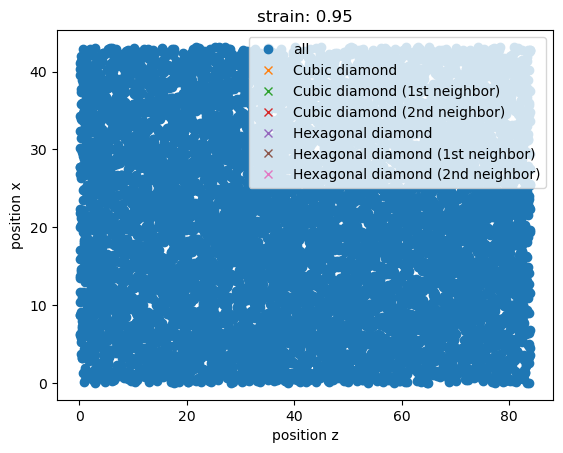

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


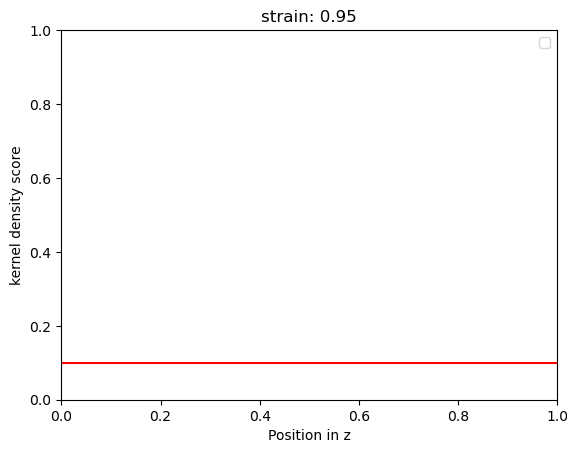

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


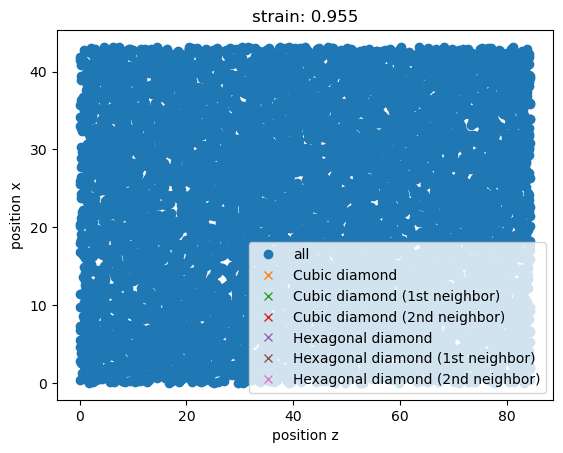

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


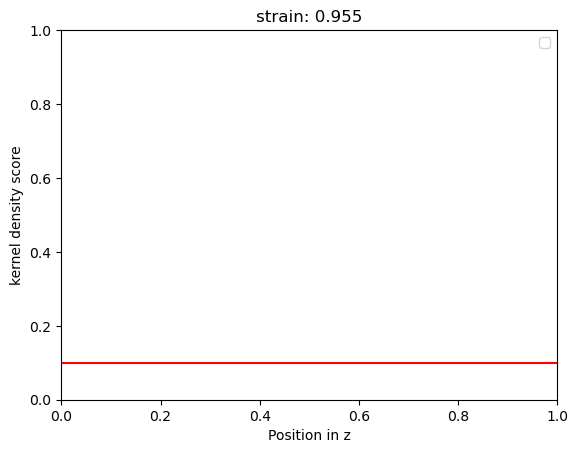

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


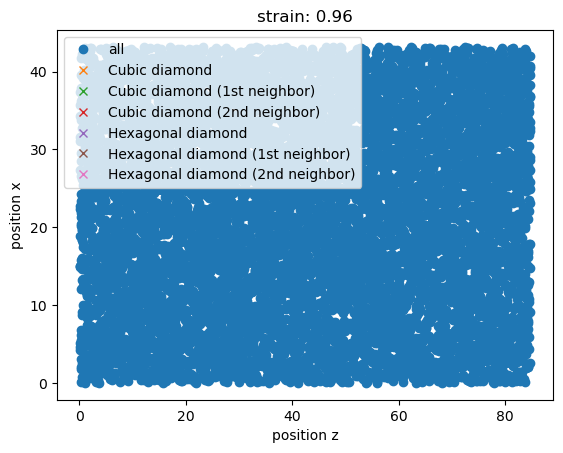

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


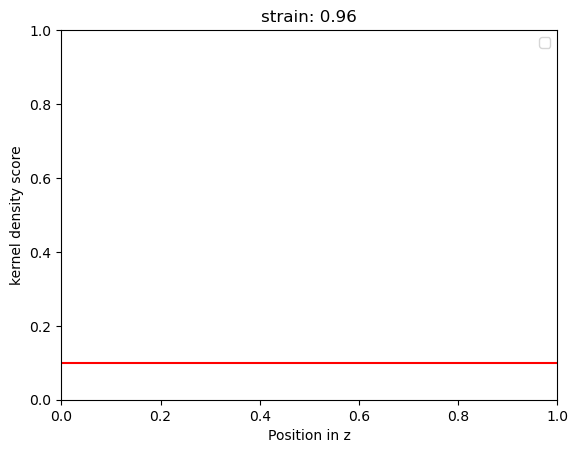

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


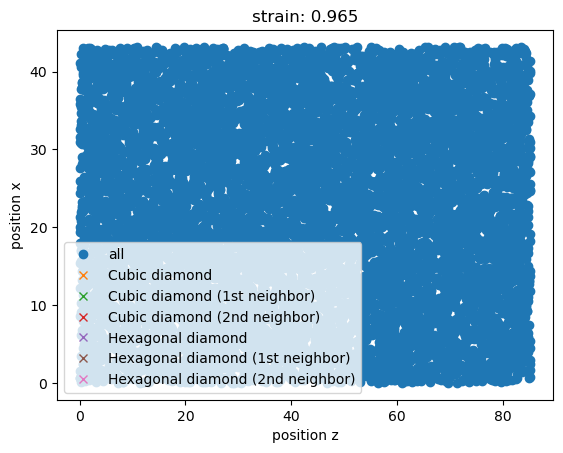

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


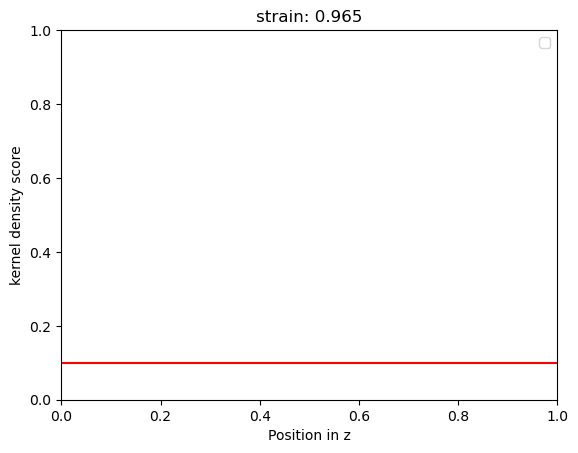

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


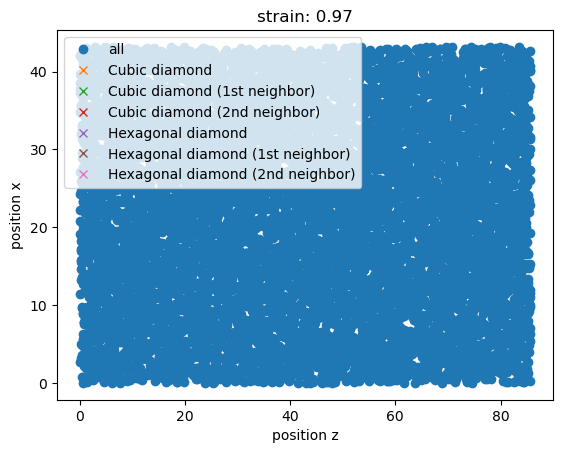

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


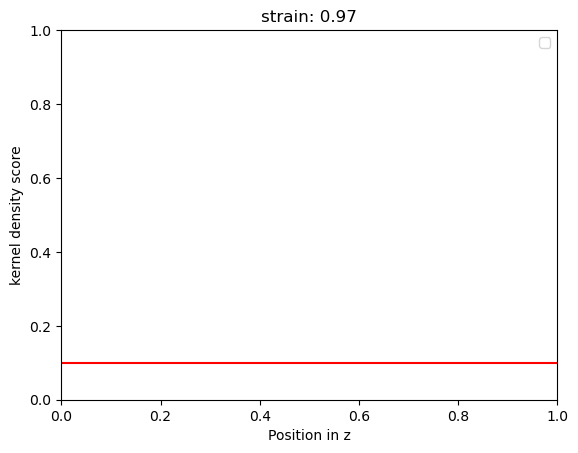

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


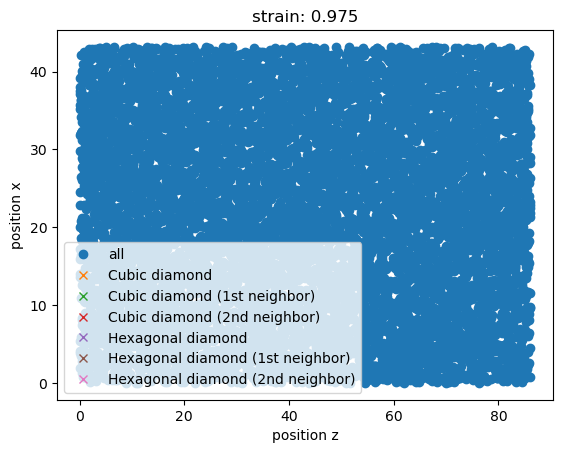

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


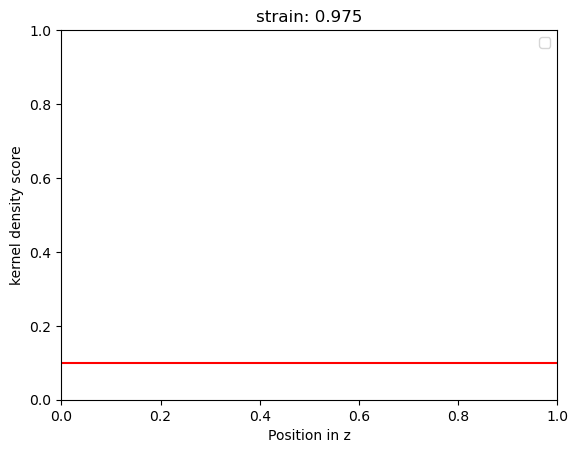

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


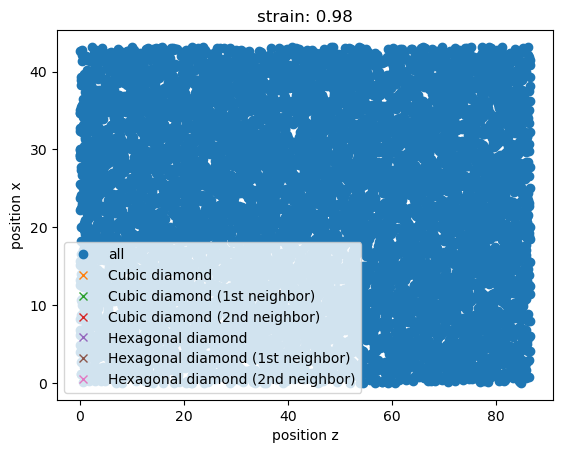

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


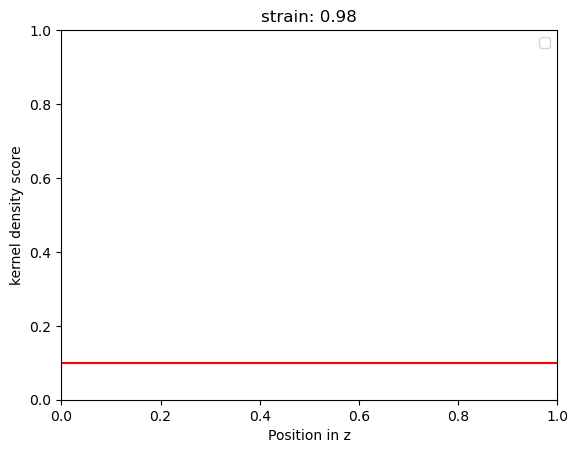

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


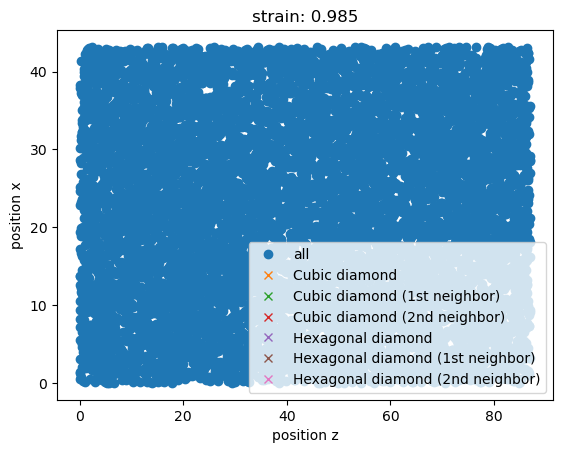

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


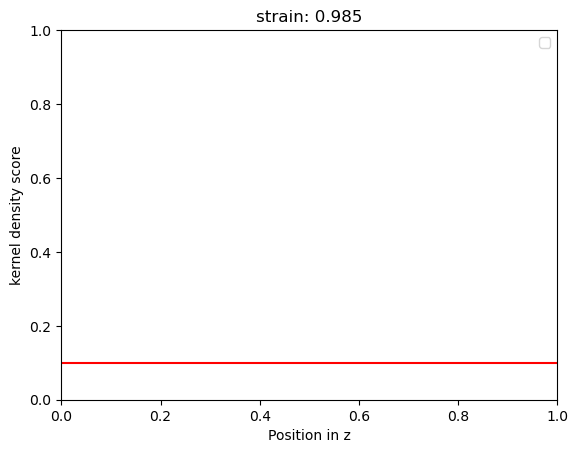

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


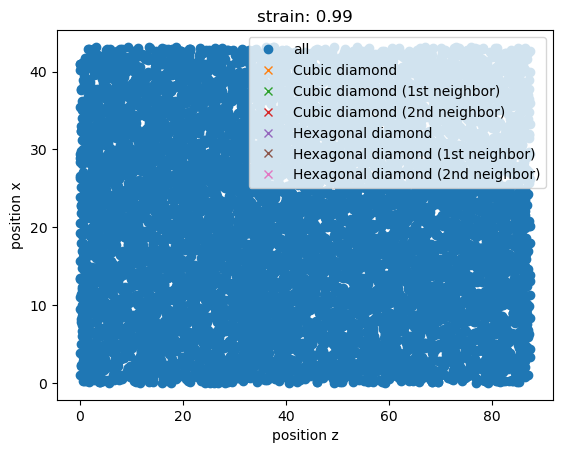

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


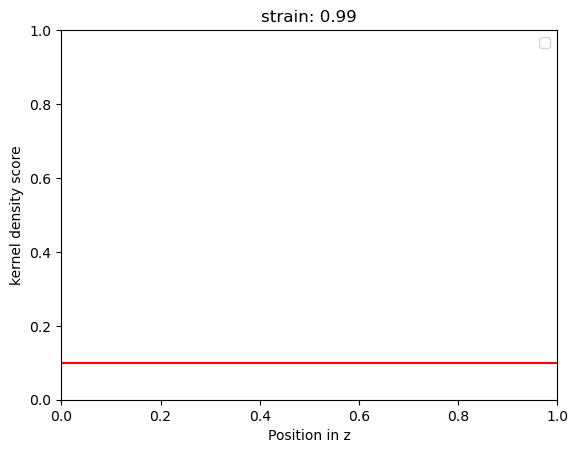

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


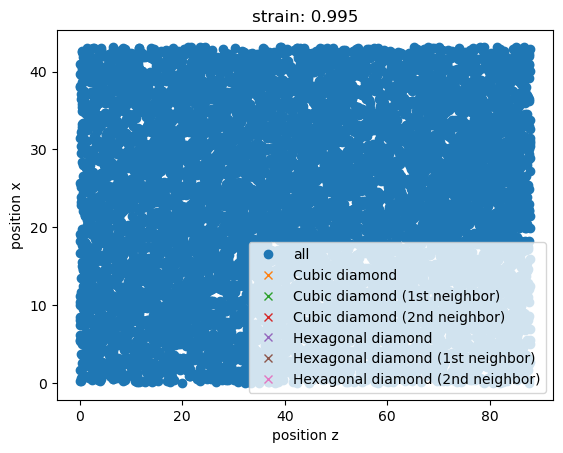

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


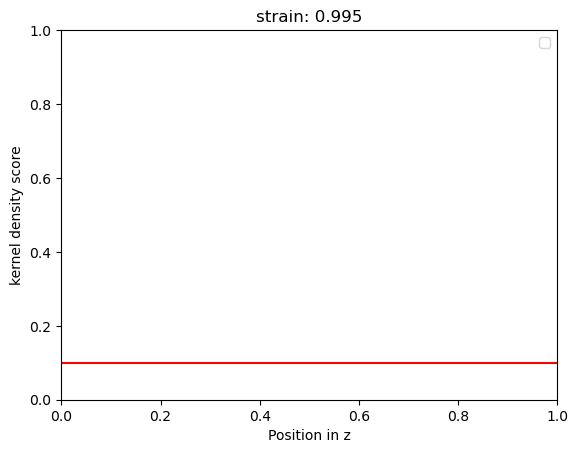

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


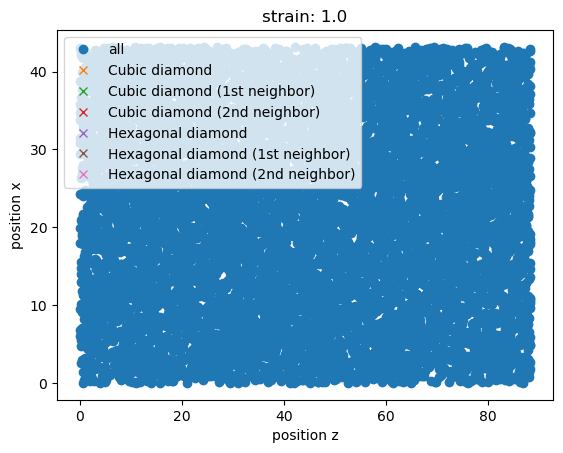

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


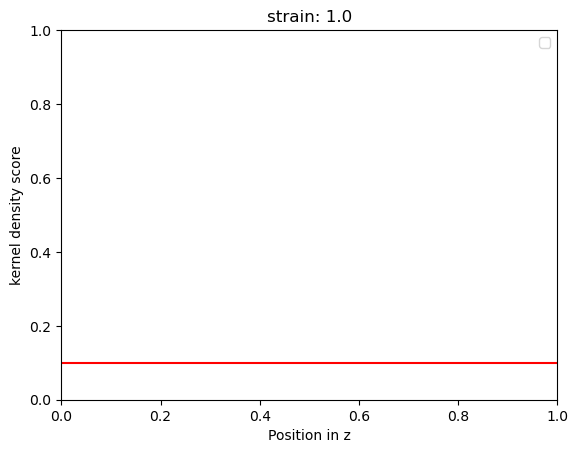

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


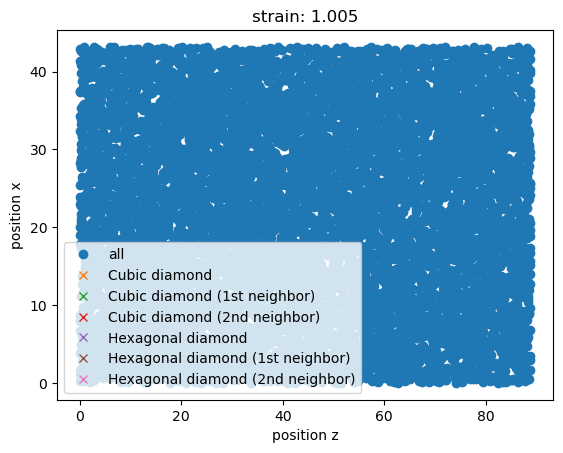

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


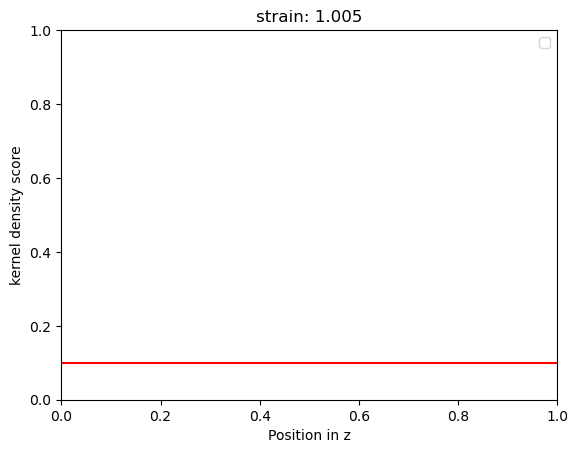

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


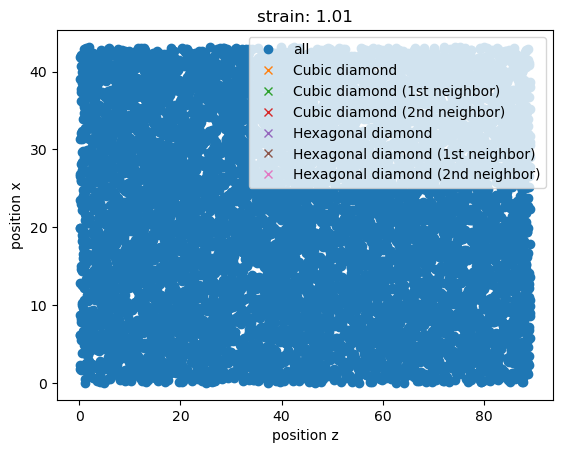

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


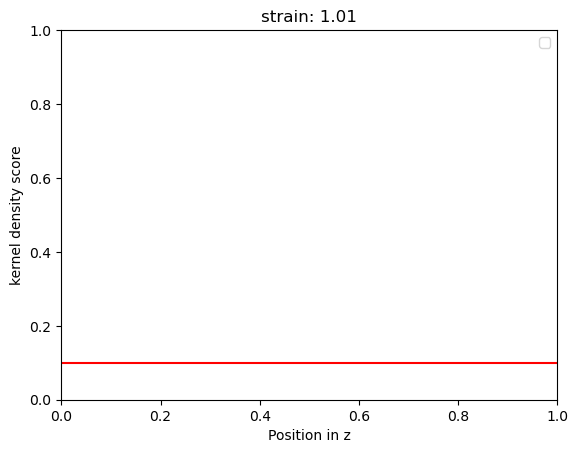

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


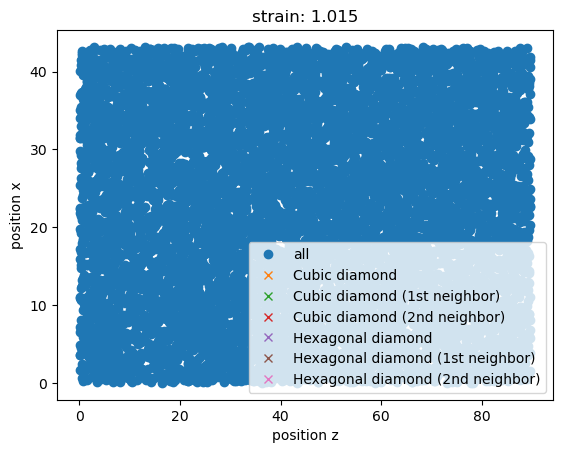

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


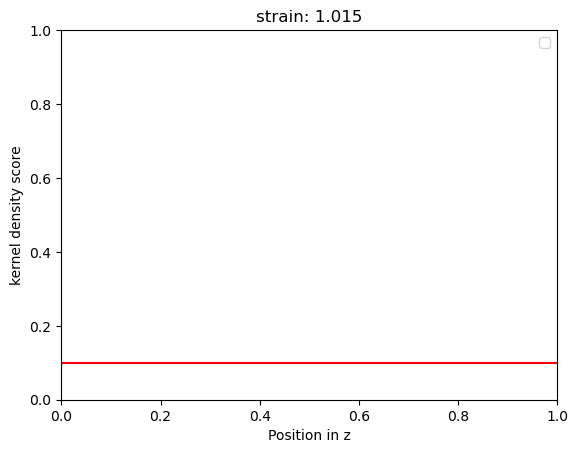

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


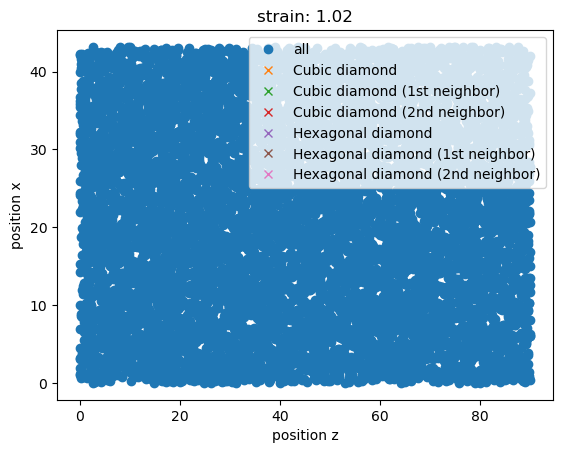

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


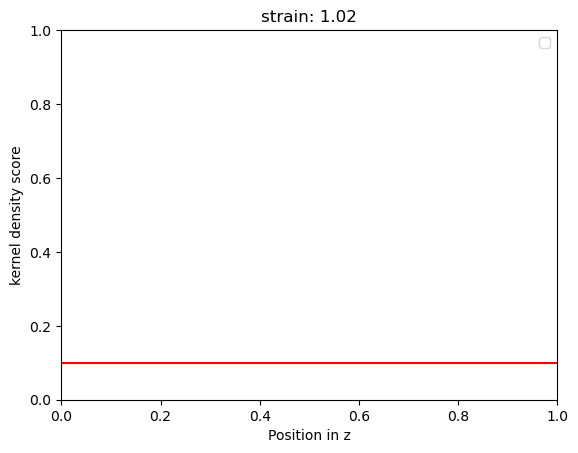

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


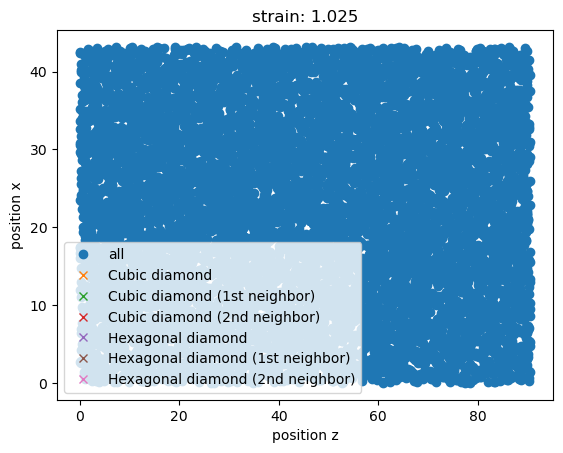

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


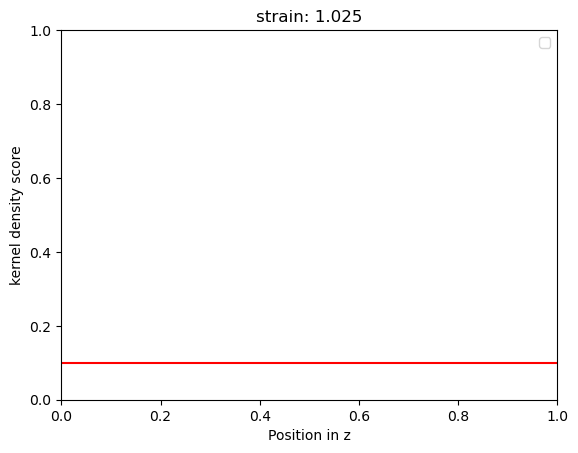

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


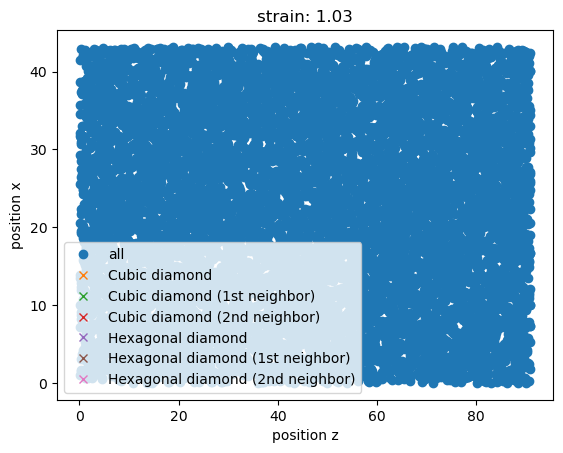

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


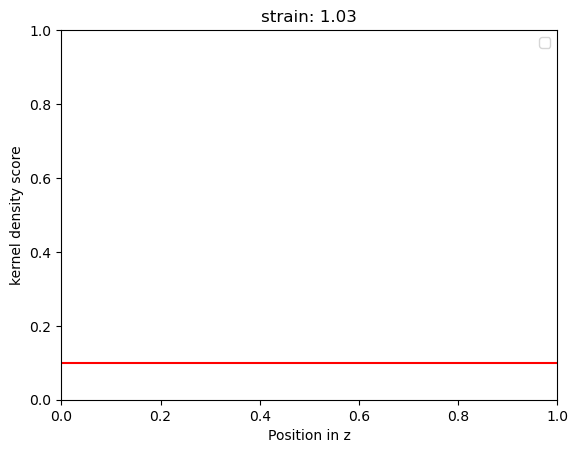

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


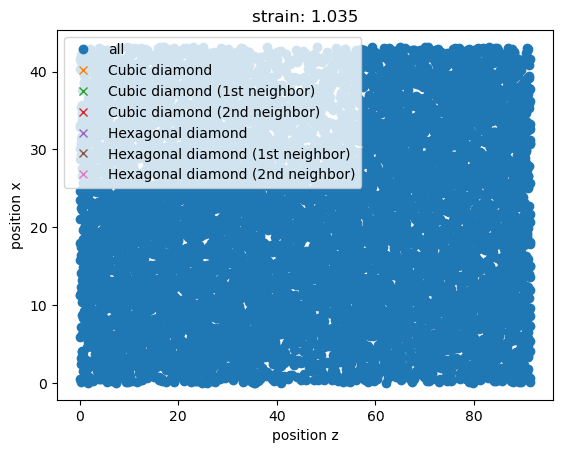

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


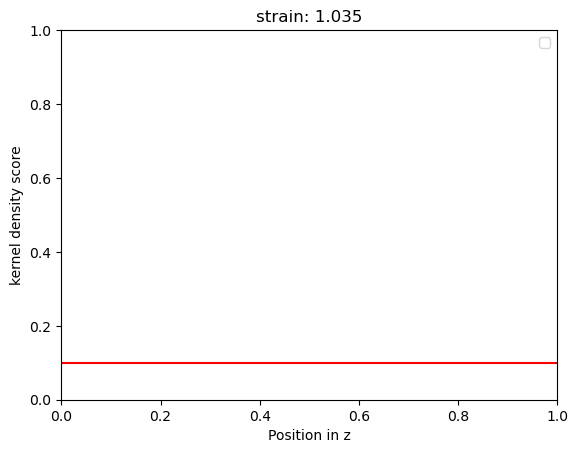

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


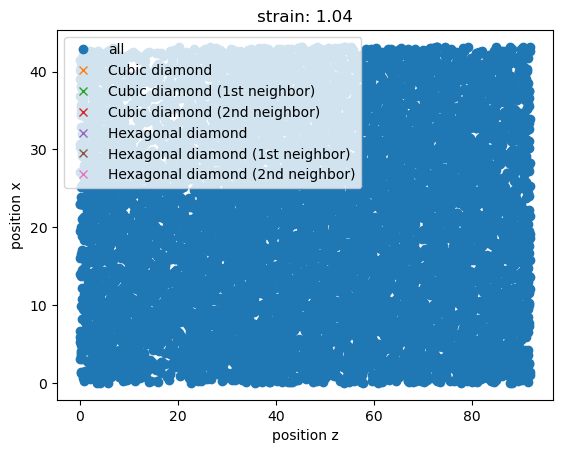

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


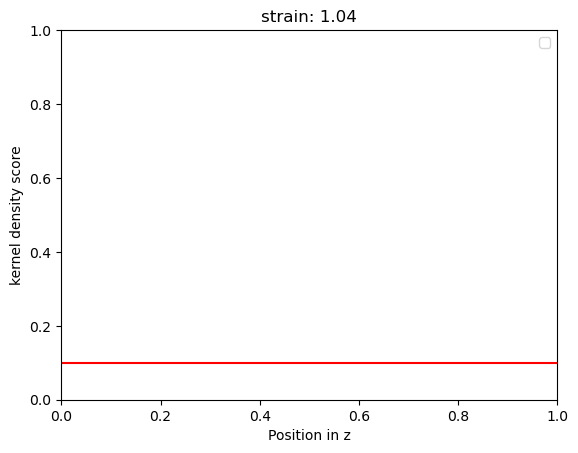

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


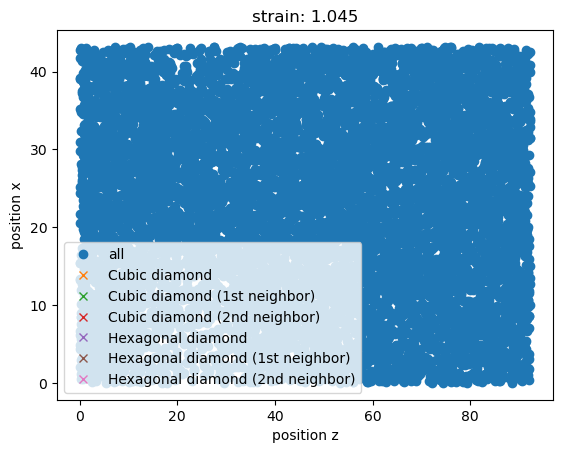

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


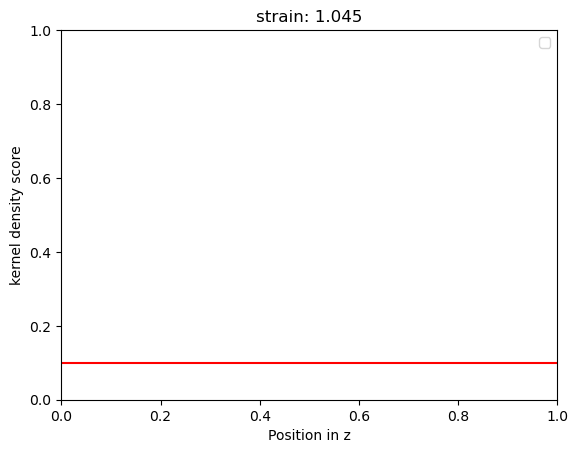

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


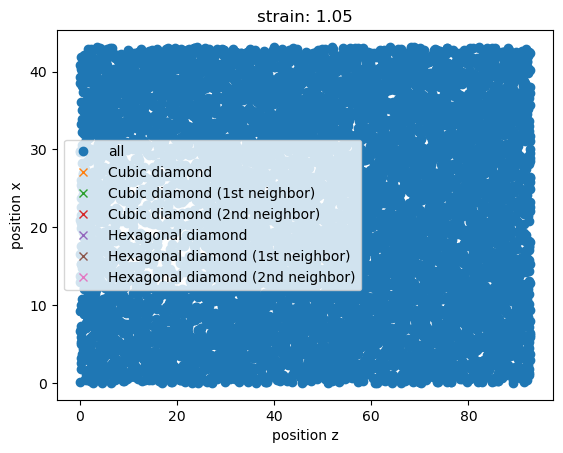

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


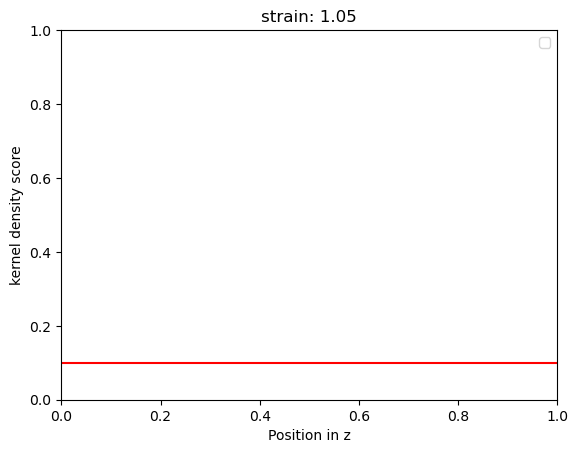

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


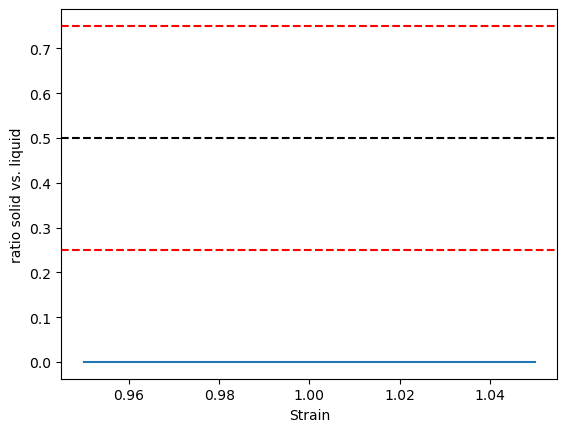

In [31]:
temperature_next, temperature_mean, temperature_left, temperature_right, strain_result_lst, pressure_result_lst = calc_temp_iteration(
        basis=ham_minimize_vol.get_structure().repeat([1,1,2]), 
        temperature_next=temperature_next, 
        project_parameter=project_parameter,
        timestep = timestep,
        nve_run_time_steps=nve_run_time_steps, 
        fit_range=fit_range,  
        center=None,
        debug_plot=True)

In [32]:
temperature_next, temperature_mean, temperature_left, temperature_right

(2692.8, 0.0, 0.0, 0.0)

# Step 3: run NVT and NVE MD

In [33]:
output = validate_convergence(
    pr=pr,
    temperature_left=temperature_left,
    temperature_next=temperature_next,
    temperature_right=temperature_right,
    enable_iteration=enable_iteration,
    timestep_iter=timestep_iter,
    timestep_lst=project_parameter['timestep_lst'],
    timestep=timestep,
    fit_range_iter=fit_range_iter,
    fit_range_lst=project_parameter['fit_range_lst'],
    fit_range=fit_range,
    nve_run_time_steps_iter=nve_run_time_steps_iter,
    nve_run_time_steps_lst=project_parameter['nve_run_time_steps_lst'],
    nve_run_time_steps=nve_run_time_steps,
    strain_result_lst=strain_result_lst,
    pressure_result_lst=pressure_result_lst,
    step_count=step_count,
    step_dict=step_dict,
    boundary_value=project_parameter['boundary_value'],
    ratio_boundary=project_parameter['ratio_boundary'],
    convergence_goal=project_parameter['convergence_criterion'],
    output_file=output_file
)
convergence_goal_achieved, enable_iteration, step_count, step_dict, timestep, fit_range, nve_run_time_steps, boundary_value, ratio_boundary, temperature_next, center = output

In [34]:
step_dict[step_count]

{'timestep': 2,
 'fit_range': 0.05,
 'nve_run_time_steps': 25000,
 'boundary_value': 0.25,
 'ratio_boundary': 0.25,
 'temperature_next': 2692.8,
 'center': 1.0}

In [35]:
convergence_goal_achieved

False

# Step 4: full cycle, predict the final melting point

The job ham_npt_solid_2692_8 was saved and received the ID: 824


The job ham_npt_liquid_high_3692_8 was saved and received the ID: 825


The job ham_npt_liquid_low_2692_8 was saved and received the ID: 826


2023-07-03 15:34:39,022 - pyiron_log - WARNING - Job 'ham_nve_0_95_2692_8_0' does not exist and cannot be loaded


The job ham_nvt_0_95_2692_8_0 was saved and received the ID: 827


2023-07-03 15:35:21,958 - pyiron_log - WARNING - Job 'ham_nve_0_955_2692_8_0' does not exist and cannot be loaded


The job ham_nvt_0_955_2692_8_0 was saved and received the ID: 828


2023-07-03 15:36:04,504 - pyiron_log - WARNING - Job 'ham_nve_0_96_2692_8_0' does not exist and cannot be loaded


The job ham_nvt_0_96_2692_8_0 was saved and received the ID: 829


2023-07-03 15:36:44,127 - pyiron_log - WARNING - Job 'ham_nve_0_965_2692_8_0' does not exist and cannot be loaded


The job ham_nvt_0_965_2692_8_0 was saved and received the ID: 830


2023-07-03 15:37:23,839 - pyiron_log - WARNING - Job 'ham_nve_0_97_2692_8_0' does not exist and cannot be loaded


The job ham_nvt_0_97_2692_8_0 was saved and received the ID: 831


2023-07-03 15:38:10,528 - pyiron_log - WARNING - Job 'ham_nve_0_975_2692_8_0' does not exist and cannot be loaded


The job ham_nvt_0_975_2692_8_0 was saved and received the ID: 832


2023-07-03 15:38:49,626 - pyiron_log - WARNING - Job 'ham_nve_0_98_2692_8_0' does not exist and cannot be loaded


The job ham_nvt_0_98_2692_8_0 was saved and received the ID: 833


2023-07-03 15:39:28,135 - pyiron_log - WARNING - Job 'ham_nve_0_985_2692_8_0' does not exist and cannot be loaded


The job ham_nvt_0_985_2692_8_0 was saved and received the ID: 834


2023-07-03 15:40:06,295 - pyiron_log - WARNING - Job 'ham_nve_0_99_2692_8_0' does not exist and cannot be loaded


The job ham_nvt_0_99_2692_8_0 was saved and received the ID: 835


2023-07-03 15:40:43,938 - pyiron_log - WARNING - Job 'ham_nve_0_995_2692_8_0' does not exist and cannot be loaded


The job ham_nvt_0_995_2692_8_0 was saved and received the ID: 836


2023-07-03 15:41:21,567 - pyiron_log - WARNING - Job 'ham_nve_1_0_2692_8_0' does not exist and cannot be loaded


The job ham_nvt_1_0_2692_8_0 was saved and received the ID: 837


2023-07-03 15:41:58,386 - pyiron_log - WARNING - Job 'ham_nve_1_005_2692_8_0' does not exist and cannot be loaded


The job ham_nvt_1_005_2692_8_0 was saved and received the ID: 838


2023-07-03 15:42:35,013 - pyiron_log - WARNING - Job 'ham_nve_1_01_2692_8_0' does not exist and cannot be loaded


The job ham_nvt_1_01_2692_8_0 was saved and received the ID: 839


2023-07-03 15:43:13,403 - pyiron_log - WARNING - Job 'ham_nve_1_015_2692_8_0' does not exist and cannot be loaded


The job ham_nvt_1_015_2692_8_0 was saved and received the ID: 840


2023-07-03 15:43:49,163 - pyiron_log - WARNING - Job 'ham_nve_1_02_2692_8_0' does not exist and cannot be loaded


The job ham_nvt_1_02_2692_8_0 was saved and received the ID: 841


2023-07-03 15:44:24,644 - pyiron_log - WARNING - Job 'ham_nve_1_025_2692_8_0' does not exist and cannot be loaded


The job ham_nvt_1_025_2692_8_0 was saved and received the ID: 842


2023-07-03 15:44:59,686 - pyiron_log - WARNING - Job 'ham_nve_1_03_2692_8_0' does not exist and cannot be loaded


The job ham_nvt_1_03_2692_8_0 was saved and received the ID: 843


2023-07-03 15:45:34,502 - pyiron_log - WARNING - Job 'ham_nve_1_035_2692_8_0' does not exist and cannot be loaded


The job ham_nvt_1_035_2692_8_0 was saved and received the ID: 844


2023-07-03 15:46:08,921 - pyiron_log - WARNING - Job 'ham_nve_1_04_2692_8_0' does not exist and cannot be loaded


The job ham_nvt_1_04_2692_8_0 was saved and received the ID: 845


2023-07-03 15:46:43,247 - pyiron_log - WARNING - Job 'ham_nve_1_045_2692_8_0' does not exist and cannot be loaded


The job ham_nvt_1_045_2692_8_0 was saved and received the ID: 846


2023-07-03 15:47:19,535 - pyiron_log - WARNING - Job 'ham_nve_1_05_2692_8_0' does not exist and cannot be loaded


The job ham_nvt_1_05_2692_8_0 was saved and received the ID: 847


The job ham_nve_0_95_2692_8_0 was saved and received the ID: 848


The job ham_nve_0_955_2692_8_0 was saved and received the ID: 849


The job ham_nve_0_96_2692_8_0 was saved and received the ID: 850


The job ham_nve_0_965_2692_8_0 was saved and received the ID: 851


The job ham_nve_0_97_2692_8_0 was saved and received the ID: 852


The job ham_nve_0_975_2692_8_0 was saved and received the ID: 853


The job ham_nve_0_98_2692_8_0 was saved and received the ID: 854


The job ham_nve_0_985_2692_8_0 was saved and received the ID: 855


The job ham_nve_0_99_2692_8_0 was saved and received the ID: 856


The job ham_nve_0_995_2692_8_0 was saved and received the ID: 857


The job ham_nve_1_0_2692_8_0 was saved and received the ID: 858


The job ham_nve_1_005_2692_8_0 was saved and received the ID: 859


The job ham_nve_1_01_2692_8_0 was saved and received the ID: 860


The job ham_nve_1_015_2692_8_0 was saved and received the ID: 861


The job ham_nve_1_02_2692_8_0 was saved and received the ID: 862


The job ham_nve_1_025_2692_8_0 was saved and received the ID: 863


The job ham_nve_1_03_2692_8_0 was saved and received the ID: 864


The job ham_nve_1_035_2692_8_0 was saved and received the ID: 865


The job ham_nve_1_04_2692_8_0 was saved and received the ID: 866


The job ham_nve_1_045_2692_8_0 was saved and received the ID: 867


The job ham_nve_1_05_2692_8_0 was saved and received the ID: 868


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


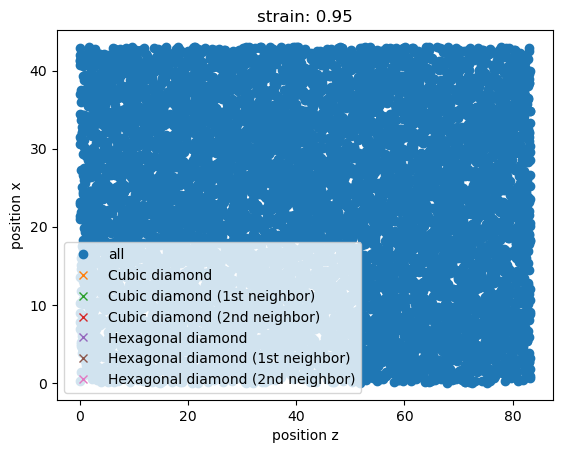

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


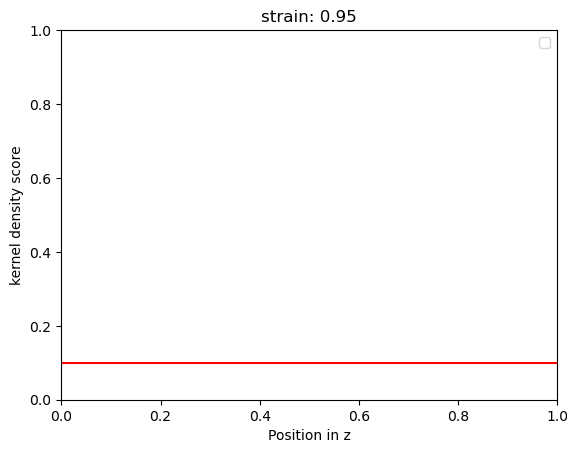

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


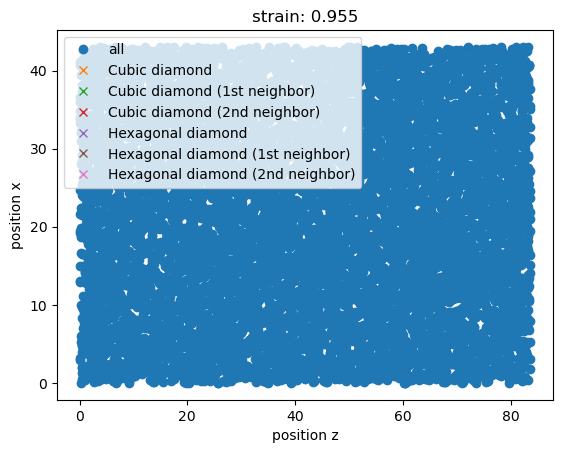

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


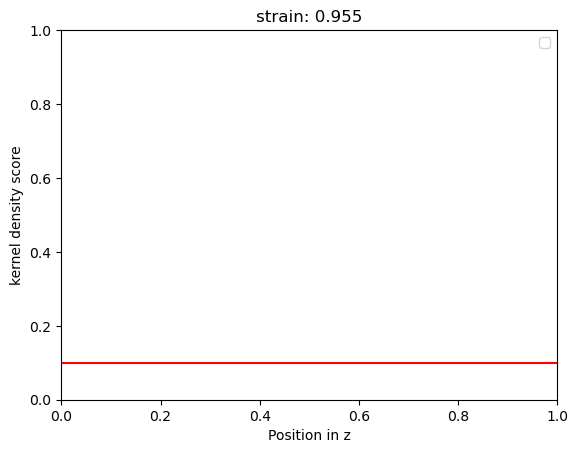

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


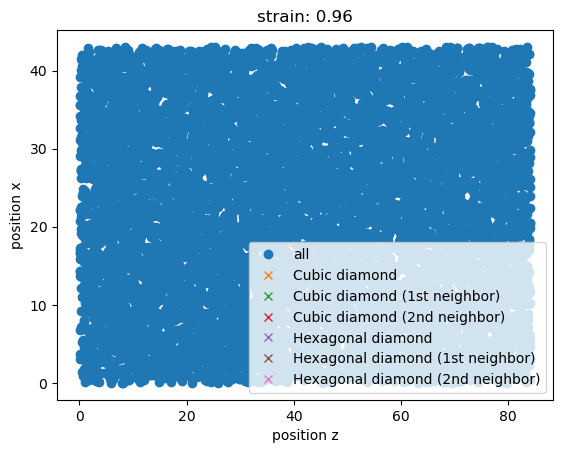

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


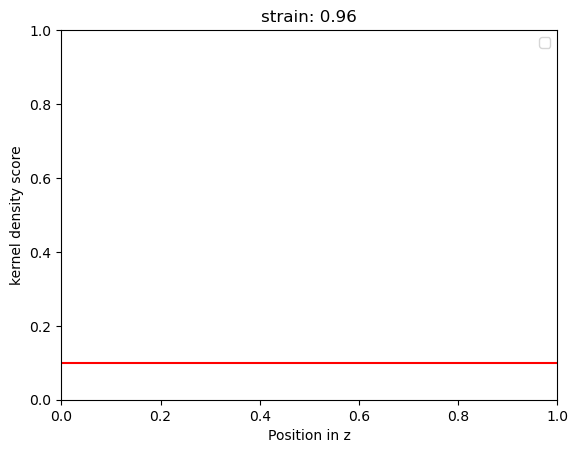

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


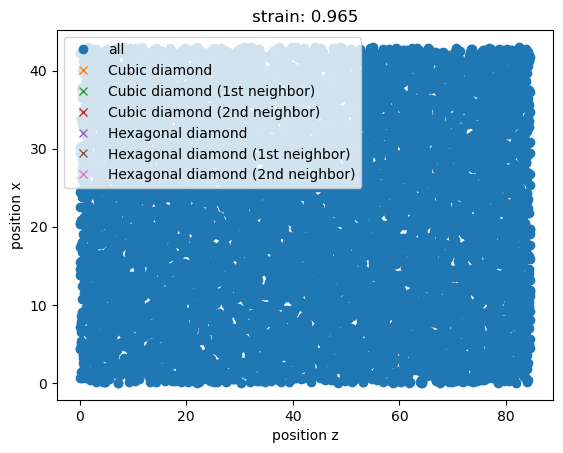

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


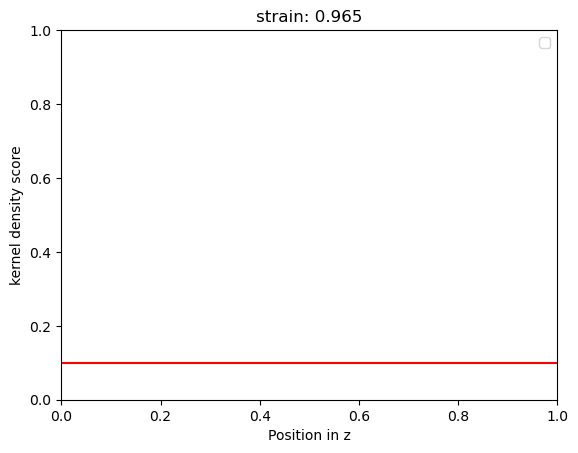

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


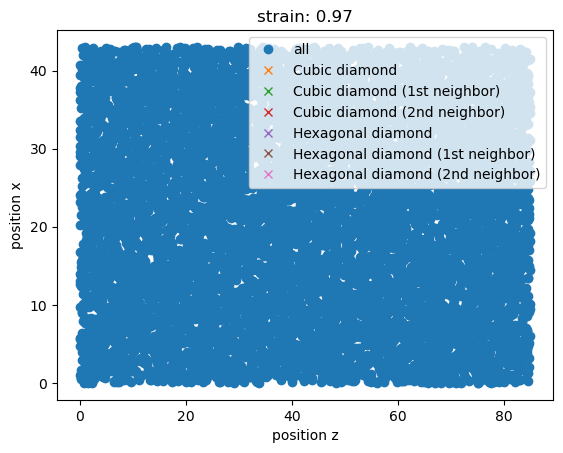

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


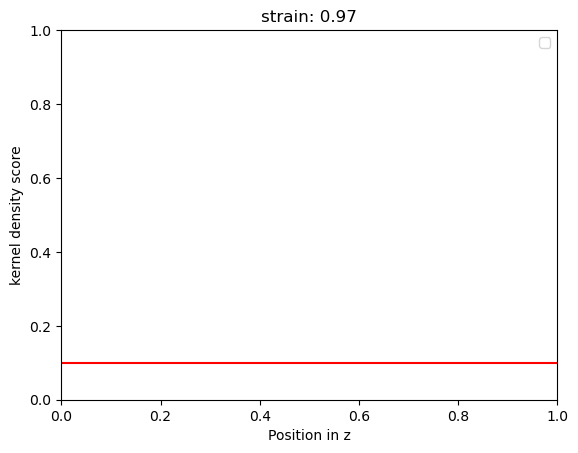

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


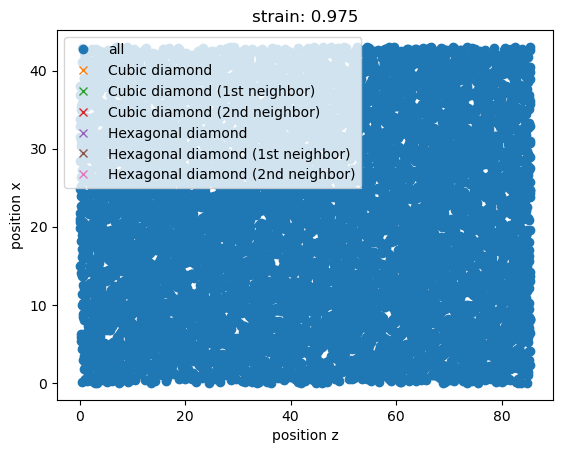

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


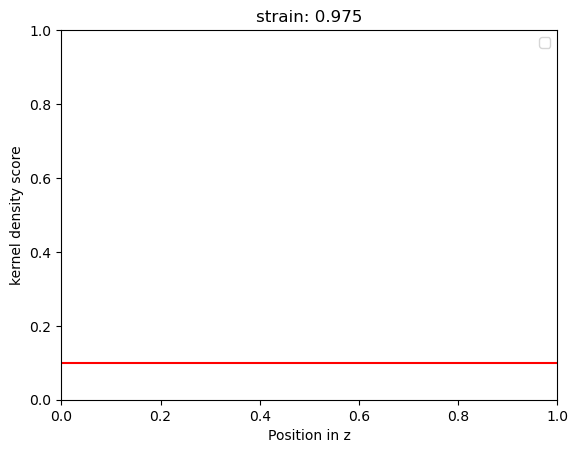

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


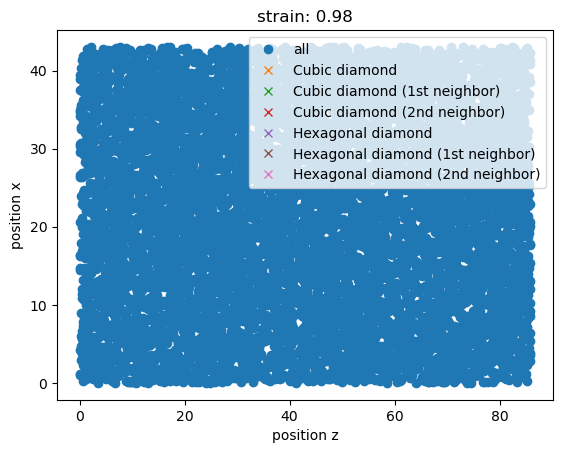

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


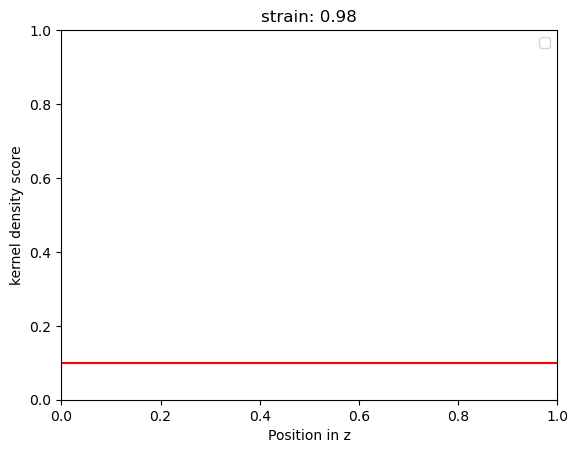

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


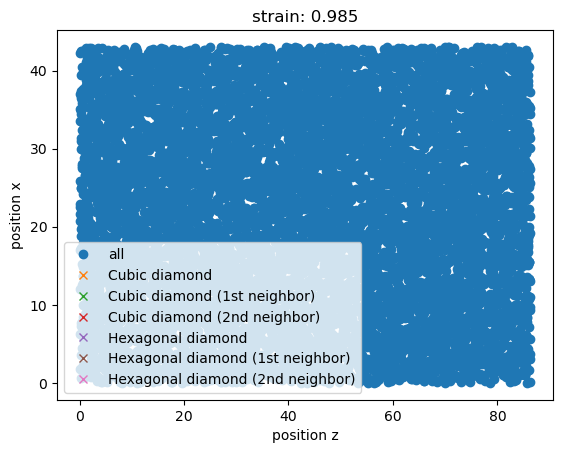

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


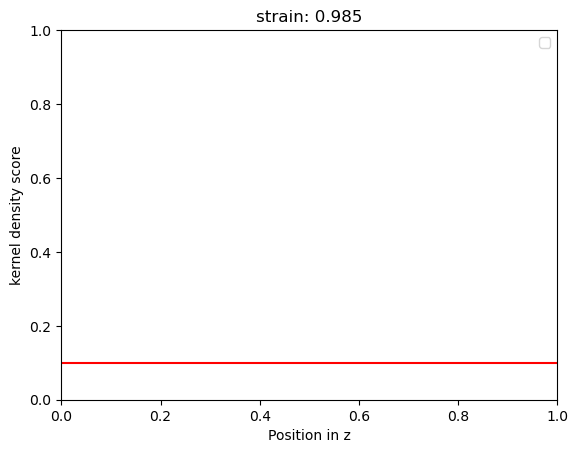

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


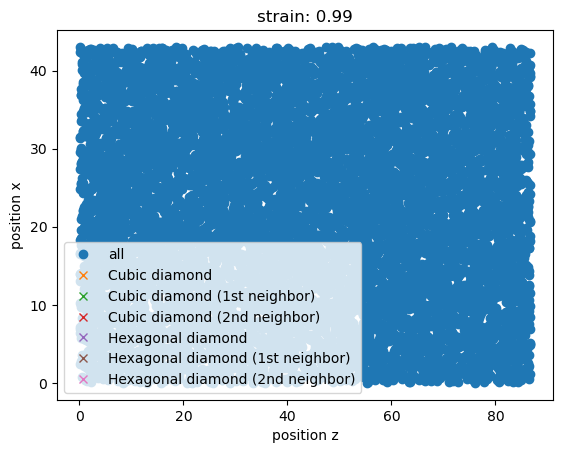

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


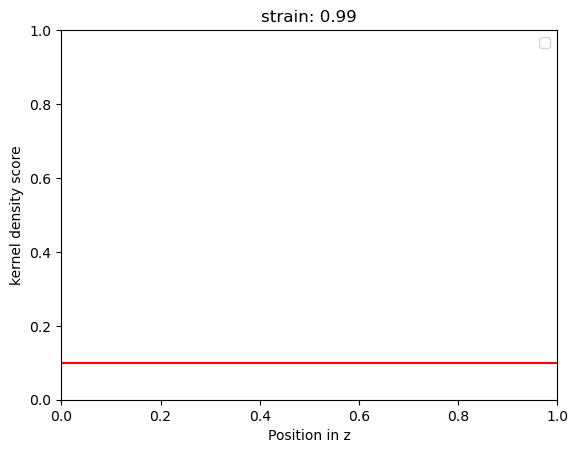

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


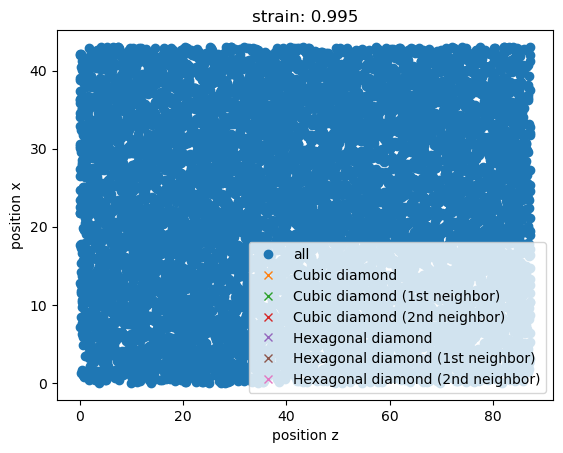

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


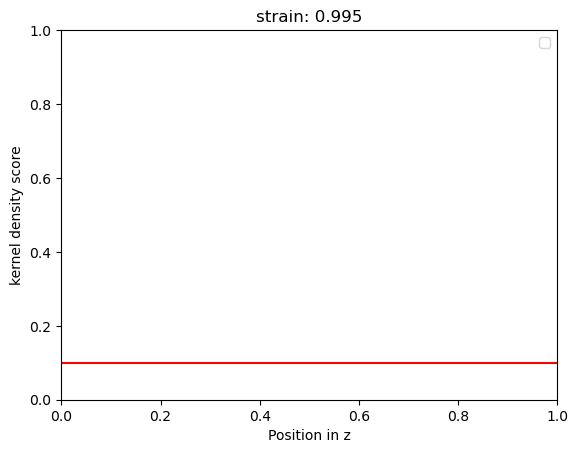

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


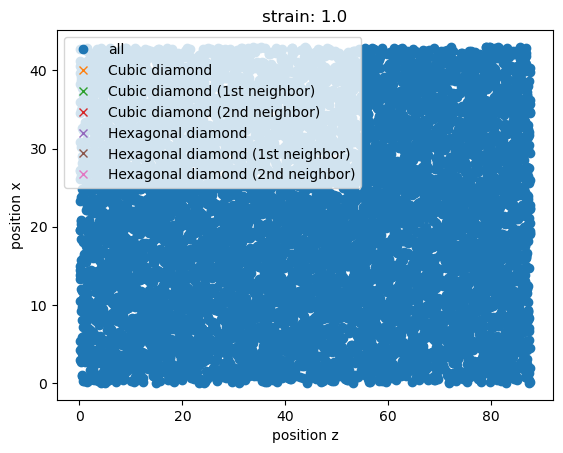

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


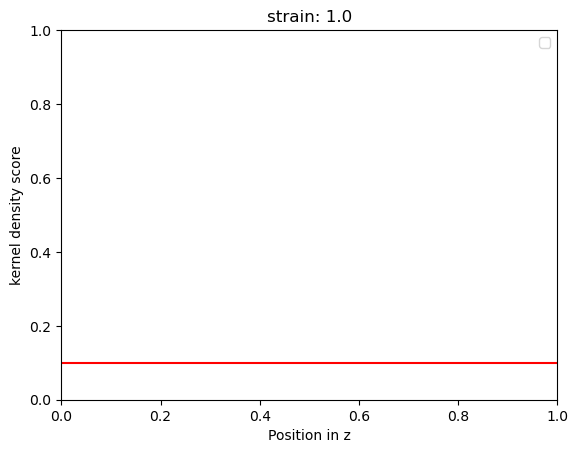

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


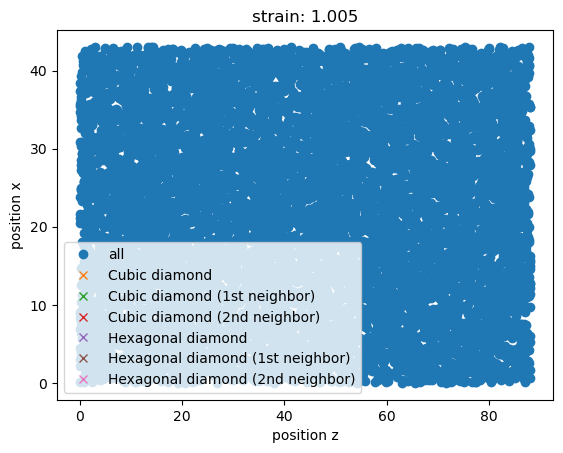

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


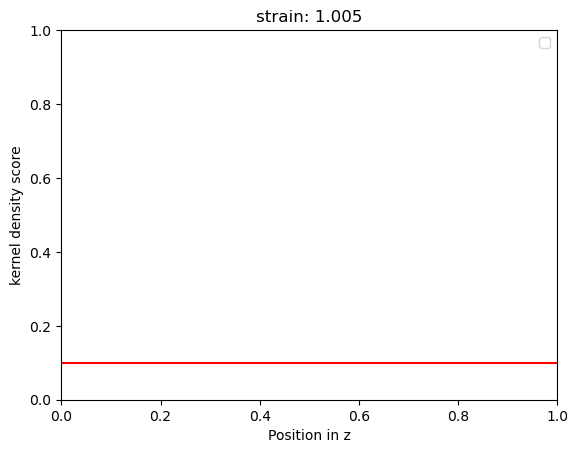

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


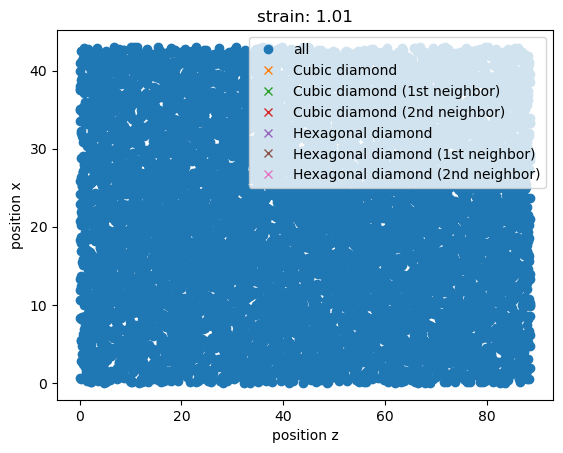

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


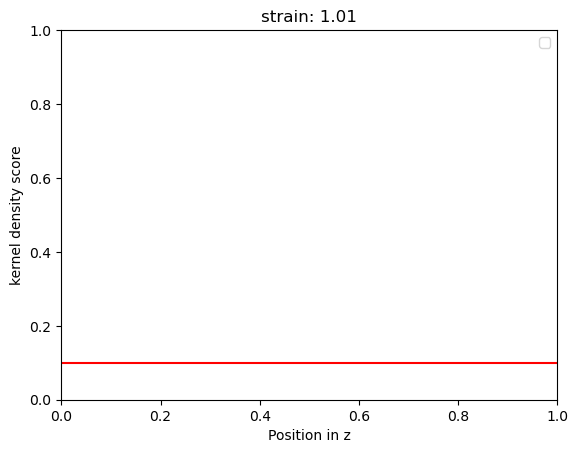

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


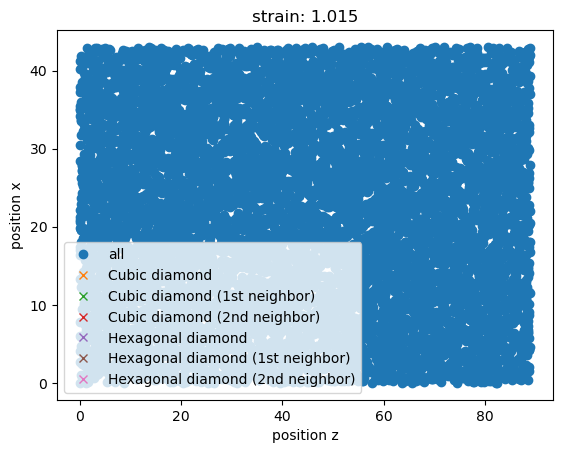

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


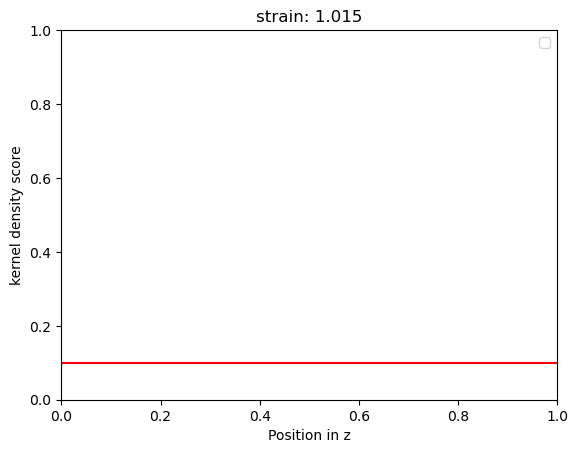

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


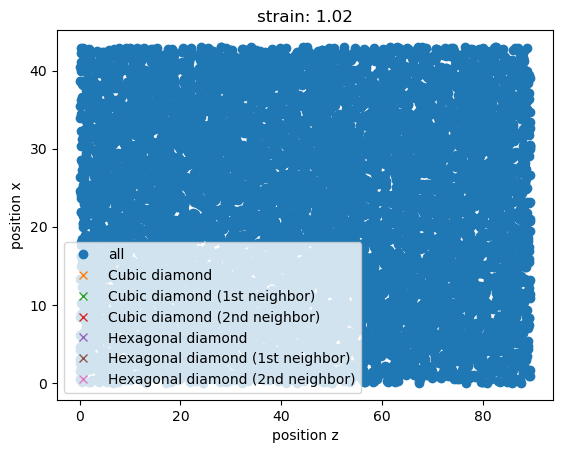

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


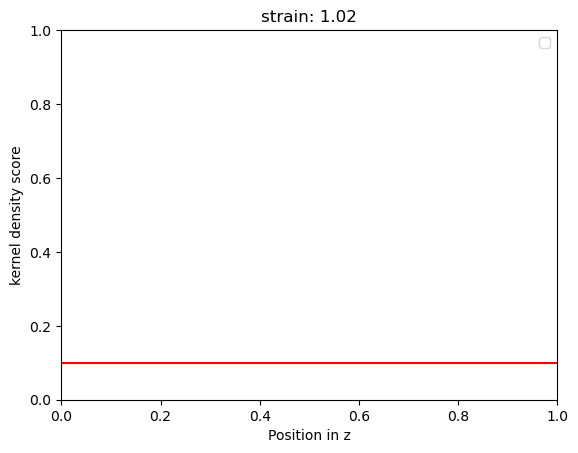

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


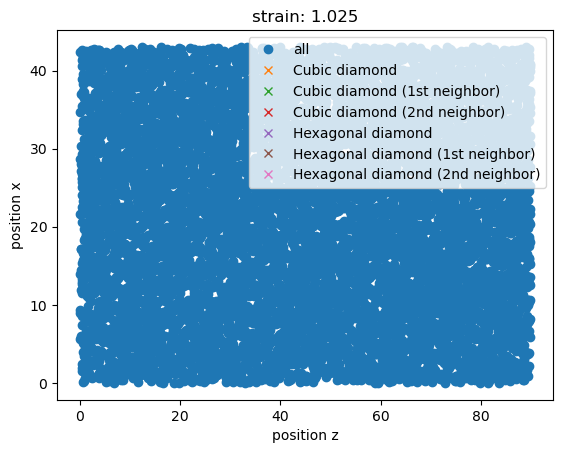

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


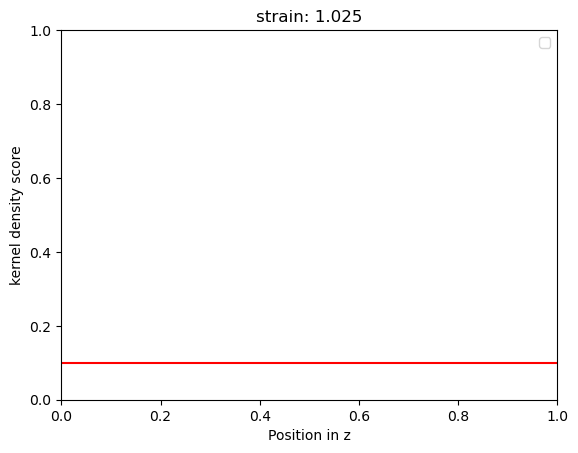

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


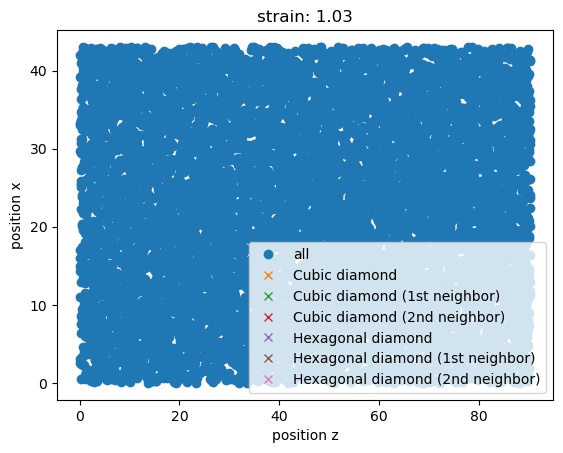

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


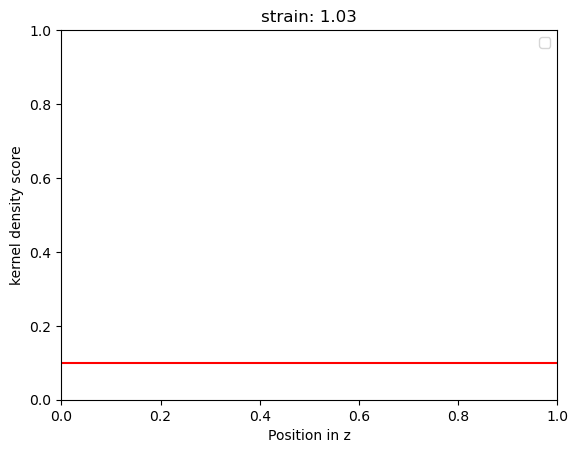

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


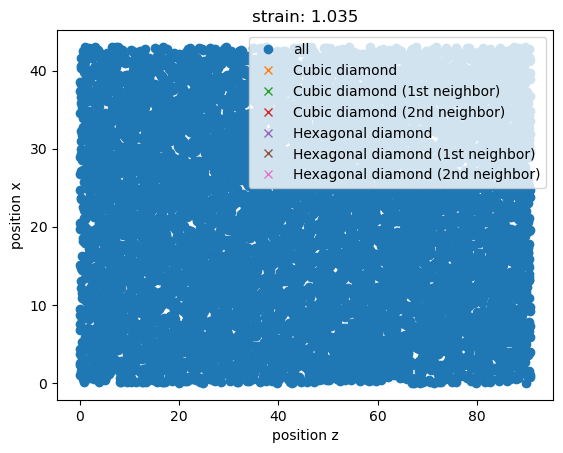

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


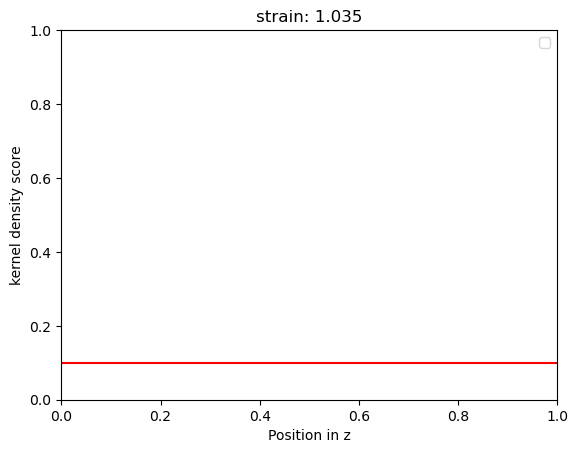

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


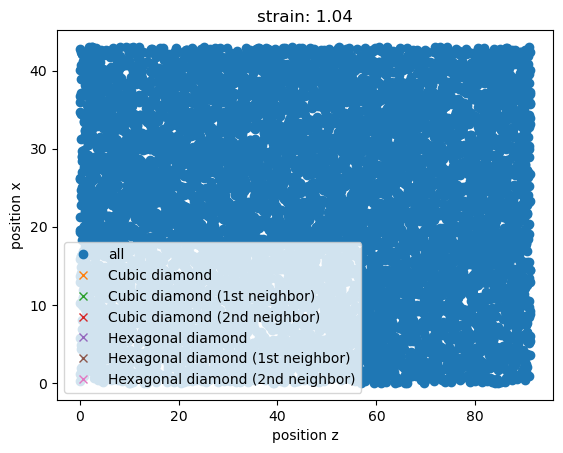

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


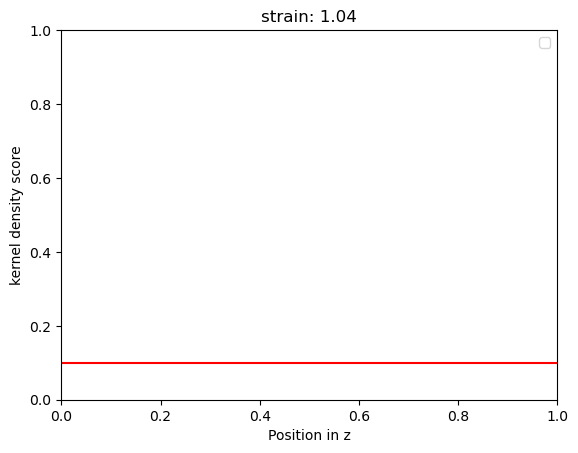

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


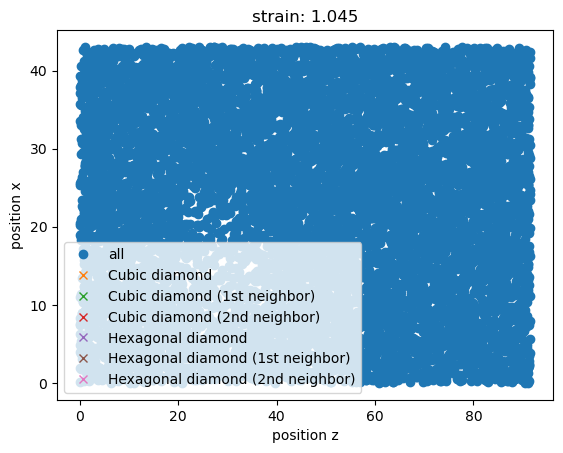

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


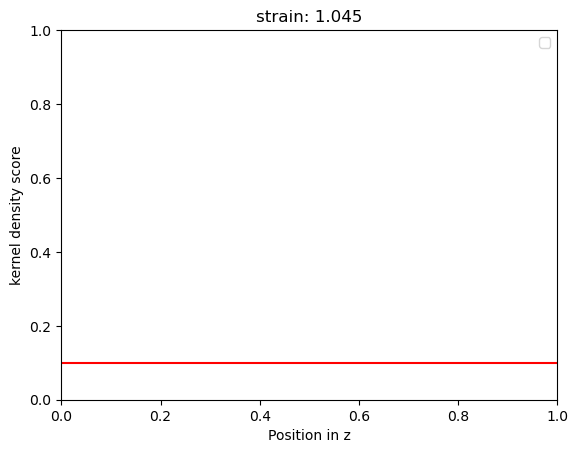

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


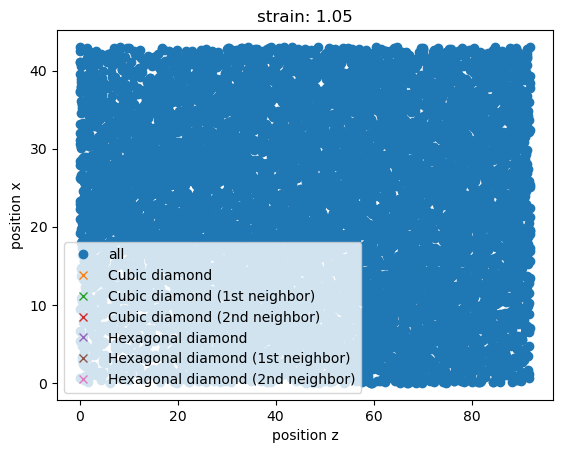

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


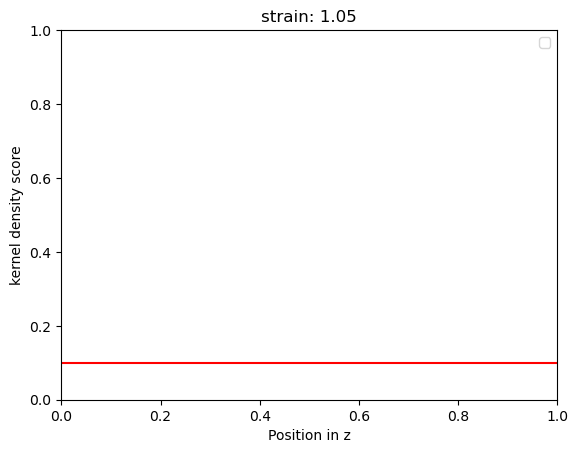

2423.5200000000004 0.0 0.0 0.0
{'timestep': 2, 'fit_range': 0.05, 'nve_run_time_steps': 25000, 'boundary_value': 0.25, 'ratio_boundary': 0.25, 'temperature_next': 2423.5200000000004, 'center': 1.0}


The job ham_npt_solid_2423_52 was saved and received the ID: 869


The job ham_npt_liquid_high_3423_52 was saved and received the ID: 870


The job ham_npt_liquid_low_2423_52 was saved and received the ID: 871


2023-07-03 16:31:00,243 - pyiron_log - WARNING - Job 'ham_nve_0_95_2423_52_0' does not exist and cannot be loaded


The job ham_nvt_0_95_2423_52_0 was saved and received the ID: 872


2023-07-03 16:31:42,521 - pyiron_log - WARNING - Job 'ham_nve_0_955_2423_52_0' does not exist and cannot be loaded


The job ham_nvt_0_955_2423_52_0 was saved and received the ID: 873


2023-07-03 16:32:24,365 - pyiron_log - WARNING - Job 'ham_nve_0_96_2423_52_0' does not exist and cannot be loaded


The job ham_nvt_0_96_2423_52_0 was saved and received the ID: 874


2023-07-03 16:33:05,643 - pyiron_log - WARNING - Job 'ham_nve_0_965_2423_52_0' does not exist and cannot be loaded


The job ham_nvt_0_965_2423_52_0 was saved and received the ID: 875


2023-07-03 16:33:46,538 - pyiron_log - WARNING - Job 'ham_nve_0_97_2423_52_0' does not exist and cannot be loaded


The job ham_nvt_0_97_2423_52_0 was saved and received the ID: 876


2023-07-03 16:34:26,556 - pyiron_log - WARNING - Job 'ham_nve_0_975_2423_52_0' does not exist and cannot be loaded


The job ham_nvt_0_975_2423_52_0 was saved and received the ID: 877


2023-07-03 16:35:08,702 - pyiron_log - WARNING - Job 'ham_nve_0_98_2423_52_0' does not exist and cannot be loaded


The job ham_nvt_0_98_2423_52_0 was saved and received the ID: 878


2023-07-03 16:35:47,825 - pyiron_log - WARNING - Job 'ham_nve_0_985_2423_52_0' does not exist and cannot be loaded


The job ham_nvt_0_985_2423_52_0 was saved and received the ID: 879


2023-07-03 16:36:26,605 - pyiron_log - WARNING - Job 'ham_nve_0_99_2423_52_0' does not exist and cannot be loaded


The job ham_nvt_0_99_2423_52_0 was saved and received the ID: 880


2023-07-03 16:37:04,794 - pyiron_log - WARNING - Job 'ham_nve_0_995_2423_52_0' does not exist and cannot be loaded


The job ham_nvt_0_995_2423_52_0 was saved and received the ID: 881


2023-07-03 16:37:45,919 - pyiron_log - WARNING - Job 'ham_nve_1_0_2423_52_0' does not exist and cannot be loaded


The job ham_nvt_1_0_2423_52_0 was saved and received the ID: 882


2023-07-03 16:38:30,438 - pyiron_log - WARNING - Job 'ham_nve_1_005_2423_52_0' does not exist and cannot be loaded


The job ham_nvt_1_005_2423_52_0 was saved and received the ID: 883


2023-07-03 16:39:07,436 - pyiron_log - WARNING - Job 'ham_nve_1_01_2423_52_0' does not exist and cannot be loaded


The job ham_nvt_1_01_2423_52_0 was saved and received the ID: 884


2023-07-03 16:39:43,897 - pyiron_log - WARNING - Job 'ham_nve_1_015_2423_52_0' does not exist and cannot be loaded


The job ham_nvt_1_015_2423_52_0 was saved and received the ID: 885


2023-07-03 16:40:19,632 - pyiron_log - WARNING - Job 'ham_nve_1_02_2423_52_0' does not exist and cannot be loaded


The job ham_nvt_1_02_2423_52_0 was saved and received the ID: 886


2023-07-03 16:40:55,417 - pyiron_log - WARNING - Job 'ham_nve_1_025_2423_52_0' does not exist and cannot be loaded


The job ham_nvt_1_025_2423_52_0 was saved and received the ID: 887


2023-07-03 16:41:30,737 - pyiron_log - WARNING - Job 'ham_nve_1_03_2423_52_0' does not exist and cannot be loaded


The job ham_nvt_1_03_2423_52_0 was saved and received the ID: 888


2023-07-03 16:42:05,714 - pyiron_log - WARNING - Job 'ham_nve_1_035_2423_52_0' does not exist and cannot be loaded


The job ham_nvt_1_035_2423_52_0 was saved and received the ID: 889


2023-07-03 16:42:40,277 - pyiron_log - WARNING - Job 'ham_nve_1_04_2423_52_0' does not exist and cannot be loaded


The job ham_nvt_1_04_2423_52_0 was saved and received the ID: 890


2023-07-03 16:43:15,070 - pyiron_log - WARNING - Job 'ham_nve_1_045_2423_52_0' does not exist and cannot be loaded


The job ham_nvt_1_045_2423_52_0 was saved and received the ID: 891


2023-07-03 16:43:54,345 - pyiron_log - WARNING - Job 'ham_nve_1_05_2423_52_0' does not exist and cannot be loaded


The job ham_nvt_1_05_2423_52_0 was saved and received the ID: 892


The job ham_nve_0_95_2423_52_0 was saved and received the ID: 893


The job ham_nve_0_955_2423_52_0 was saved and received the ID: 894


The job ham_nve_0_96_2423_52_0 was saved and received the ID: 895


The job ham_nve_0_965_2423_52_0 was saved and received the ID: 896


The job ham_nve_0_97_2423_52_0 was saved and received the ID: 897


The job ham_nve_0_975_2423_52_0 was saved and received the ID: 898


The job ham_nve_0_98_2423_52_0 was saved and received the ID: 899


The job ham_nve_0_985_2423_52_0 was saved and received the ID: 900


The job ham_nve_0_99_2423_52_0 was saved and received the ID: 901


The job ham_nve_0_995_2423_52_0 was saved and received the ID: 902


The job ham_nve_1_0_2423_52_0 was saved and received the ID: 903


The job ham_nve_1_005_2423_52_0 was saved and received the ID: 904


The job ham_nve_1_01_2423_52_0 was saved and received the ID: 905


The job ham_nve_1_015_2423_52_0 was saved and received the ID: 906


The job ham_nve_1_02_2423_52_0 was saved and received the ID: 907


The job ham_nve_1_025_2423_52_0 was saved and received the ID: 908


The job ham_nve_1_03_2423_52_0 was saved and received the ID: 909


The job ham_nve_1_035_2423_52_0 was saved and received the ID: 910


The job ham_nve_1_04_2423_52_0 was saved and received the ID: 911


The job ham_nve_1_045_2423_52_0 was saved and received the ID: 912


The job ham_nve_1_05_2423_52_0 was saved and received the ID: 913


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


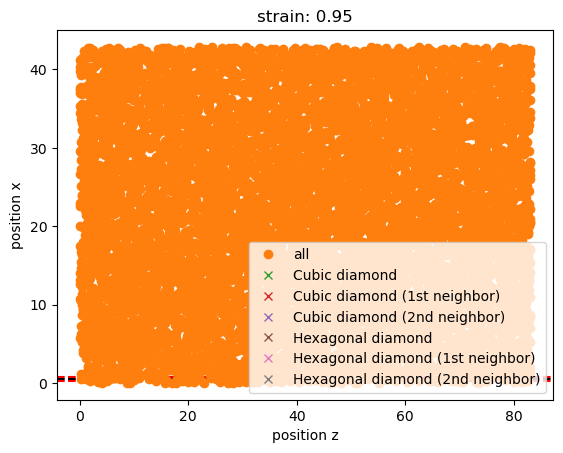

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


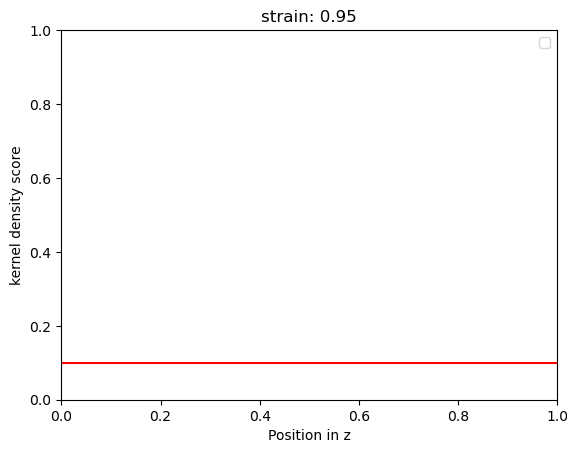

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


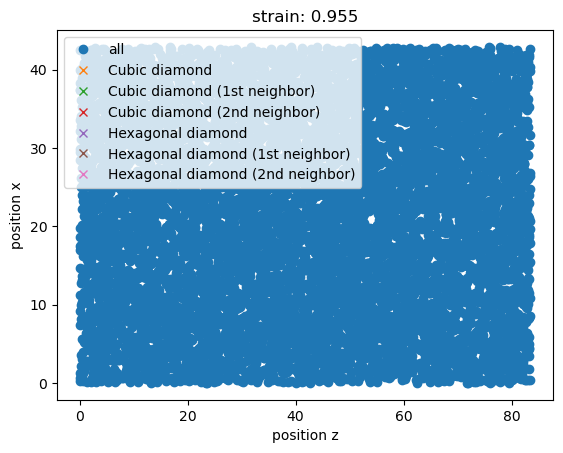

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


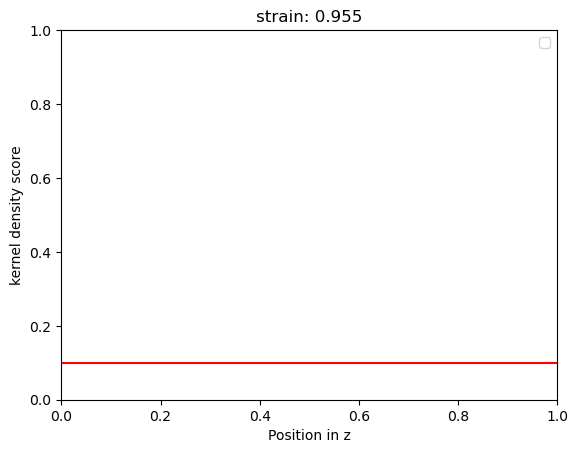

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


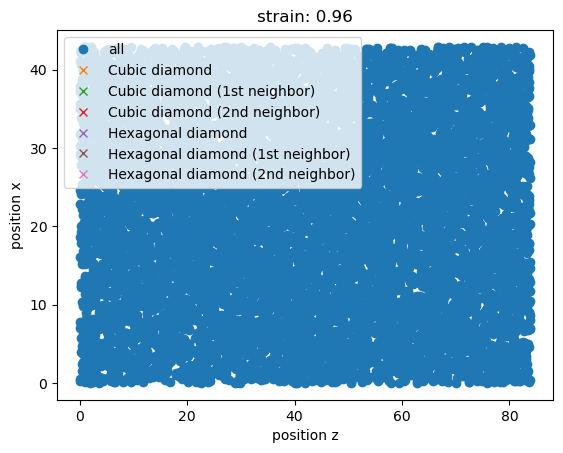

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


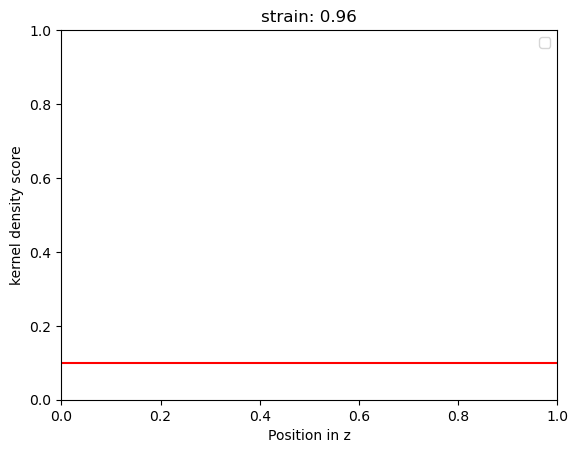

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


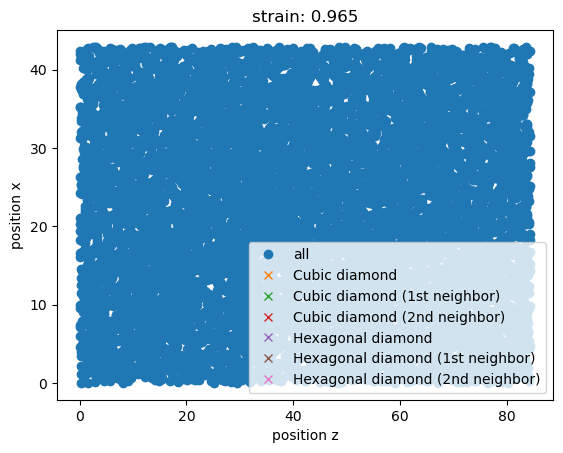

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


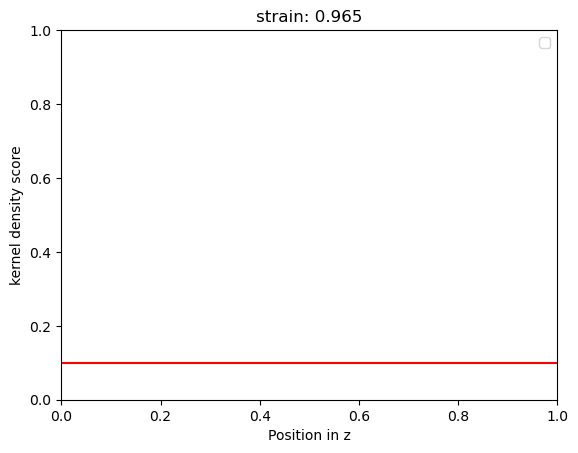

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


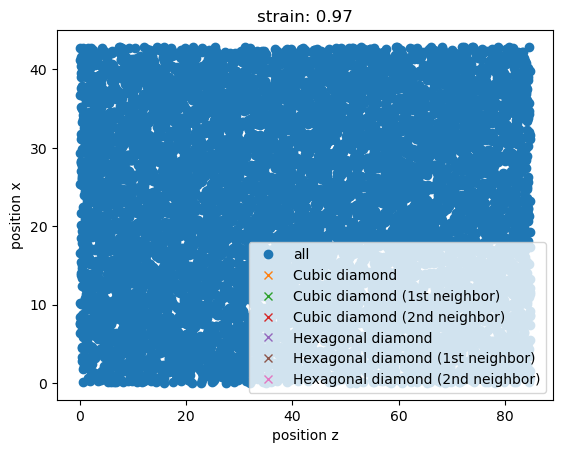

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


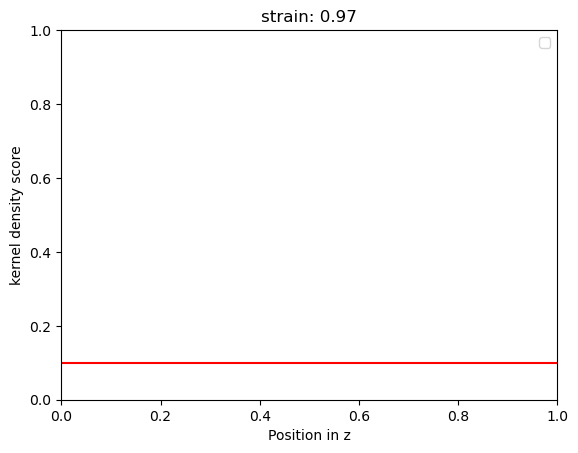

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


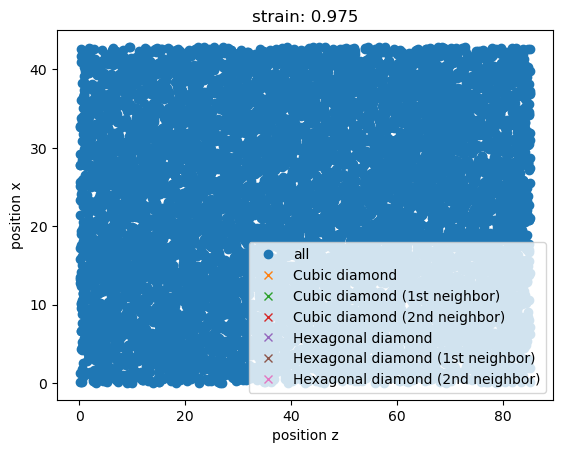

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


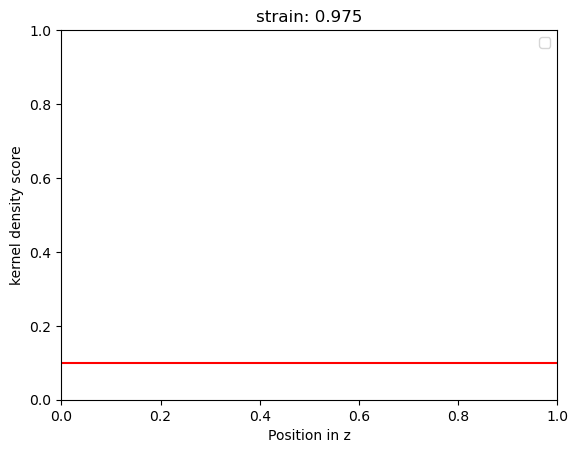

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


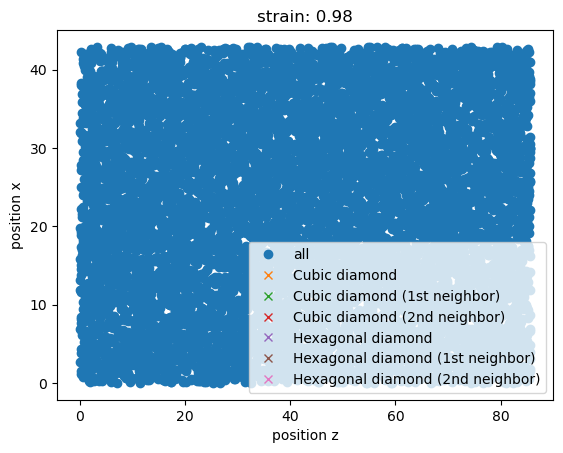

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


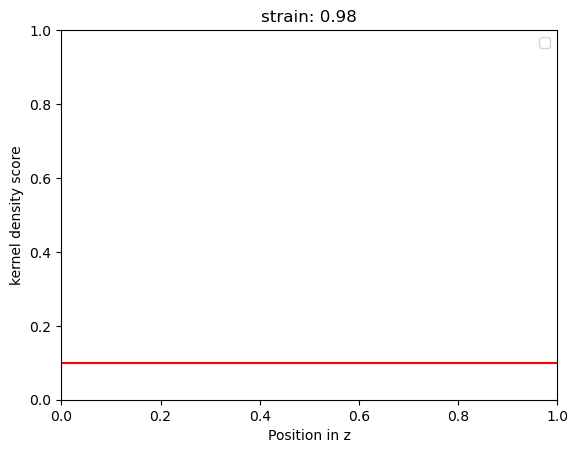

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


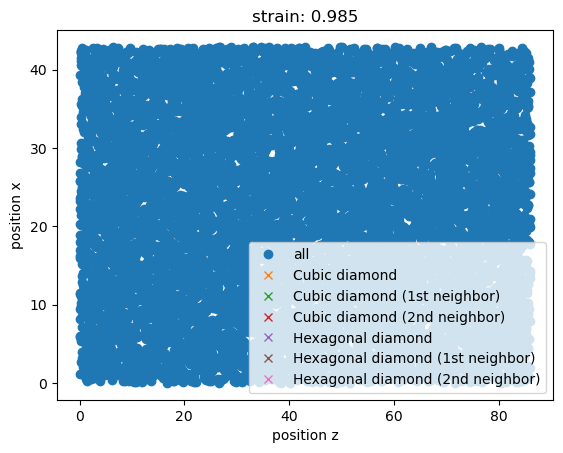

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


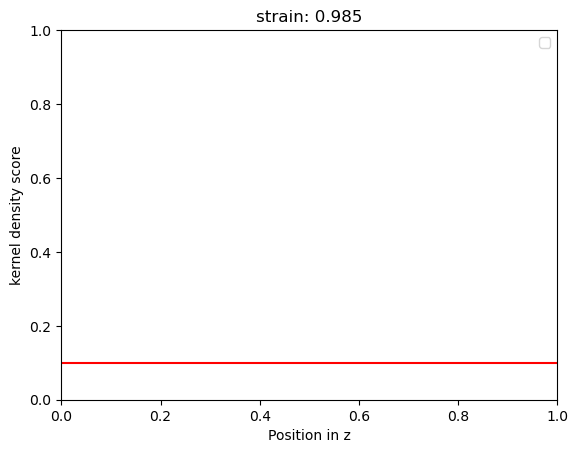

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


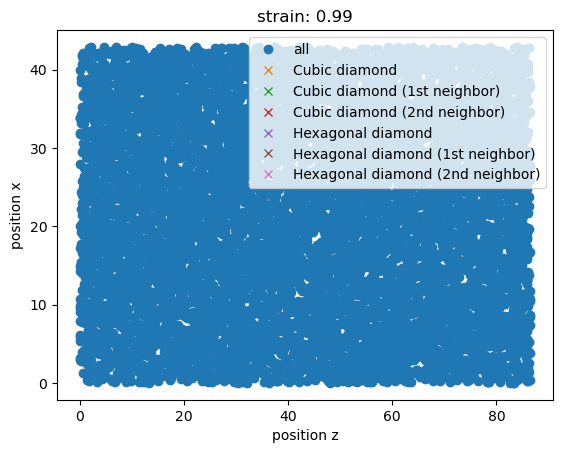

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


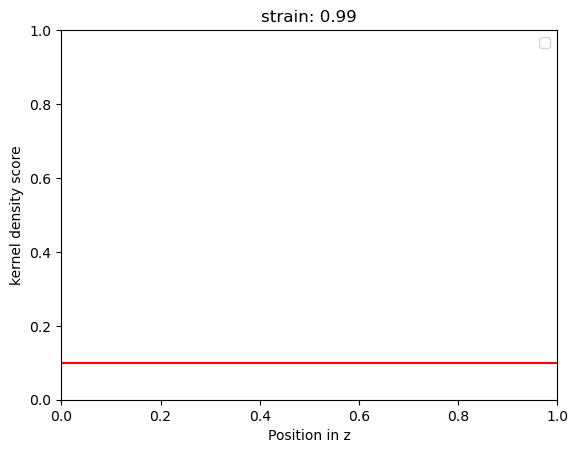

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


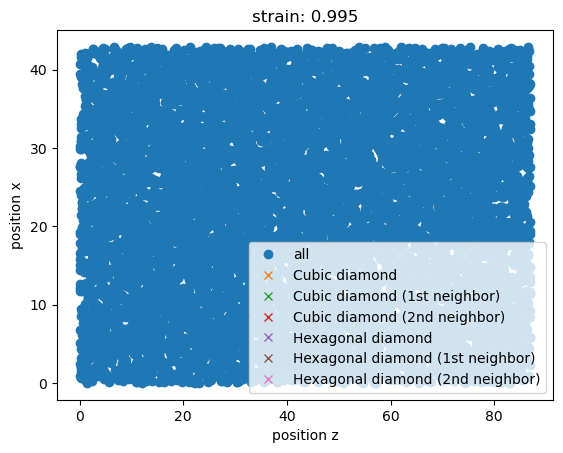

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


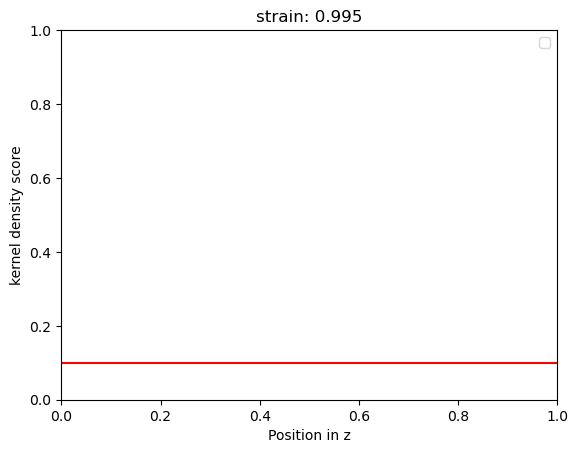

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


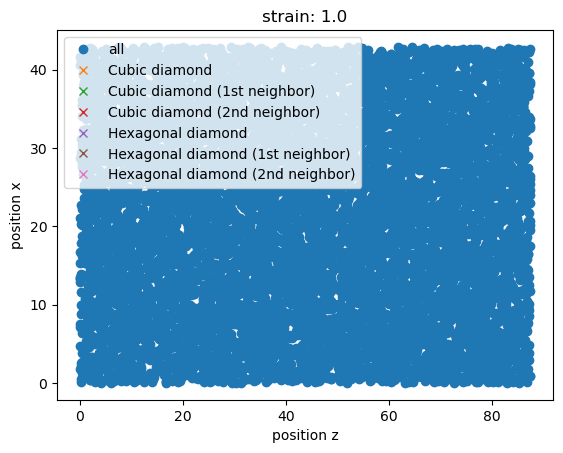

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


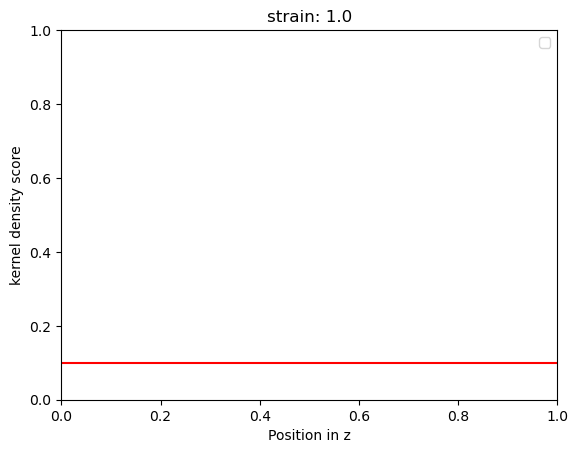

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


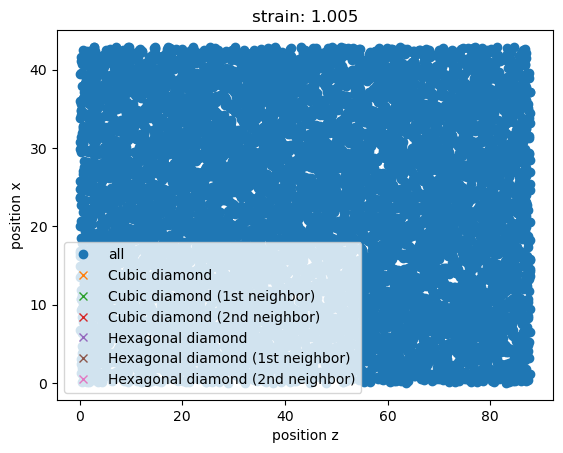

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


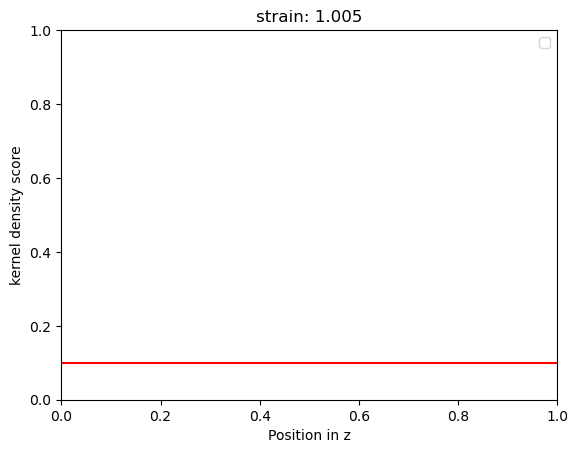

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


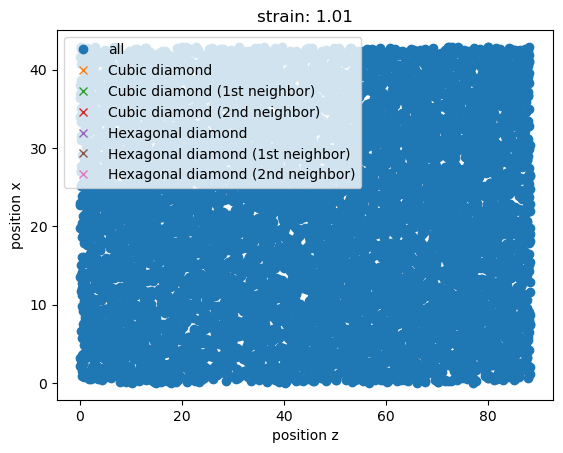

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


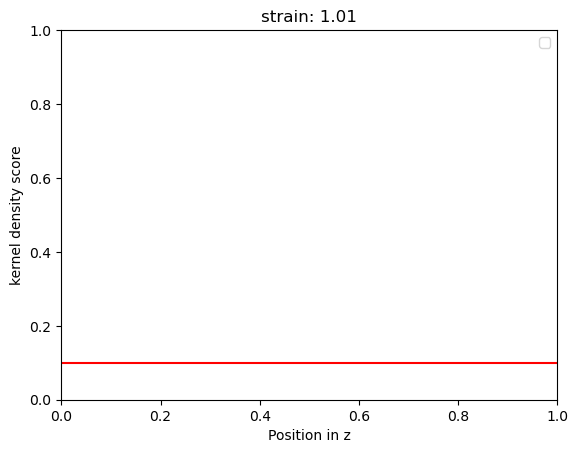

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


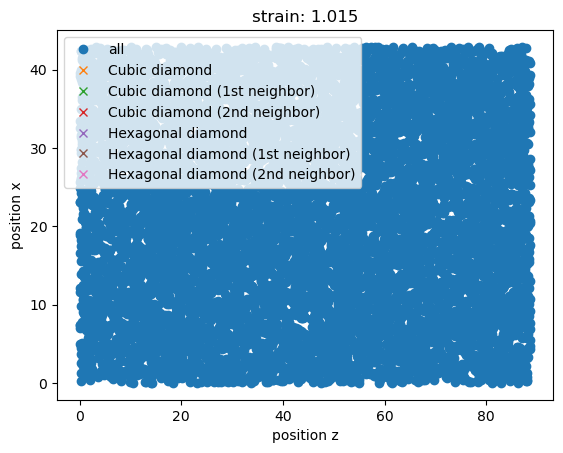

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


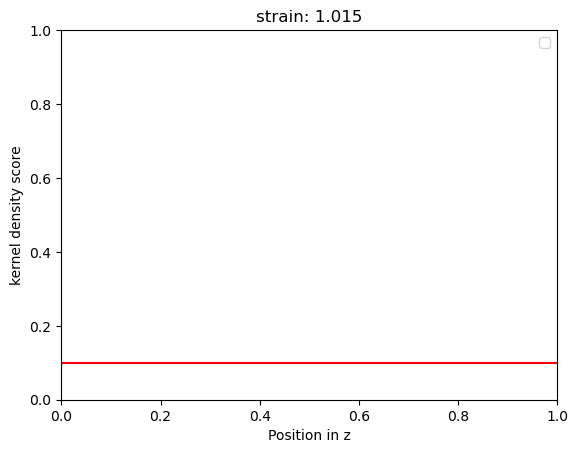

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


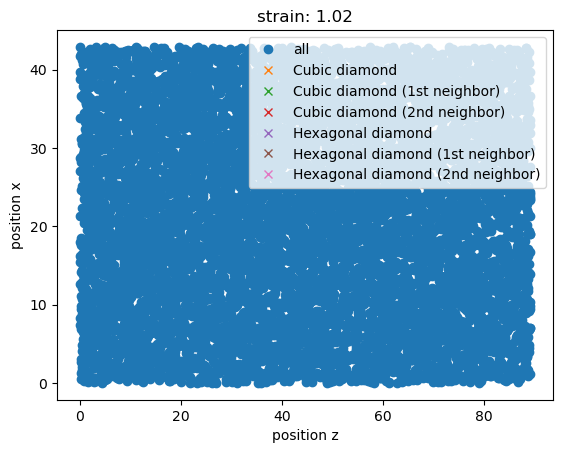

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


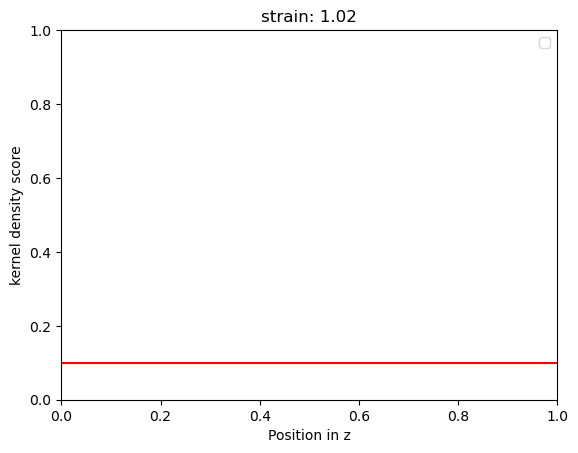

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


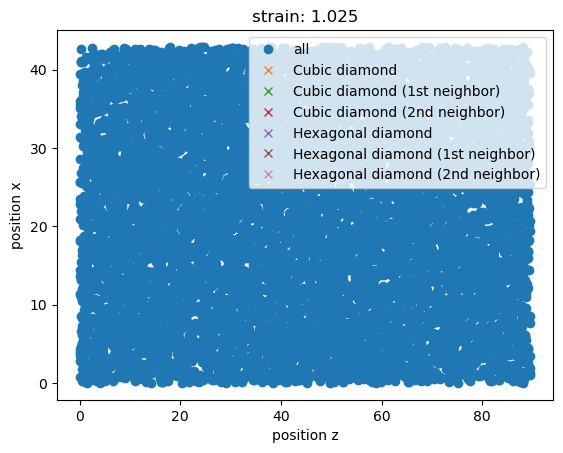

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


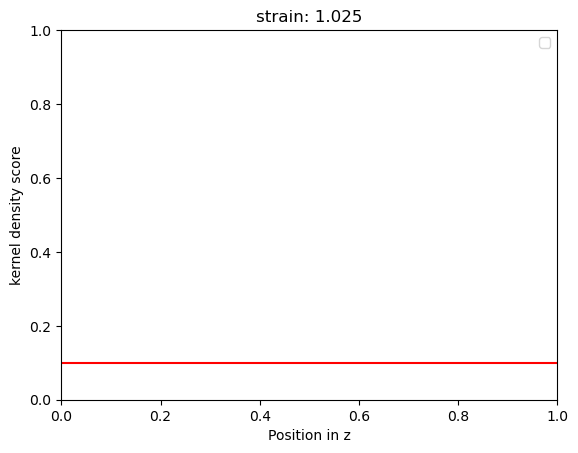

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


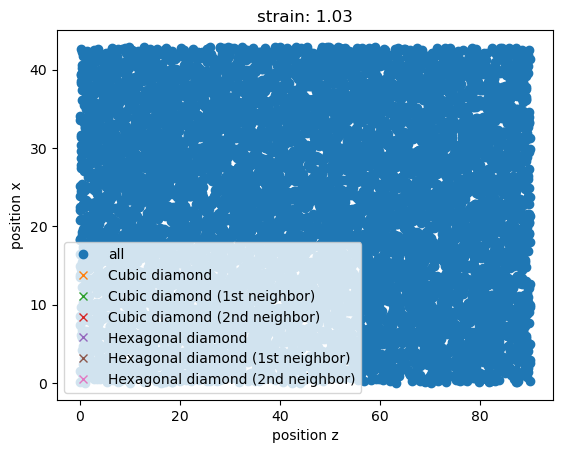

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


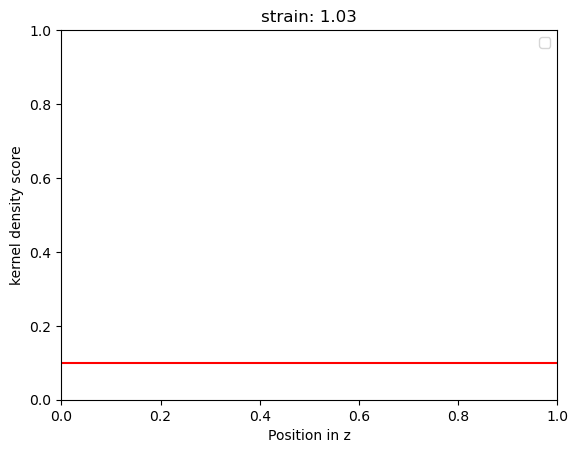

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


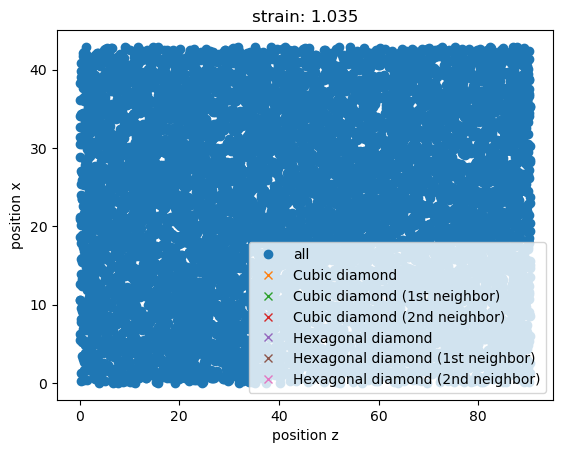

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


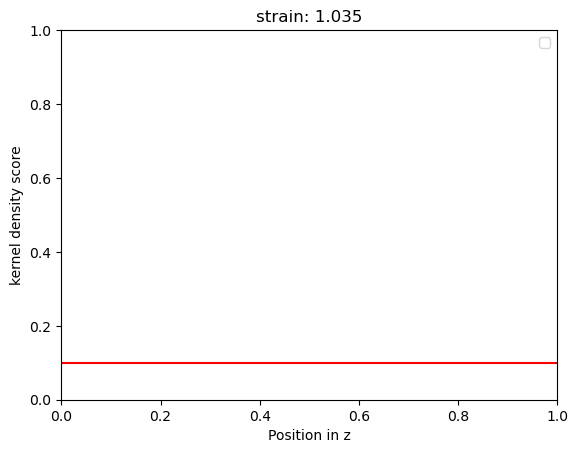

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


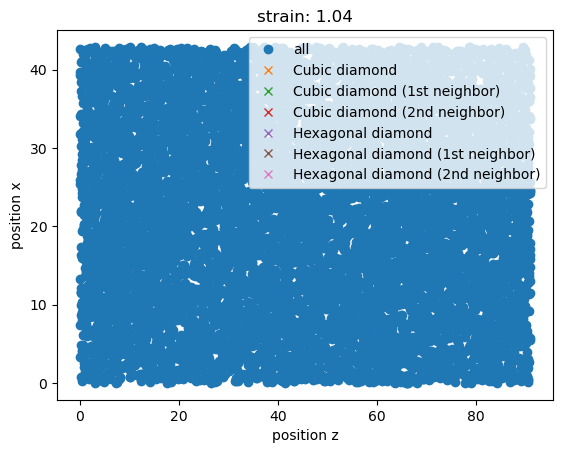

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


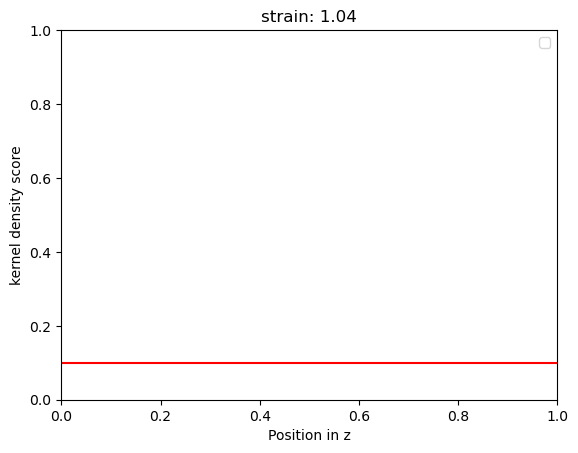

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


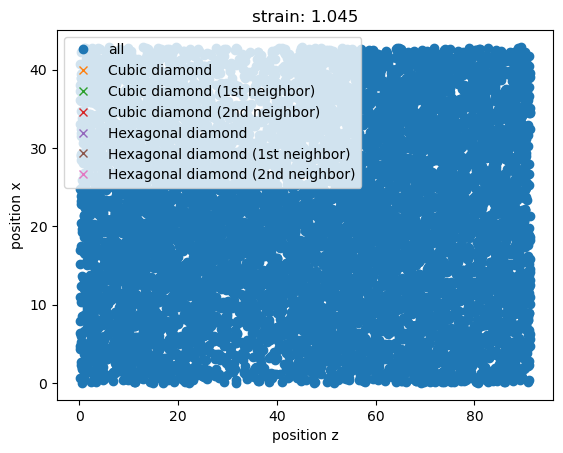

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


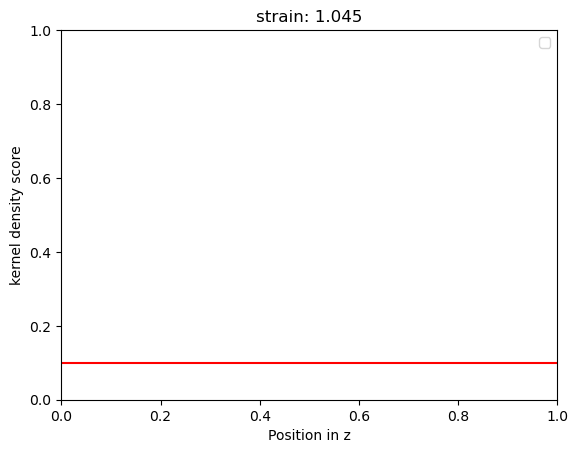

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


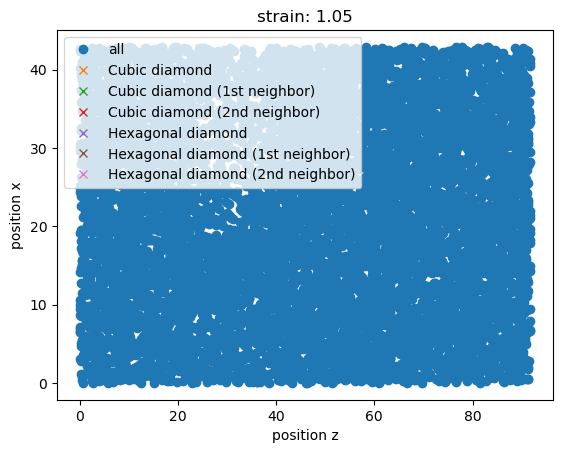

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


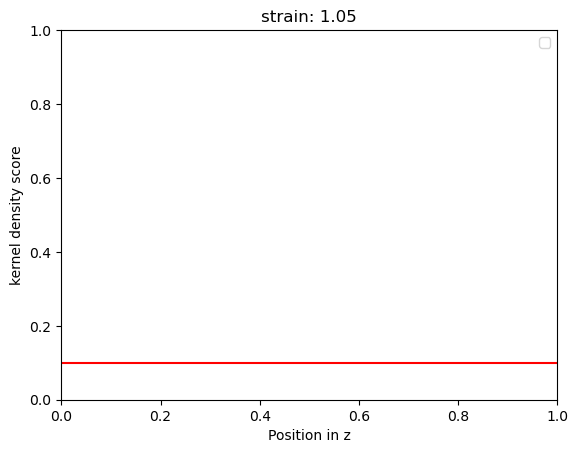

2181.168 0.0 0.0 0.0
{'timestep': 2, 'fit_range': 0.05, 'nve_run_time_steps': 25000, 'boundary_value': 0.25, 'ratio_boundary': 0.25, 'temperature_next': 2181.168, 'center': 1.0}


The job ham_npt_solid_2181_17 was saved and received the ID: 914


The job ham_npt_liquid_high_3181_17 was saved and received the ID: 915


The job ham_npt_liquid_low_2181_17 was saved and received the ID: 916


2023-07-03 17:26:05,013 - pyiron_log - WARNING - Job 'ham_nve_0_95_2181_17_0' does not exist and cannot be loaded


The job ham_nvt_0_95_2181_17_0 was saved and received the ID: 917


2023-07-03 17:26:45,278 - pyiron_log - WARNING - Job 'ham_nve_0_955_2181_17_0' does not exist and cannot be loaded


The job ham_nvt_0_955_2181_17_0 was saved and received the ID: 918


2023-07-03 17:27:24,954 - pyiron_log - WARNING - Job 'ham_nve_0_96_2181_17_0' does not exist and cannot be loaded


The job ham_nvt_0_96_2181_17_0 was saved and received the ID: 919


2023-07-03 17:28:04,296 - pyiron_log - WARNING - Job 'ham_nve_0_965_2181_17_0' does not exist and cannot be loaded


The job ham_nvt_0_965_2181_17_0 was saved and received the ID: 920


2023-07-03 17:28:42,964 - pyiron_log - WARNING - Job 'ham_nve_0_97_2181_17_0' does not exist and cannot be loaded


The job ham_nvt_0_97_2181_17_0 was saved and received the ID: 921


2023-07-03 17:29:21,309 - pyiron_log - WARNING - Job 'ham_nve_0_975_2181_17_0' does not exist and cannot be loaded


The job ham_nvt_0_975_2181_17_0 was saved and received the ID: 922


2023-07-03 17:29:59,359 - pyiron_log - WARNING - Job 'ham_nve_0_98_2181_17_0' does not exist and cannot be loaded


The job ham_nvt_0_98_2181_17_0 was saved and received the ID: 923


2023-07-03 17:30:36,881 - pyiron_log - WARNING - Job 'ham_nve_0_985_2181_17_0' does not exist and cannot be loaded


The job ham_nvt_0_985_2181_17_0 was saved and received the ID: 924


2023-07-03 17:31:13,504 - pyiron_log - WARNING - Job 'ham_nve_0_99_2181_17_0' does not exist and cannot be loaded


The job ham_nvt_0_99_2181_17_0 was saved and received the ID: 925


2023-07-03 17:31:49,859 - pyiron_log - WARNING - Job 'ham_nve_0_995_2181_17_0' does not exist and cannot be loaded


The job ham_nvt_0_995_2181_17_0 was saved and received the ID: 926


2023-07-03 17:32:25,783 - pyiron_log - WARNING - Job 'ham_nve_1_0_2181_17_0' does not exist and cannot be loaded


The job ham_nvt_1_0_2181_17_0 was saved and received the ID: 927


2023-07-03 17:33:01,030 - pyiron_log - WARNING - Job 'ham_nve_1_005_2181_17_0' does not exist and cannot be loaded


The job ham_nvt_1_005_2181_17_0 was saved and received the ID: 928


2023-07-03 17:33:35,792 - pyiron_log - WARNING - Job 'ham_nve_1_01_2181_17_0' does not exist and cannot be loaded


The job ham_nvt_1_01_2181_17_0 was saved and received the ID: 929


2023-07-03 17:34:10,010 - pyiron_log - WARNING - Job 'ham_nve_1_015_2181_17_0' does not exist and cannot be loaded


The job ham_nvt_1_015_2181_17_0 was saved and received the ID: 930


2023-07-03 17:34:47,031 - pyiron_log - WARNING - Job 'ham_nve_1_02_2181_17_0' does not exist and cannot be loaded


The job ham_nvt_1_02_2181_17_0 was saved and received the ID: 931


2023-07-03 17:35:24,856 - pyiron_log - WARNING - Job 'ham_nve_1_025_2181_17_0' does not exist and cannot be loaded


The job ham_nvt_1_025_2181_17_0 was saved and received the ID: 932


2023-07-03 17:36:02,967 - pyiron_log - WARNING - Job 'ham_nve_1_03_2181_17_0' does not exist and cannot be loaded


The job ham_nvt_1_03_2181_17_0 was saved and received the ID: 933


2023-07-03 17:36:38,211 - pyiron_log - WARNING - Job 'ham_nve_1_035_2181_17_0' does not exist and cannot be loaded


The job ham_nvt_1_035_2181_17_0 was saved and received the ID: 934


2023-07-03 17:37:15,209 - pyiron_log - WARNING - Job 'ham_nve_1_04_2181_17_0' does not exist and cannot be loaded


The job ham_nvt_1_04_2181_17_0 was saved and received the ID: 935


2023-07-03 17:38:00,791 - pyiron_log - WARNING - Job 'ham_nve_1_045_2181_17_0' does not exist and cannot be loaded


The job ham_nvt_1_045_2181_17_0 was saved and received the ID: 936


2023-07-03 17:38:37,789 - pyiron_log - WARNING - Job 'ham_nve_1_05_2181_17_0' does not exist and cannot be loaded


The job ham_nvt_1_05_2181_17_0 was saved and received the ID: 937


The job ham_nve_0_95_2181_17_0 was saved and received the ID: 938


The job ham_nve_0_955_2181_17_0 was saved and received the ID: 939


The job ham_nve_0_96_2181_17_0 was saved and received the ID: 940


The job ham_nve_0_965_2181_17_0 was saved and received the ID: 941


The job ham_nve_0_97_2181_17_0 was saved and received the ID: 942


The job ham_nve_0_975_2181_17_0 was saved and received the ID: 943


The job ham_nve_0_98_2181_17_0 was saved and received the ID: 944


The job ham_nve_0_985_2181_17_0 was saved and received the ID: 945


The job ham_nve_0_99_2181_17_0 was saved and received the ID: 946


The job ham_nve_0_995_2181_17_0 was saved and received the ID: 947


The job ham_nve_1_0_2181_17_0 was saved and received the ID: 948


The job ham_nve_1_005_2181_17_0 was saved and received the ID: 949


The job ham_nve_1_01_2181_17_0 was saved and received the ID: 950


The job ham_nve_1_015_2181_17_0 was saved and received the ID: 951


The job ham_nve_1_02_2181_17_0 was saved and received the ID: 952


The job ham_nve_1_025_2181_17_0 was saved and received the ID: 953


The job ham_nve_1_03_2181_17_0 was saved and received the ID: 954


The job ham_nve_1_035_2181_17_0 was saved and received the ID: 955


The job ham_nve_1_04_2181_17_0 was saved and received the ID: 956


The job ham_nve_1_045_2181_17_0 was saved and received the ID: 957


The job ham_nve_1_05_2181_17_0 was saved and received the ID: 958


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


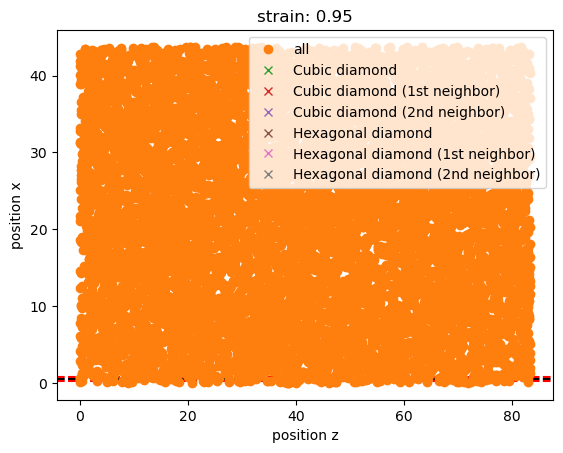

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


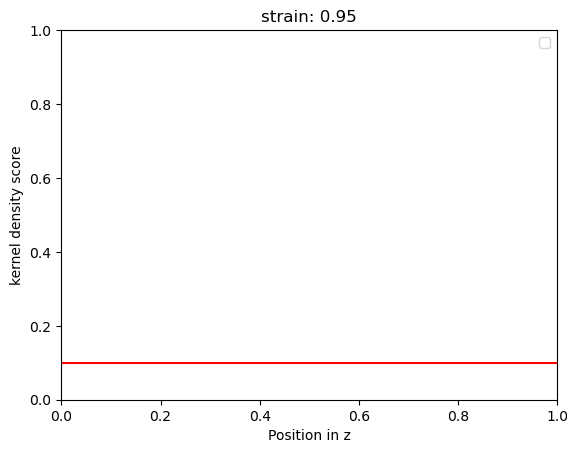

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


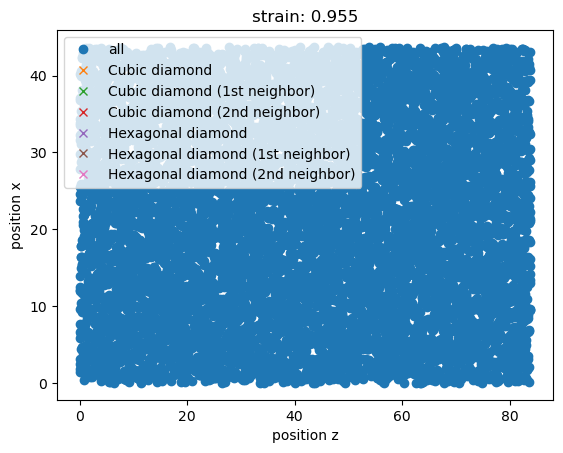

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


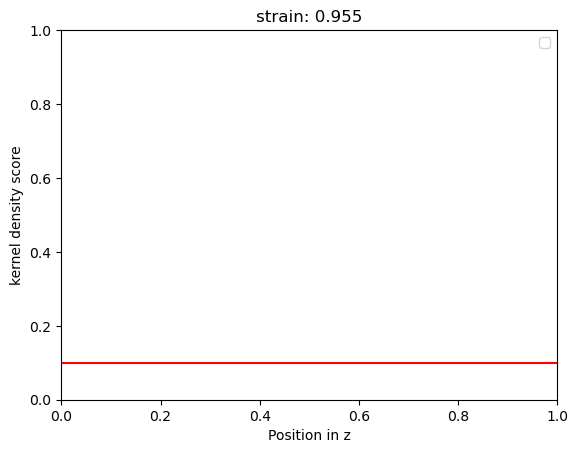

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


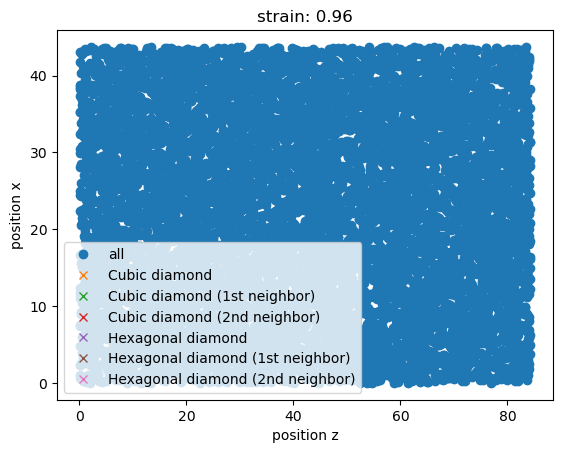

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


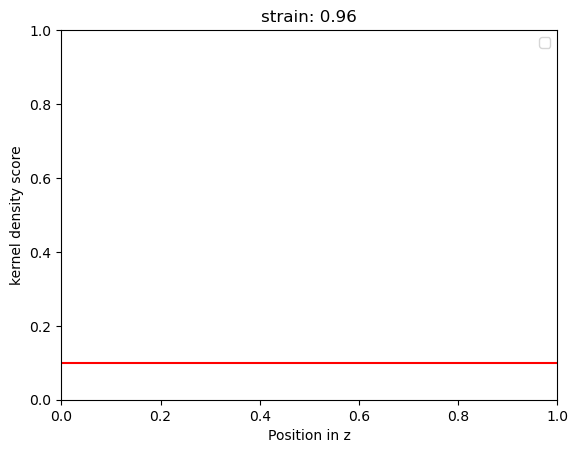

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


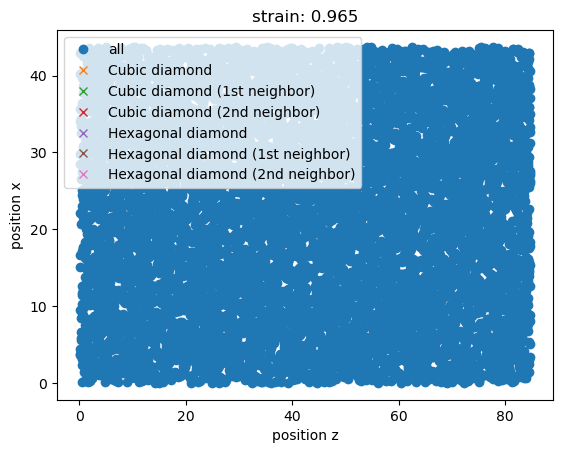

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


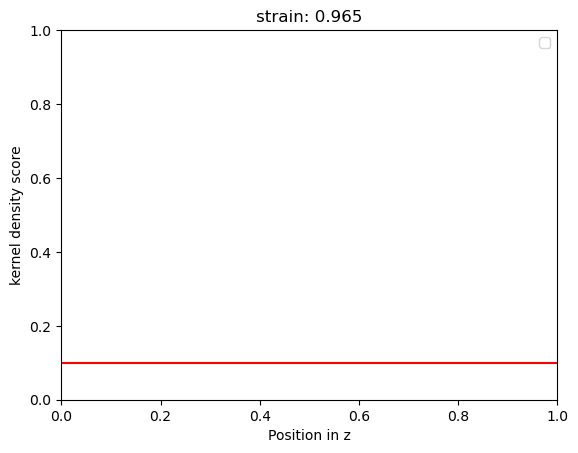

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


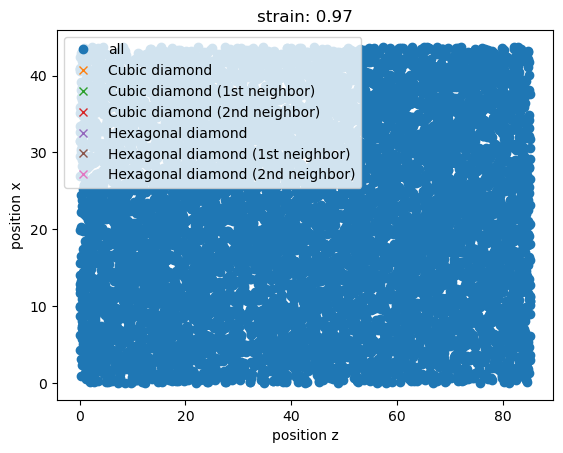

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


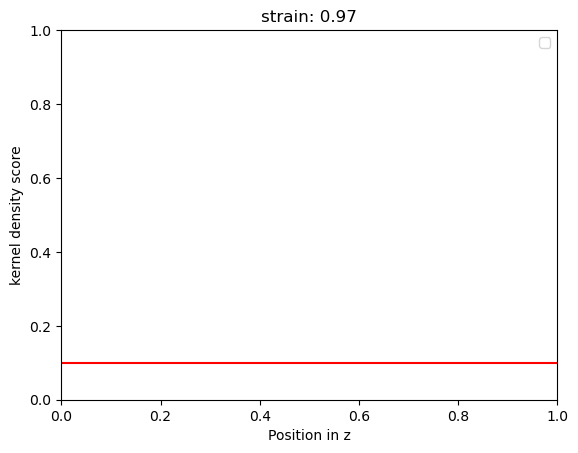

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


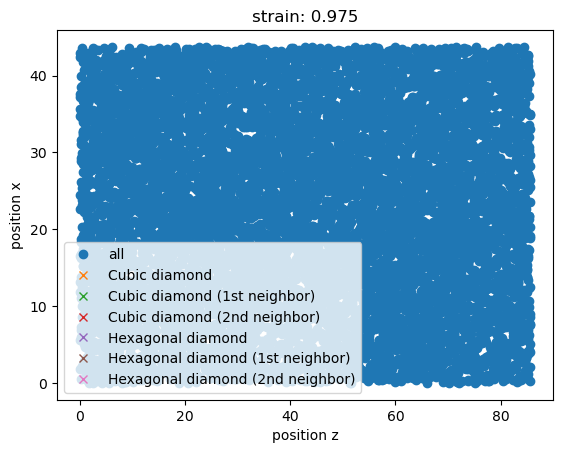

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


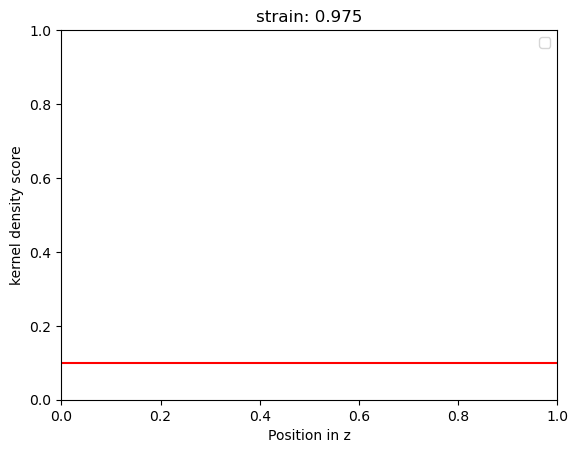

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


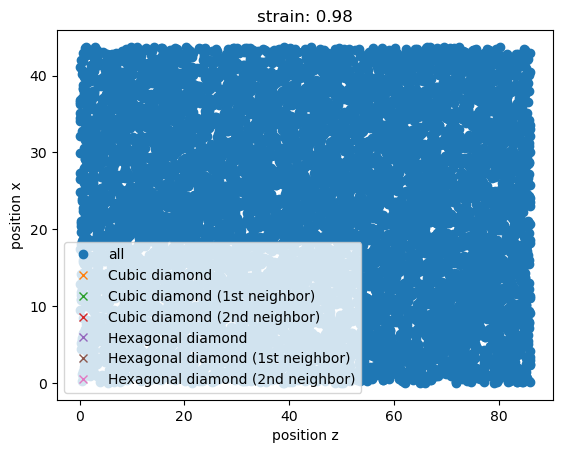

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


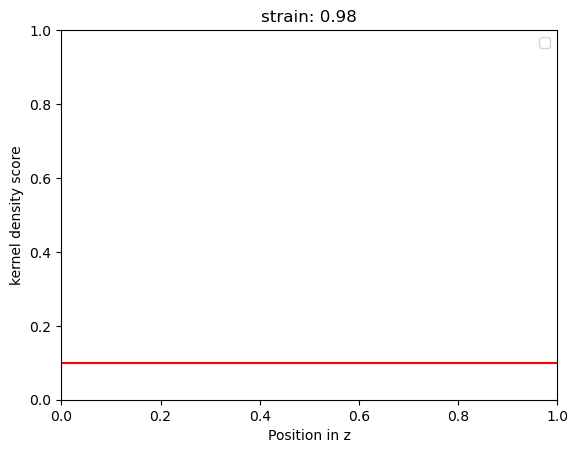

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


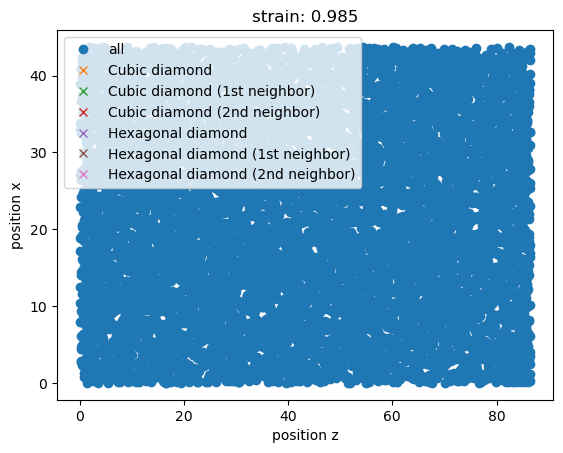

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


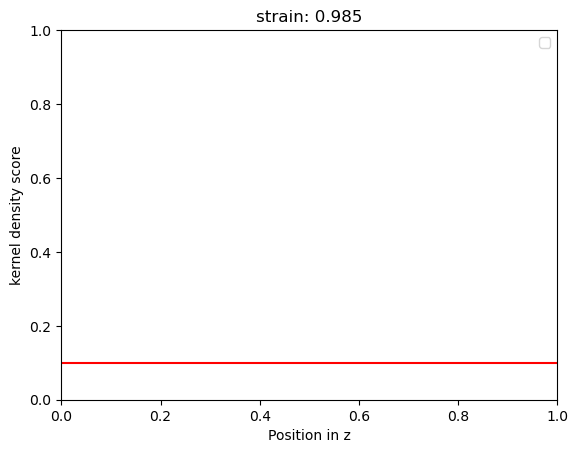

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


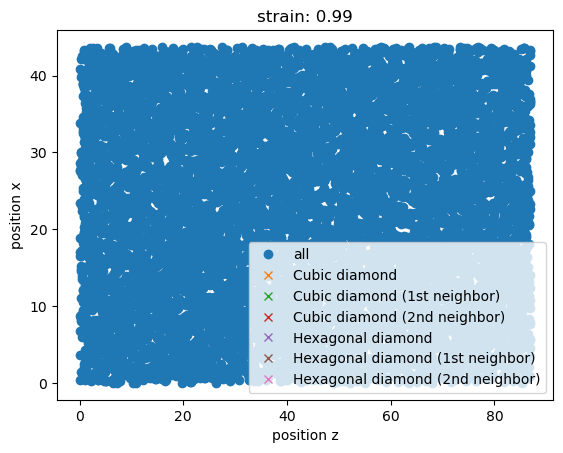

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


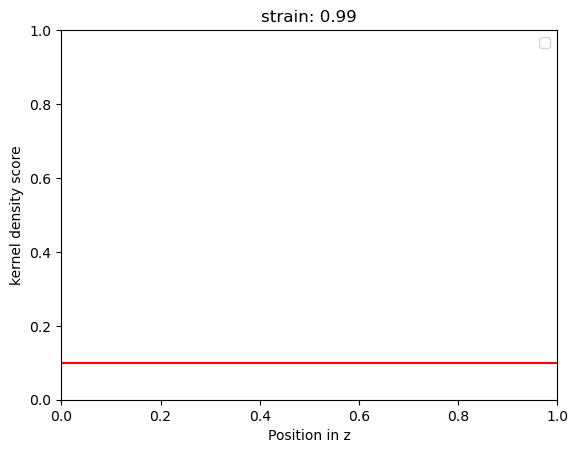

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


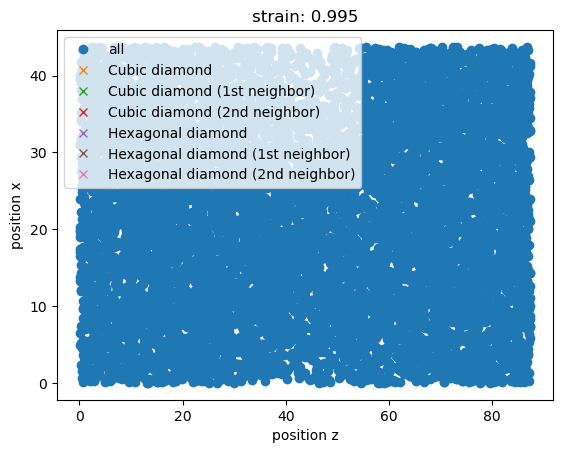

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


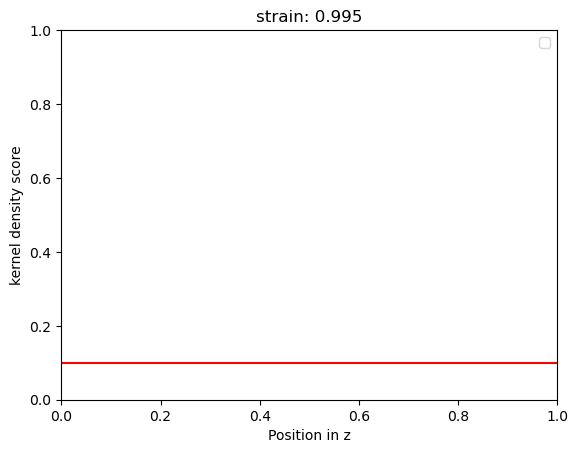

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


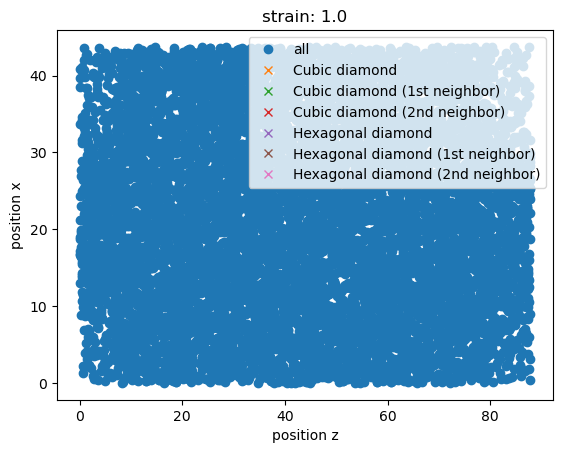

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


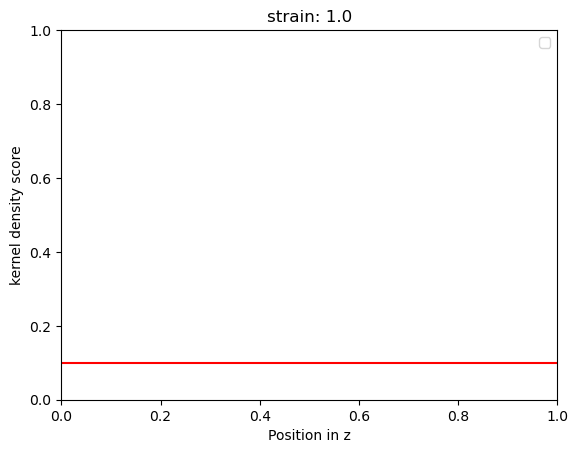

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


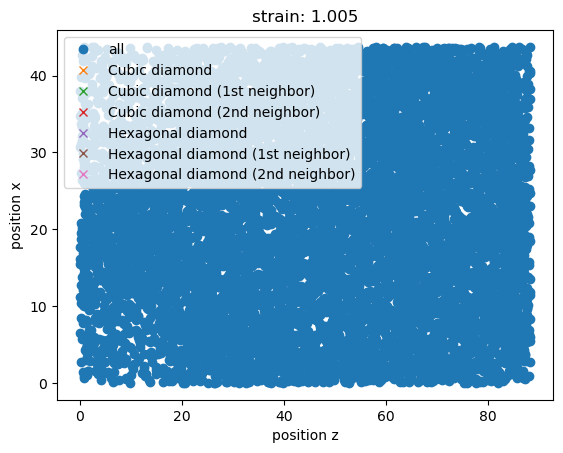

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


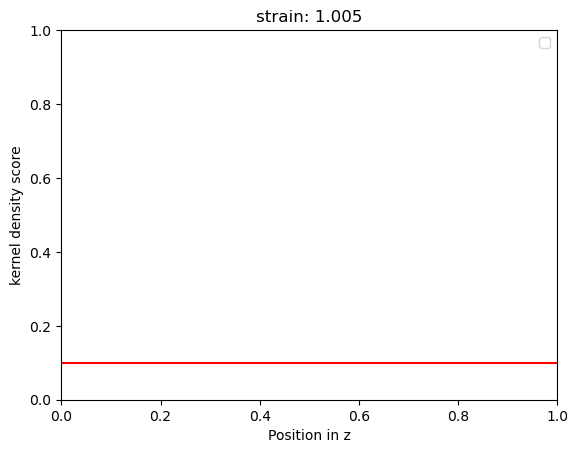

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


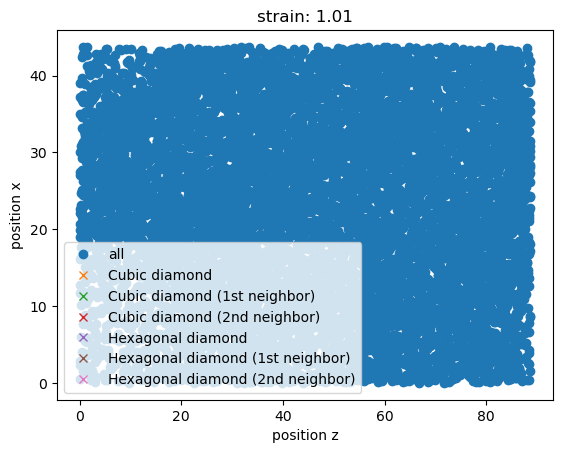

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


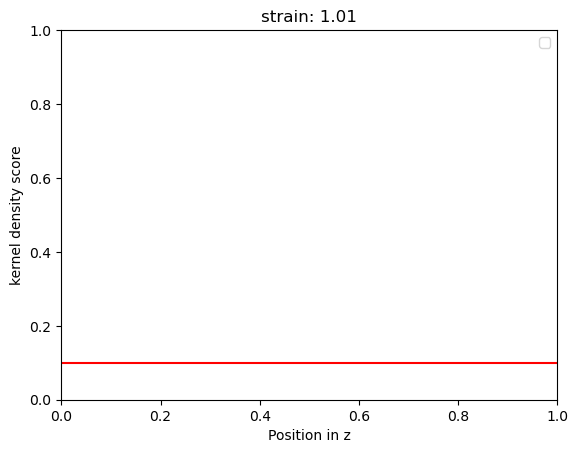

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


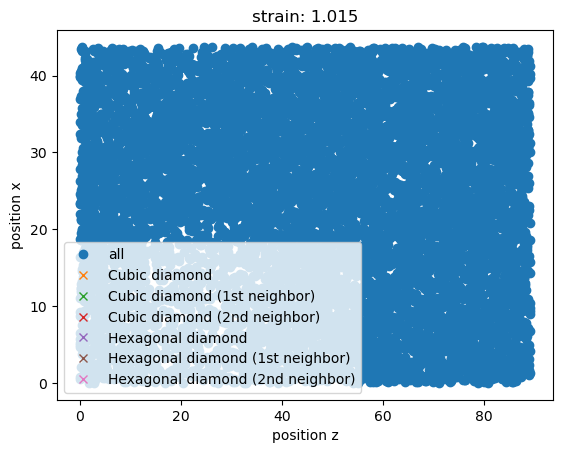

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


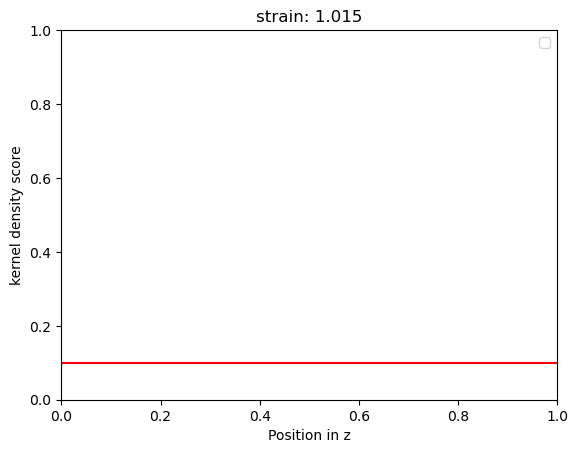

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


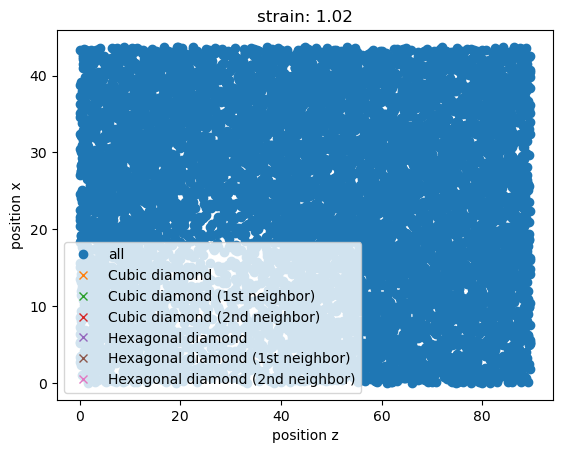

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


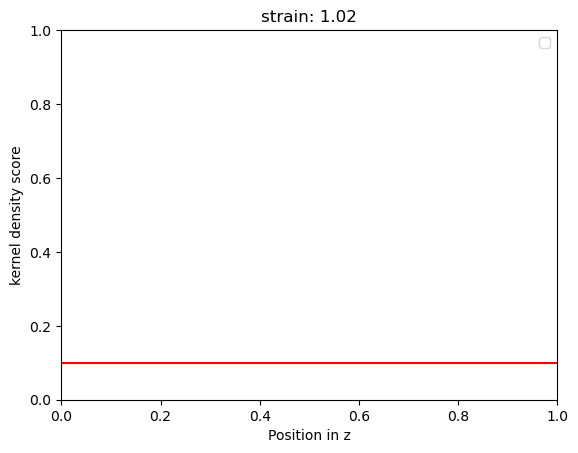

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


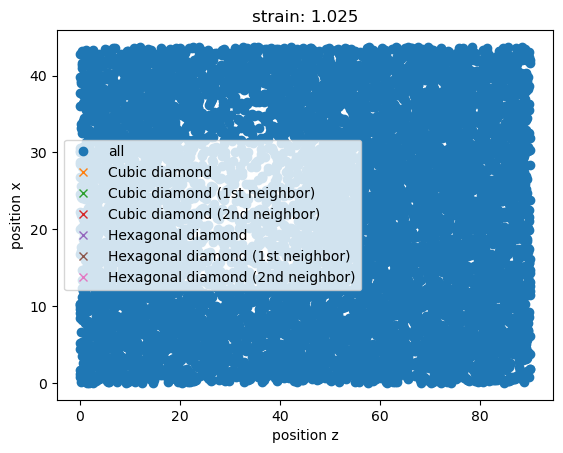

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


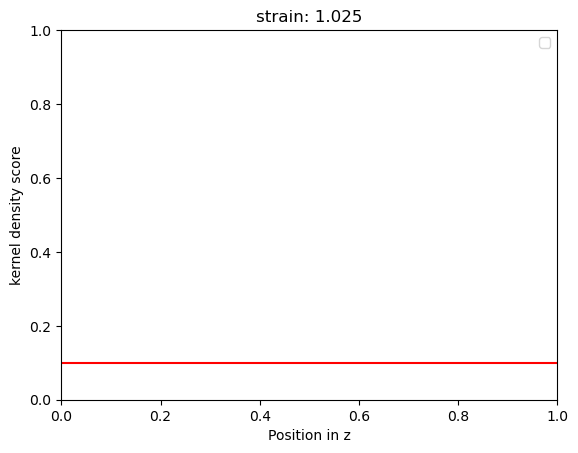

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


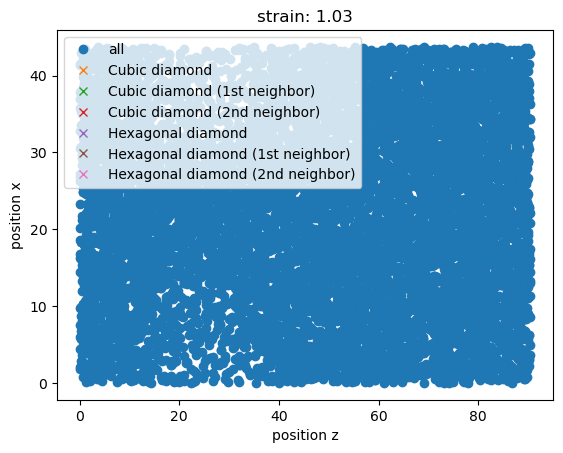

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


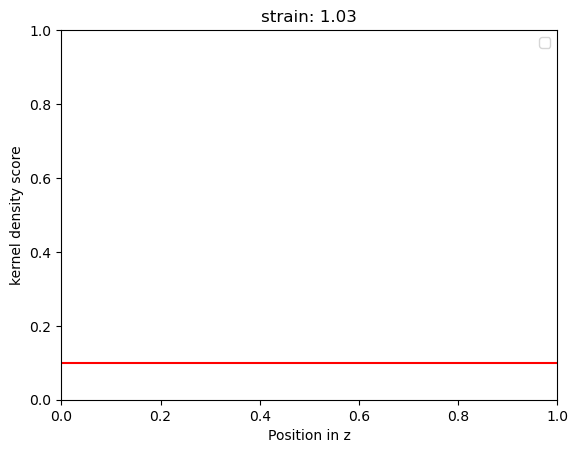

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


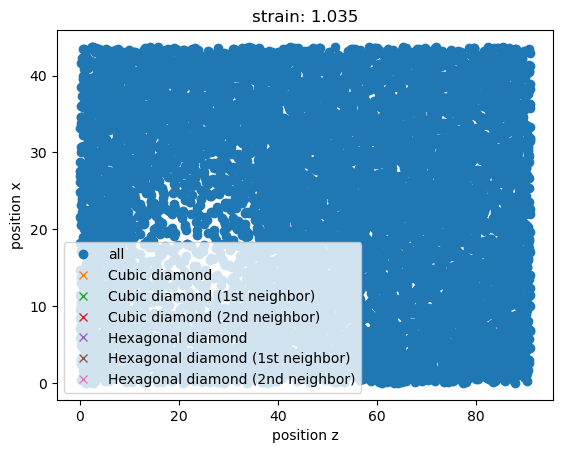

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


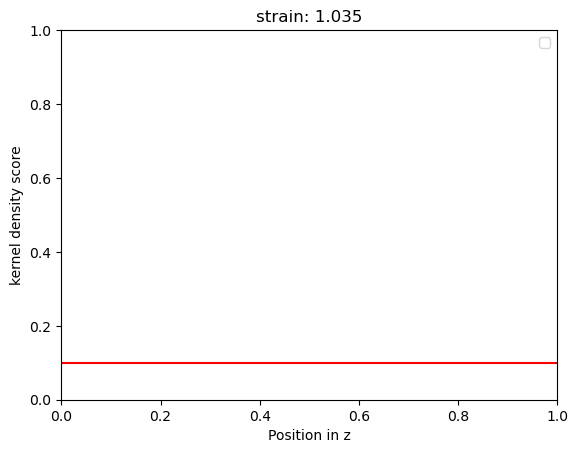

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


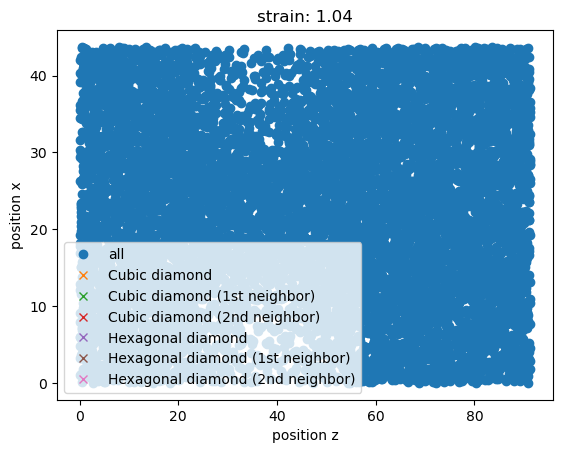

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


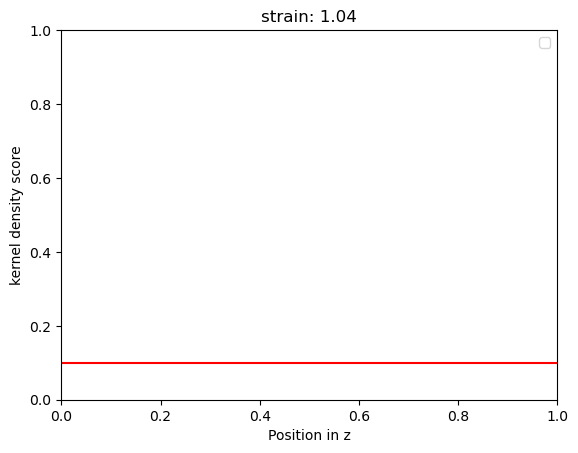

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


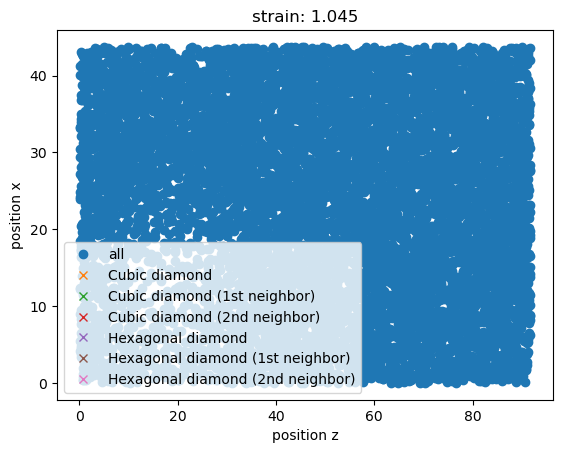

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


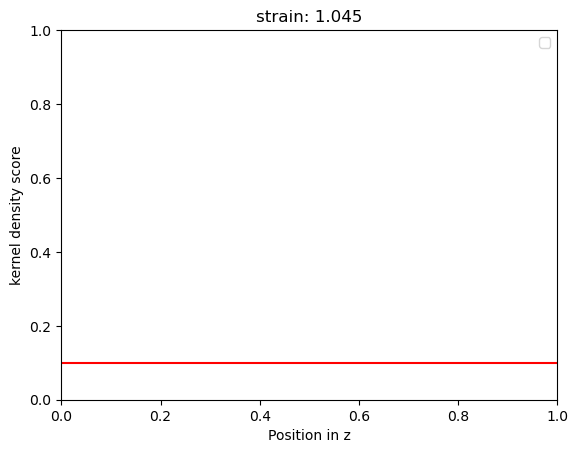

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


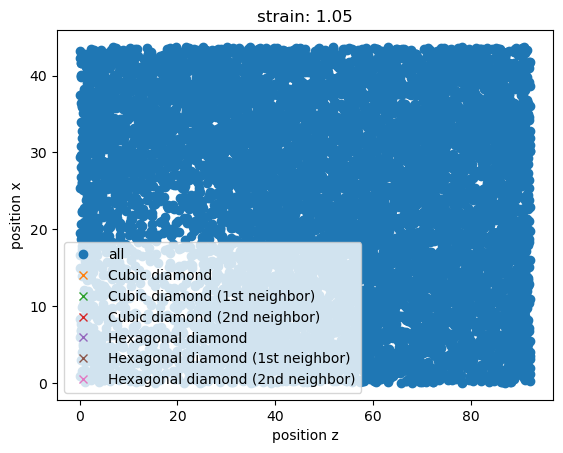

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


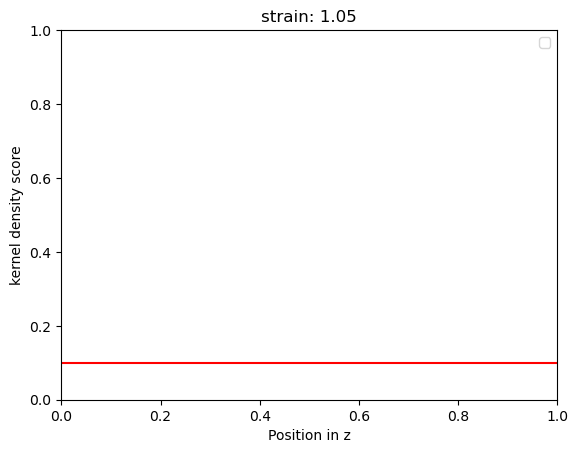

1963.053 0.0 0.0 0.0
{'timestep': 2, 'fit_range': 0.05, 'nve_run_time_steps': 25000, 'boundary_value': 0.25, 'ratio_boundary': 0.25, 'temperature_next': 1963.053, 'center': 1.0}


The job ham_npt_solid_1963_05 was saved and received the ID: 959


The job ham_npt_liquid_high_2963_05 was saved and received the ID: 960


The job ham_npt_liquid_low_1963_05 was saved and received the ID: 961


2023-07-03 18:20:21,743 - pyiron_log - WARNING - Job 'ham_nve_0_95_1963_05_0' does not exist and cannot be loaded


The job ham_nvt_0_95_1963_05_0 was saved and received the ID: 962


2023-07-03 18:21:02,546 - pyiron_log - WARNING - Job 'ham_nve_0_955_1963_05_0' does not exist and cannot be loaded


The job ham_nvt_0_955_1963_05_0 was saved and received the ID: 963


2023-07-03 18:21:42,625 - pyiron_log - WARNING - Job 'ham_nve_0_96_1963_05_0' does not exist and cannot be loaded


The job ham_nvt_0_96_1963_05_0 was saved and received the ID: 964


2023-07-03 18:22:22,283 - pyiron_log - WARNING - Job 'ham_nve_0_965_1963_05_0' does not exist and cannot be loaded


The job ham_nvt_0_965_1963_05_0 was saved and received the ID: 965


2023-07-03 18:23:01,135 - pyiron_log - WARNING - Job 'ham_nve_0_97_1963_05_0' does not exist and cannot be loaded


The job ham_nvt_0_97_1963_05_0 was saved and received the ID: 966


2023-07-03 18:23:39,919 - pyiron_log - WARNING - Job 'ham_nve_0_975_1963_05_0' does not exist and cannot be loaded


The job ham_nvt_0_975_1963_05_0 was saved and received the ID: 967


2023-07-03 18:24:18,170 - pyiron_log - WARNING - Job 'ham_nve_0_98_1963_05_0' does not exist and cannot be loaded


The job ham_nvt_0_98_1963_05_0 was saved and received the ID: 968


2023-07-03 18:24:55,777 - pyiron_log - WARNING - Job 'ham_nve_0_985_1963_05_0' does not exist and cannot be loaded


The job ham_nvt_0_985_1963_05_0 was saved and received the ID: 969


2023-07-03 18:25:35,071 - pyiron_log - WARNING - Job 'ham_nve_0_99_1963_05_0' does not exist and cannot be loaded


The job ham_nvt_0_99_1963_05_0 was saved and received the ID: 970


2023-07-03 18:26:11,305 - pyiron_log - WARNING - Job 'ham_nve_0_995_1963_05_0' does not exist and cannot be loaded


The job ham_nvt_0_995_1963_05_0 was saved and received the ID: 971


2023-07-03 18:26:46,939 - pyiron_log - WARNING - Job 'ham_nve_1_0_1963_05_0' does not exist and cannot be loaded


The job ham_nvt_1_0_1963_05_0 was saved and received the ID: 972


2023-07-03 18:27:21,824 - pyiron_log - WARNING - Job 'ham_nve_1_005_1963_05_0' does not exist and cannot be loaded


The job ham_nvt_1_005_1963_05_0 was saved and received the ID: 973


2023-07-03 18:27:56,203 - pyiron_log - WARNING - Job 'ham_nve_1_01_1963_05_0' does not exist and cannot be loaded


The job ham_nvt_1_01_1963_05_0 was saved and received the ID: 974


2023-07-03 18:28:30,097 - pyiron_log - WARNING - Job 'ham_nve_1_015_1963_05_0' does not exist and cannot be loaded


The job ham_nvt_1_015_1963_05_0 was saved and received the ID: 975


2023-07-03 18:29:03,561 - pyiron_log - WARNING - Job 'ham_nve_1_02_1963_05_0' does not exist and cannot be loaded


The job ham_nvt_1_02_1963_05_0 was saved and received the ID: 976


2023-07-03 18:29:38,481 - pyiron_log - WARNING - Job 'ham_nve_1_025_1963_05_0' does not exist and cannot be loaded


The job ham_nvt_1_025_1963_05_0 was saved and received the ID: 977


2023-07-03 18:30:14,067 - pyiron_log - WARNING - Job 'ham_nve_1_03_1963_05_0' does not exist and cannot be loaded


The job ham_nvt_1_03_1963_05_0 was saved and received the ID: 978


2023-07-03 18:30:50,971 - pyiron_log - WARNING - Job 'ham_nve_1_035_1963_05_0' does not exist and cannot be loaded


The job ham_nvt_1_035_1963_05_0 was saved and received the ID: 979


2023-07-03 18:31:27,555 - pyiron_log - WARNING - Job 'ham_nve_1_04_1963_05_0' does not exist and cannot be loaded


The job ham_nvt_1_04_1963_05_0 was saved and received the ID: 980


2023-07-03 18:32:01,881 - pyiron_log - WARNING - Job 'ham_nve_1_045_1963_05_0' does not exist and cannot be loaded


The job ham_nvt_1_045_1963_05_0 was saved and received the ID: 981


2023-07-03 18:32:36,655 - pyiron_log - WARNING - Job 'ham_nve_1_05_1963_05_0' does not exist and cannot be loaded


The job ham_nvt_1_05_1963_05_0 was saved and received the ID: 982


The job ham_nve_0_95_1963_05_0 was saved and received the ID: 983


The job ham_nve_0_955_1963_05_0 was saved and received the ID: 984


The job ham_nve_0_96_1963_05_0 was saved and received the ID: 985


The job ham_nve_0_965_1963_05_0 was saved and received the ID: 986


The job ham_nve_0_97_1963_05_0 was saved and received the ID: 987


The job ham_nve_0_975_1963_05_0 was saved and received the ID: 988


The job ham_nve_0_98_1963_05_0 was saved and received the ID: 989


The job ham_nve_0_985_1963_05_0 was saved and received the ID: 990


The job ham_nve_0_99_1963_05_0 was saved and received the ID: 991


The job ham_nve_0_995_1963_05_0 was saved and received the ID: 992


The job ham_nve_1_0_1963_05_0 was saved and received the ID: 993


The job ham_nve_1_005_1963_05_0 was saved and received the ID: 994


The job ham_nve_1_01_1963_05_0 was saved and received the ID: 995


The job ham_nve_1_015_1963_05_0 was saved and received the ID: 996


The job ham_nve_1_02_1963_05_0 was saved and received the ID: 997


The job ham_nve_1_025_1963_05_0 was saved and received the ID: 998


The job ham_nve_1_03_1963_05_0 was saved and received the ID: 999


The job ham_nve_1_035_1963_05_0 was saved and received the ID: 1000


The job ham_nve_1_04_1963_05_0 was saved and received the ID: 1001


The job ham_nve_1_045_1963_05_0 was saved and received the ID: 1002


The job ham_nve_1_05_1963_05_0 was saved and received the ID: 1003


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


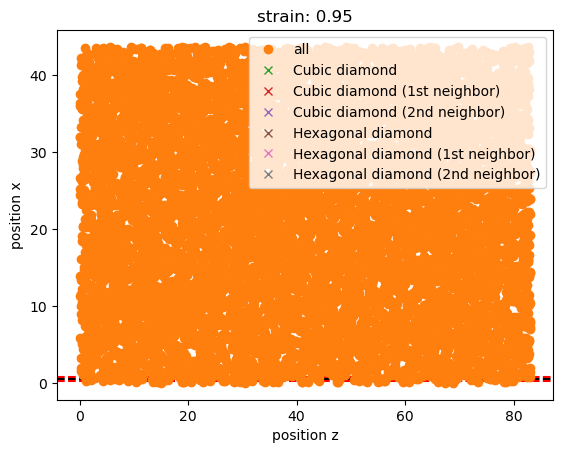

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


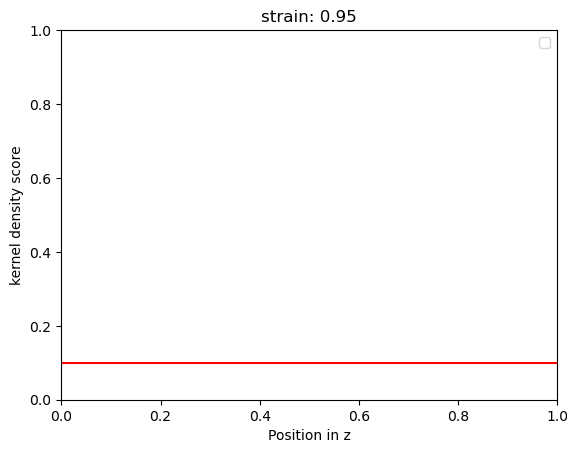

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


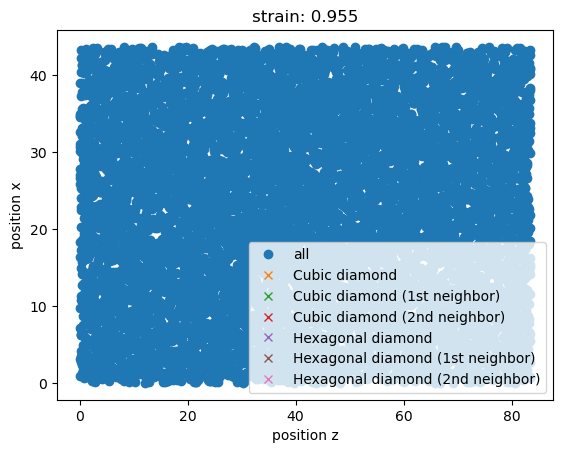

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


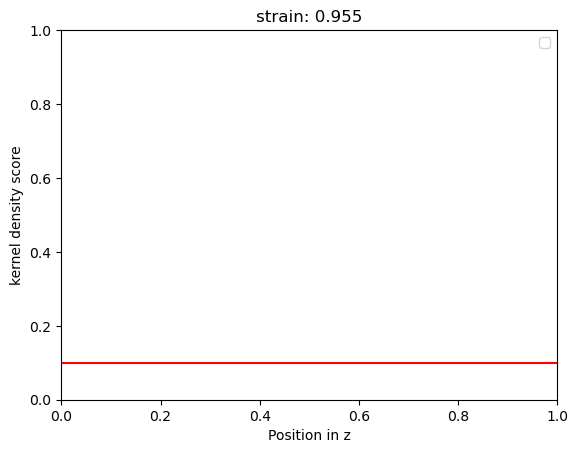

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


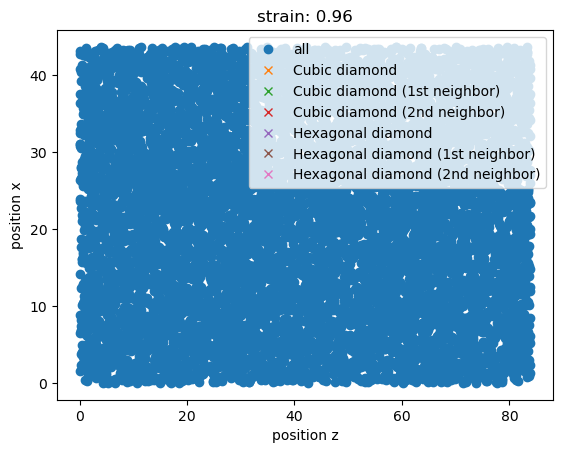

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


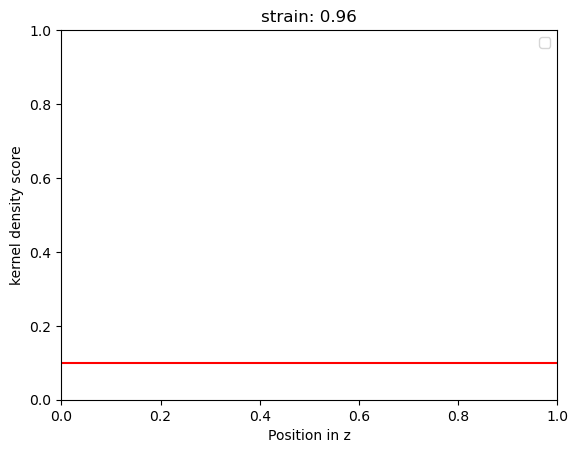

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


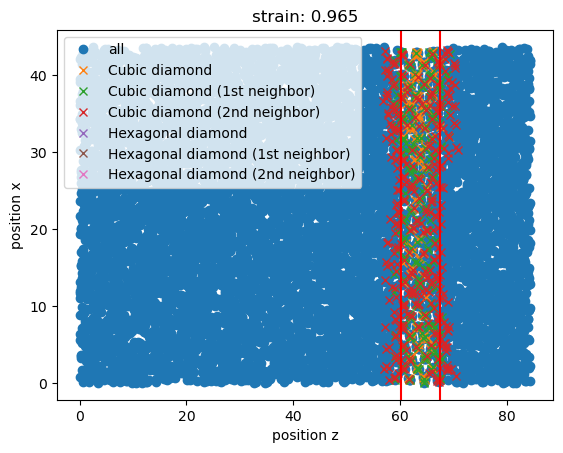

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


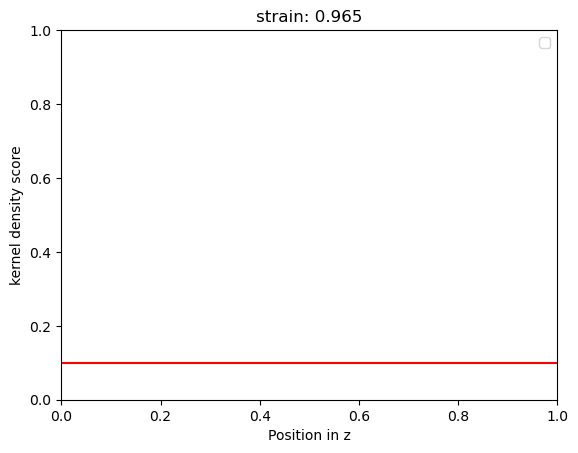

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


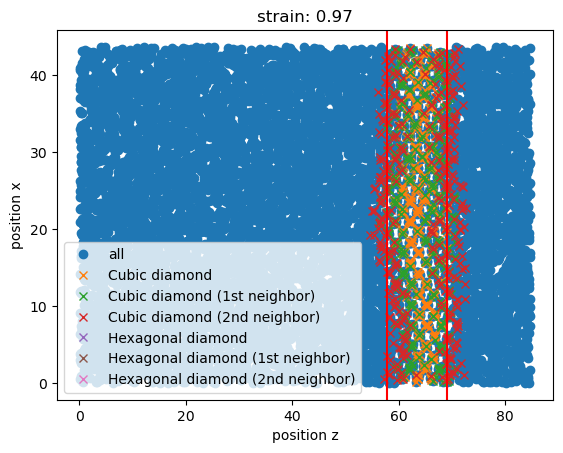

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


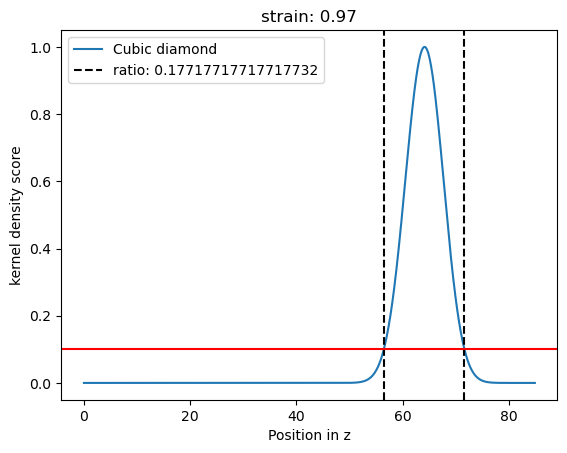

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


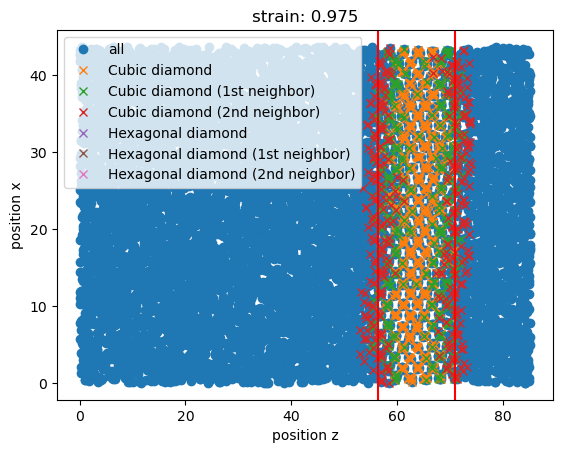

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


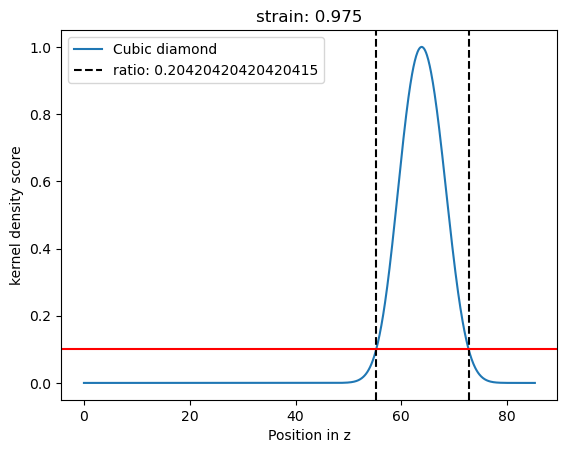

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


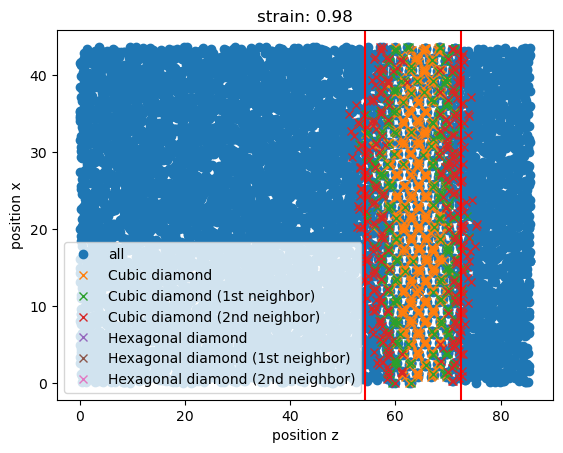

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


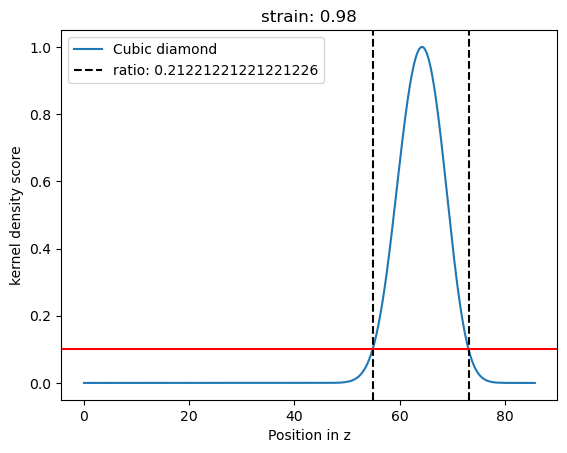

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


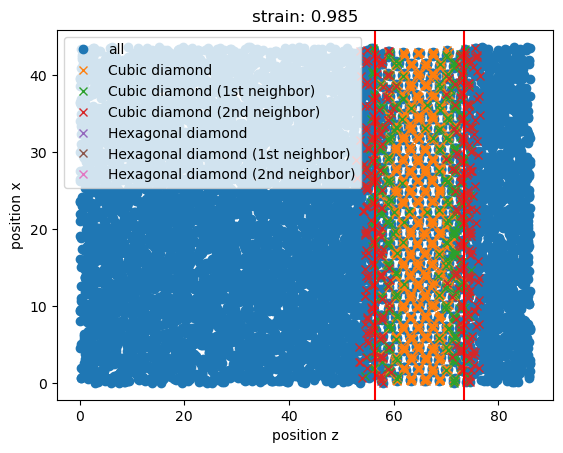

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


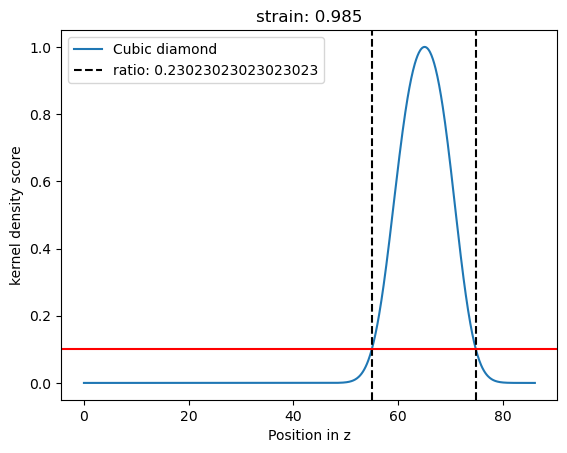

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


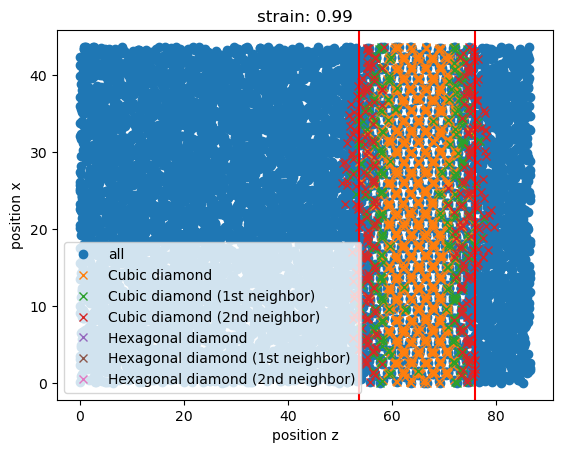

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


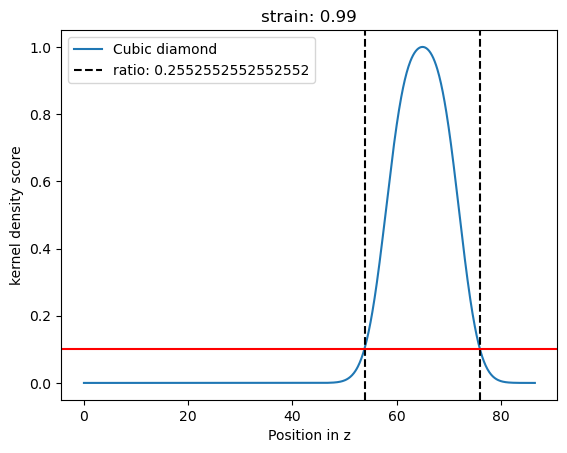

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


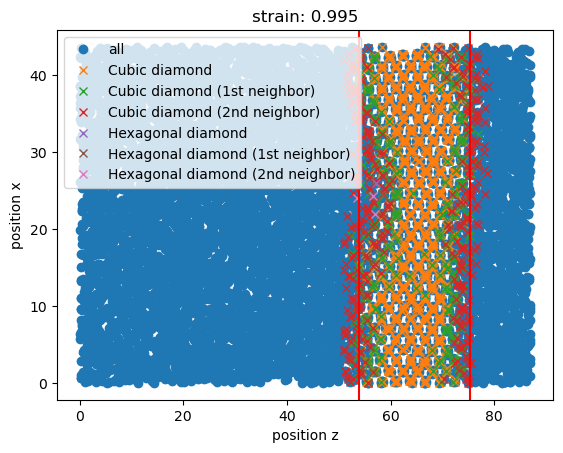

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


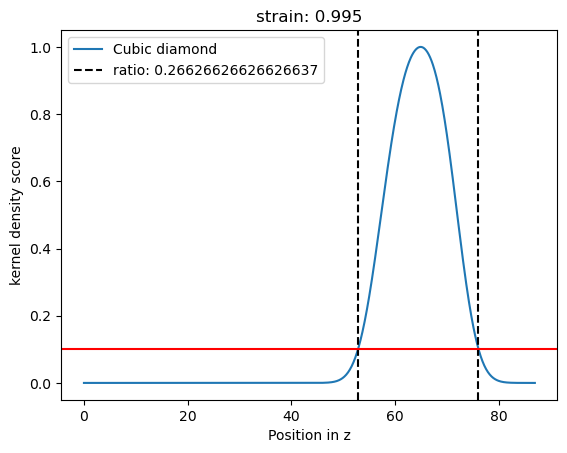

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


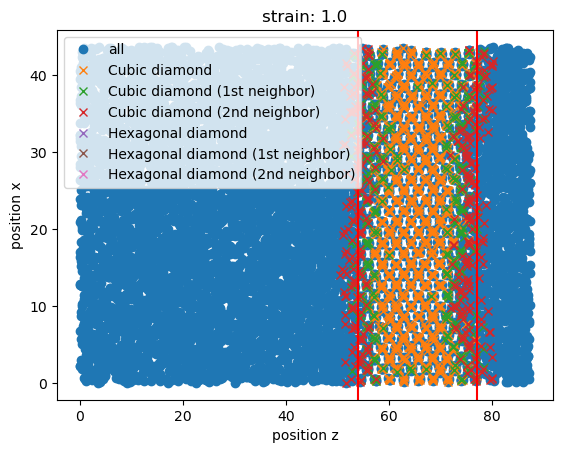

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


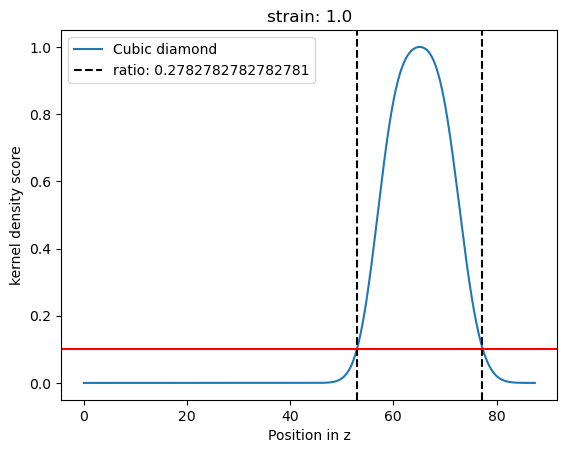

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


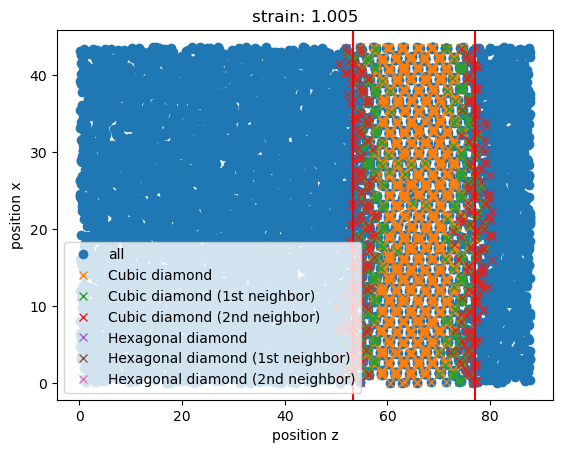

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


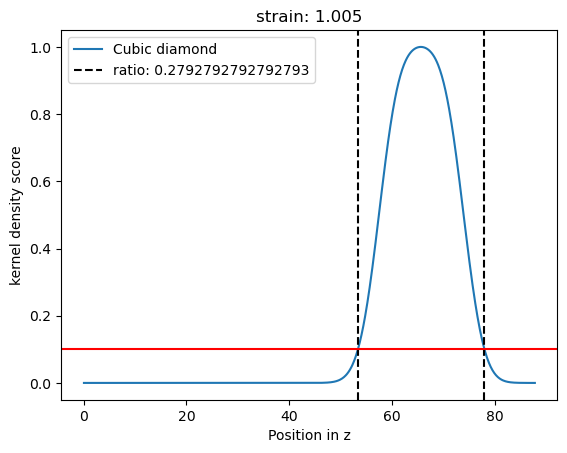

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


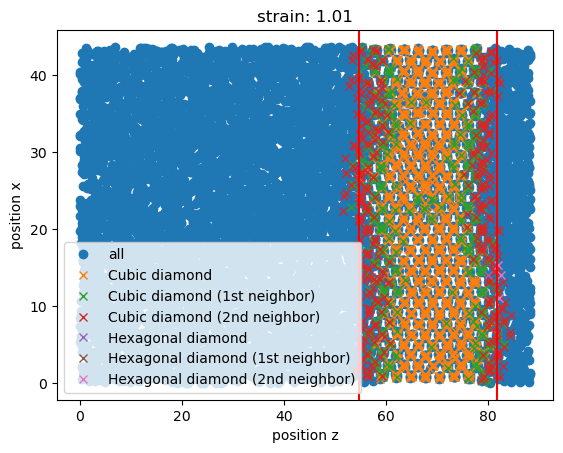

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


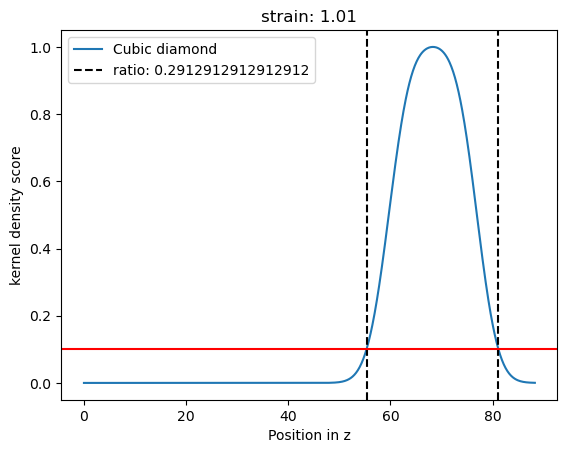

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


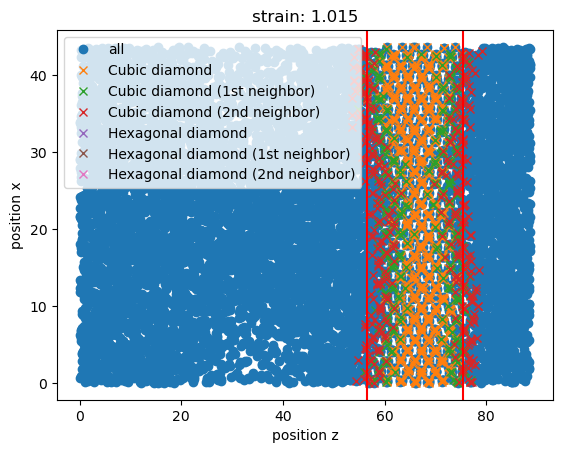

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


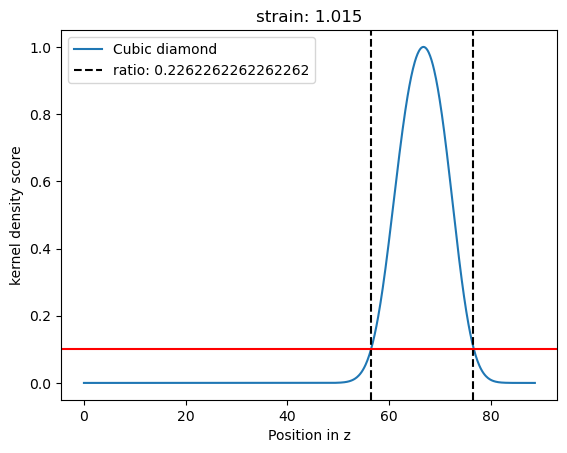

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


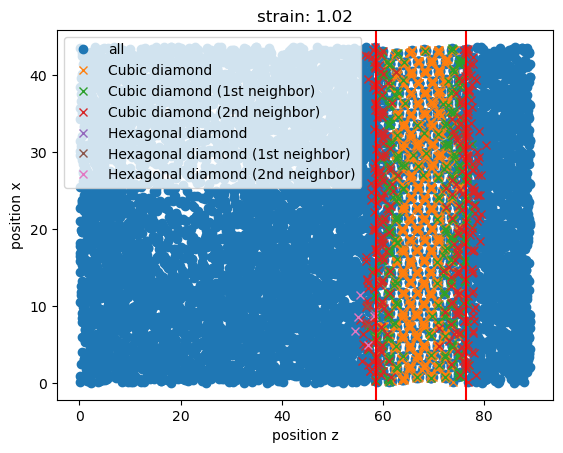

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


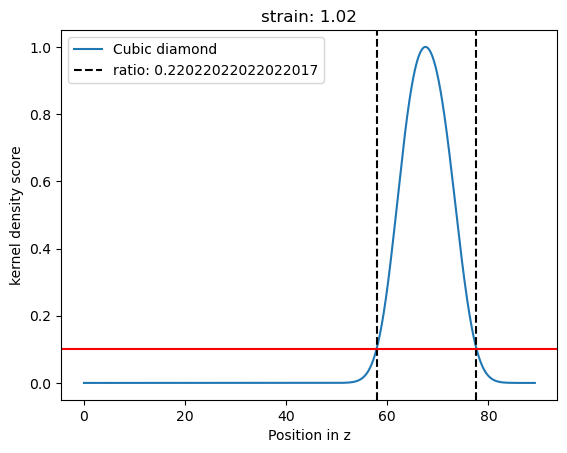

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


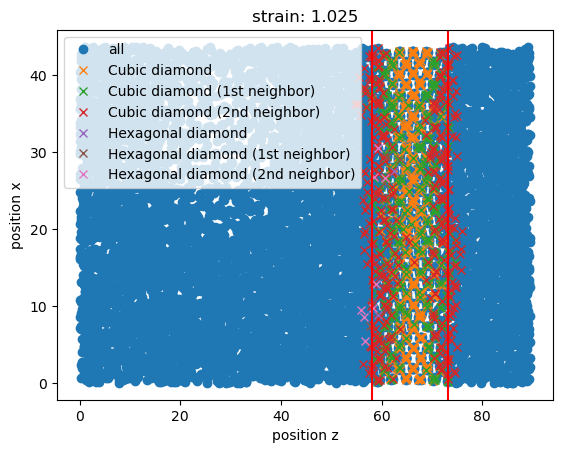

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


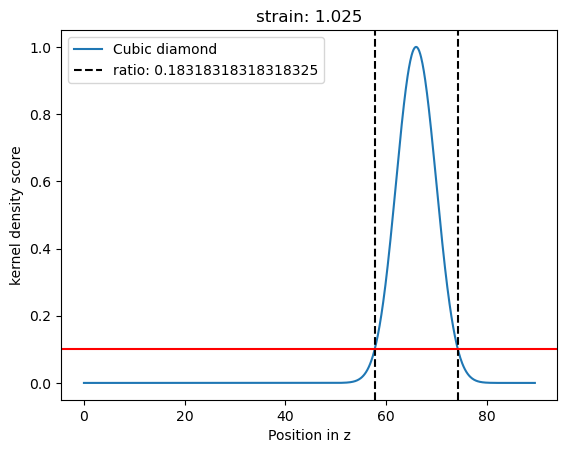

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


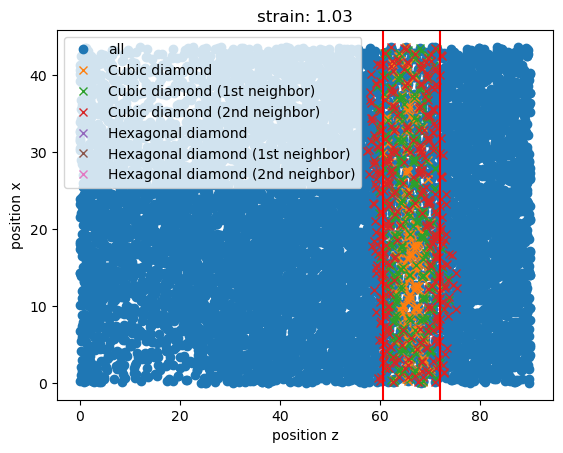

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


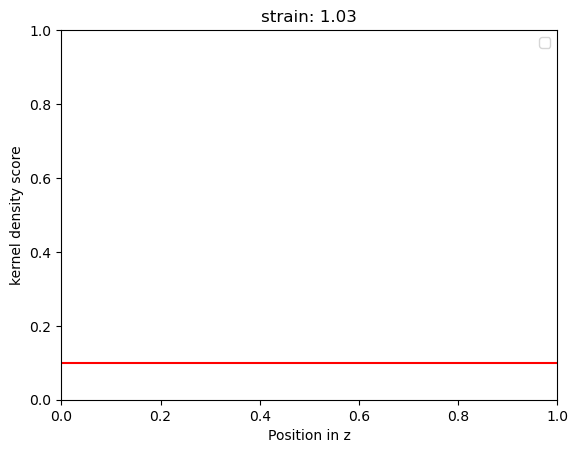

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


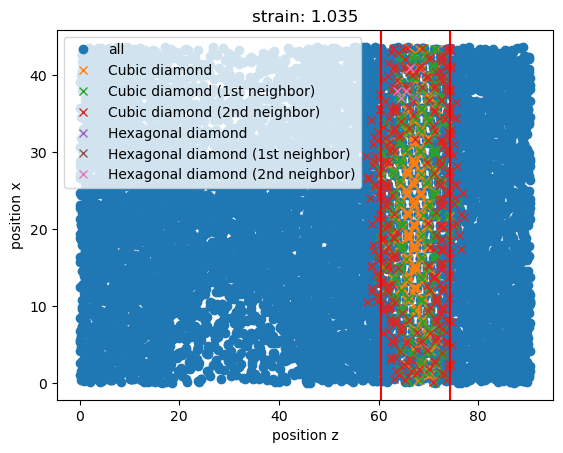

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


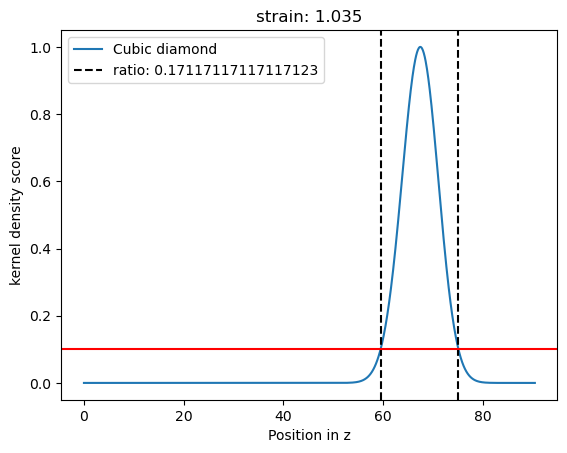

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


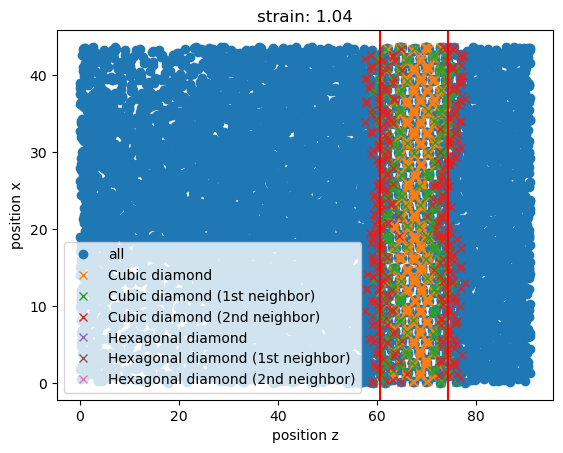

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


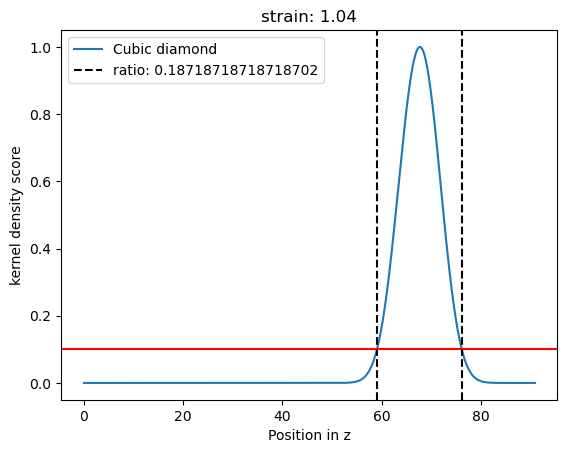

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


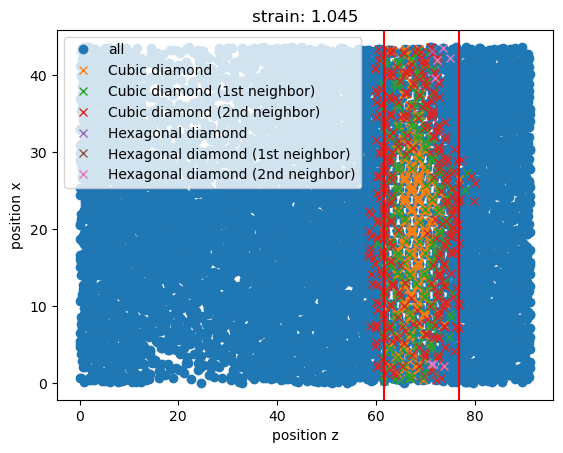

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


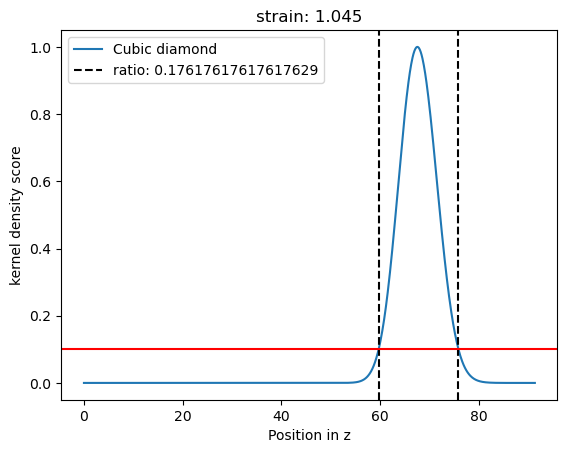

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


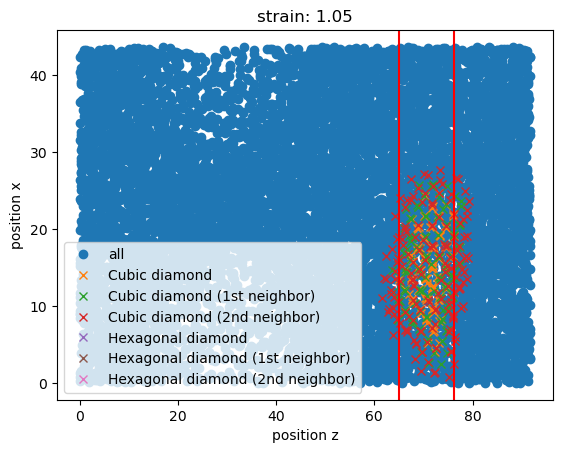

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


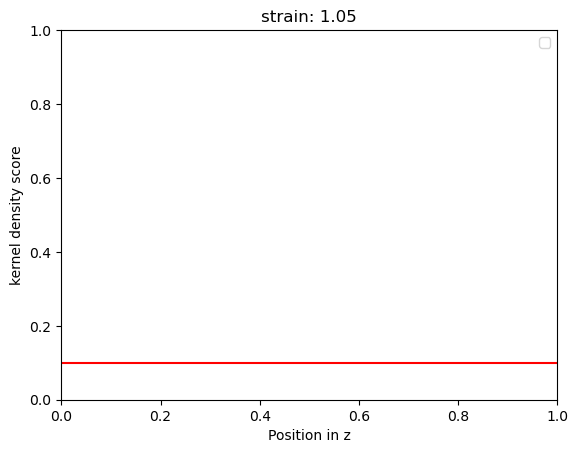

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


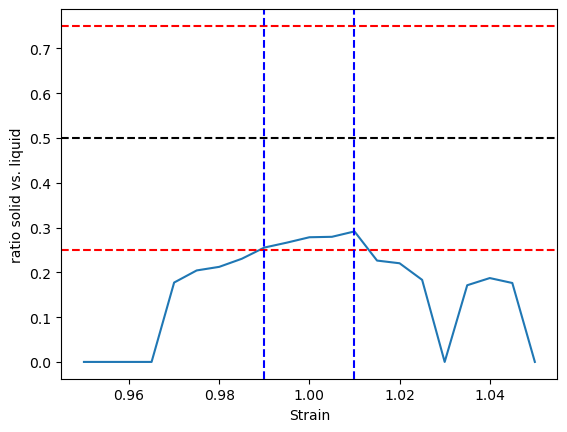

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


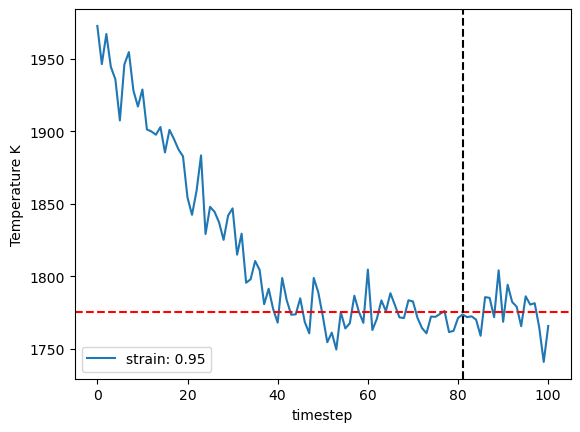

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


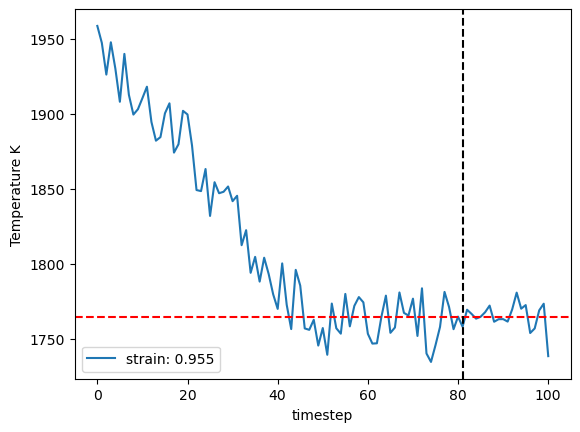

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


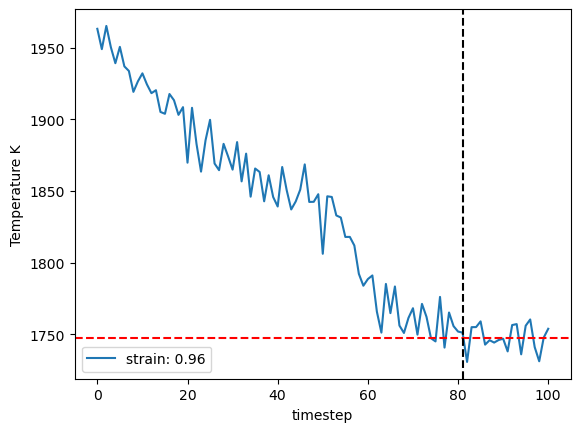

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


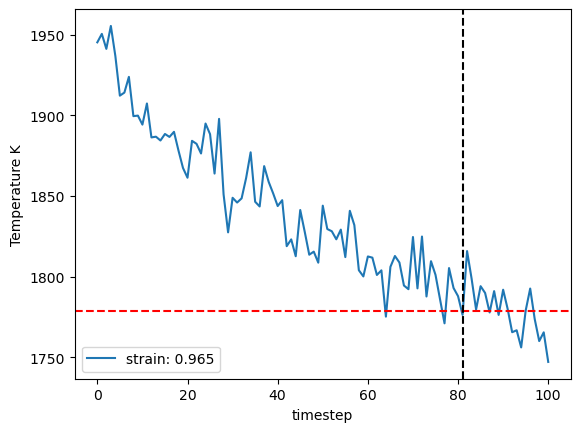

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


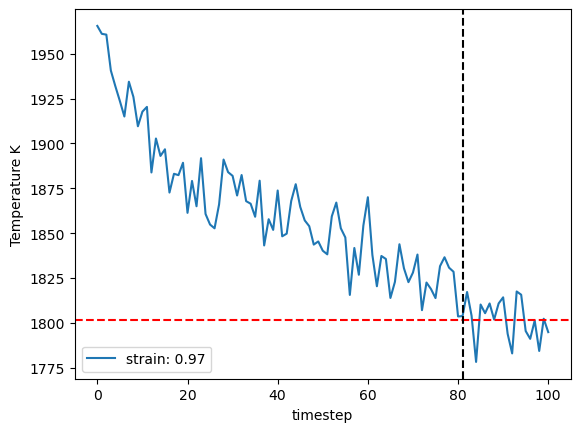

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


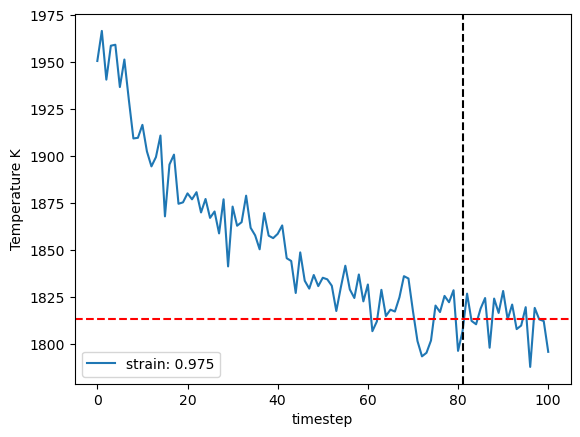

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


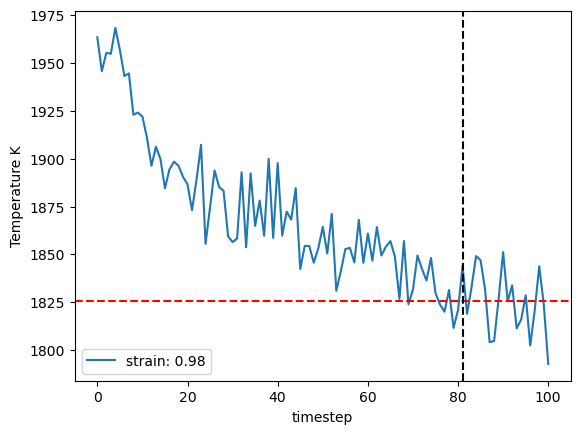

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


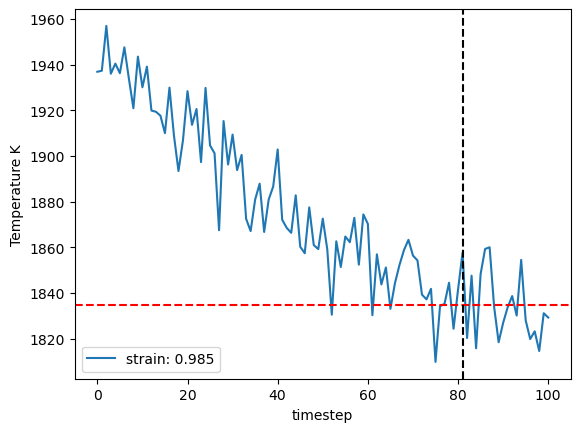

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


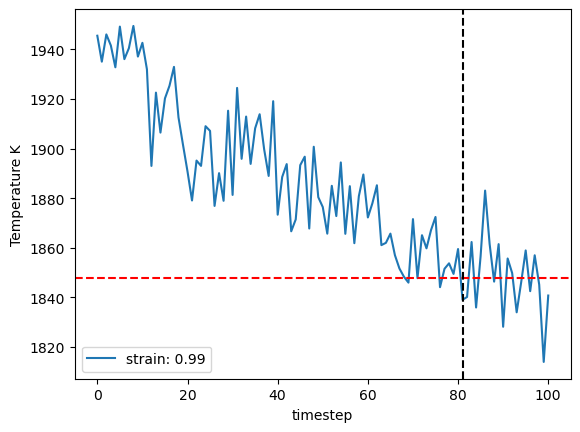

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


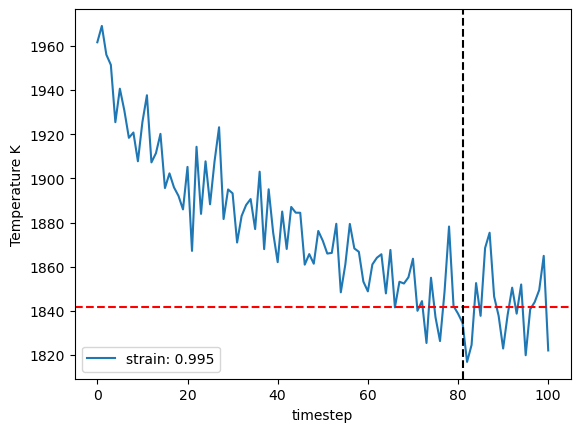

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


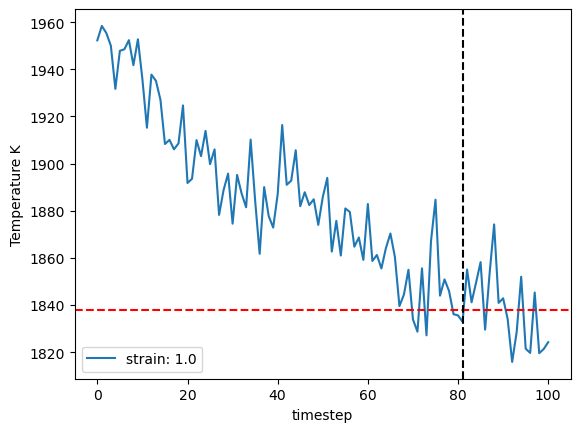

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


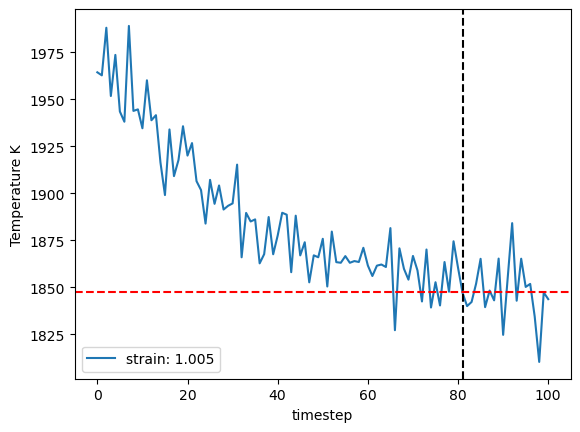

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


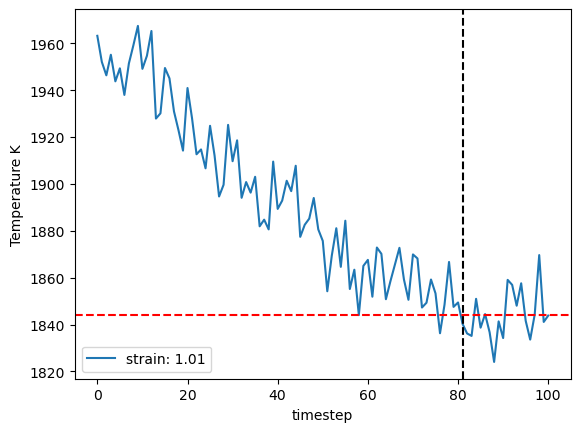

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


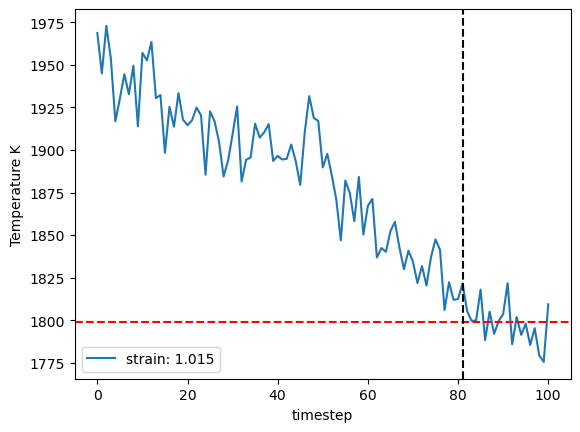

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


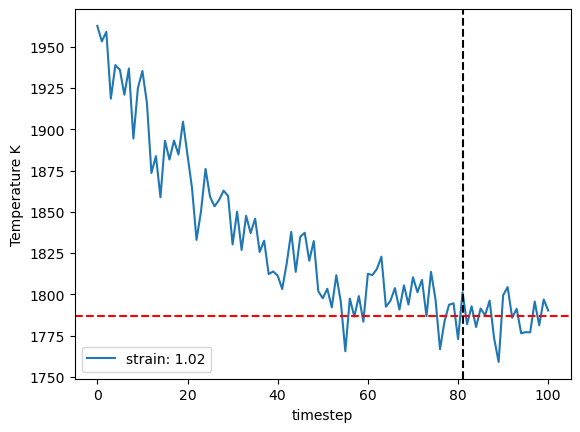

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


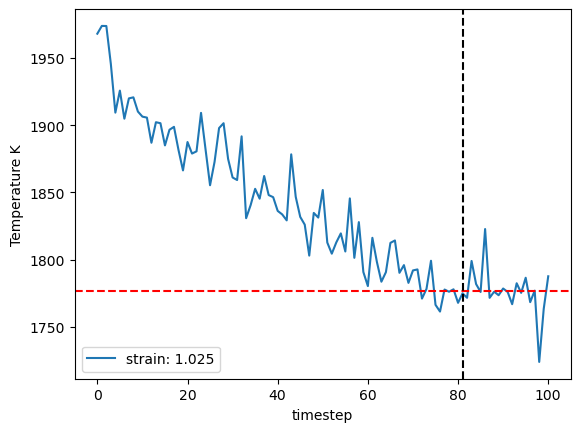

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


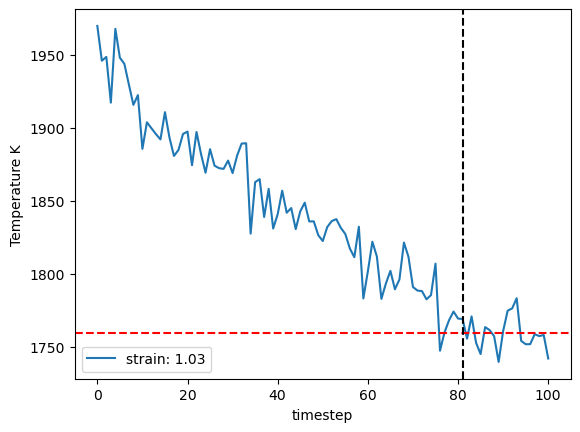

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


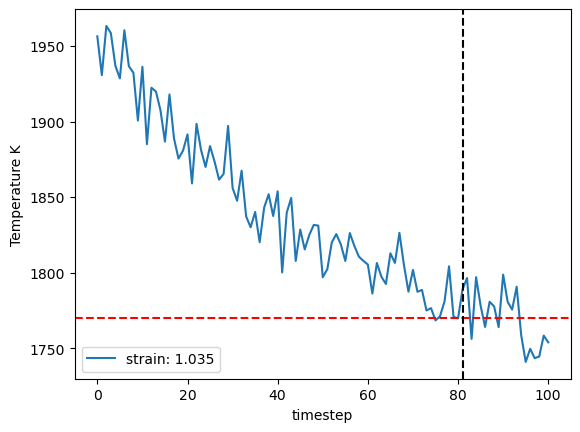

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


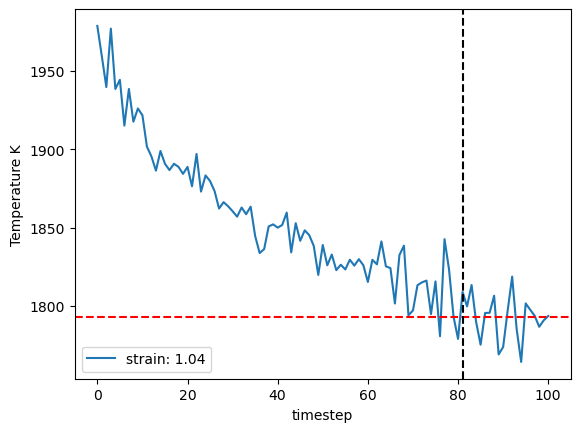

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


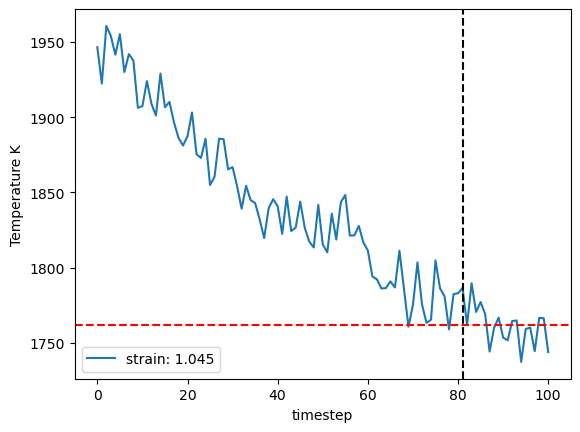

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


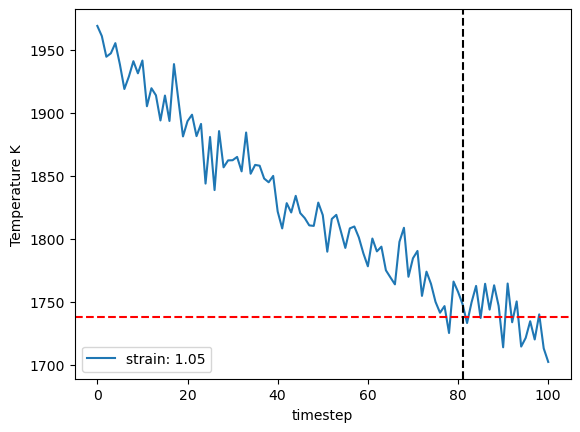

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


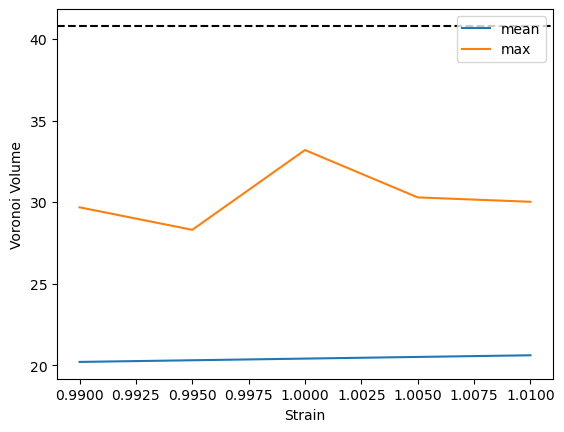

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


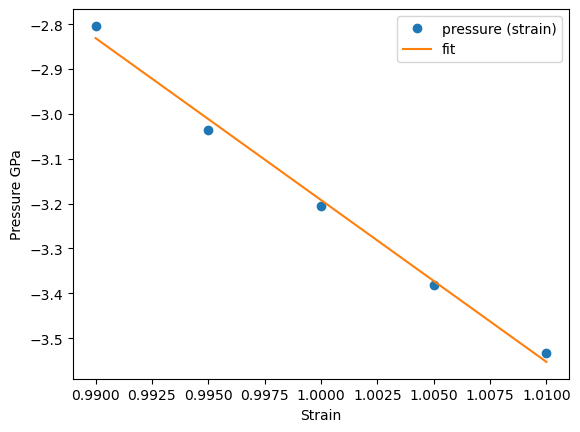

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


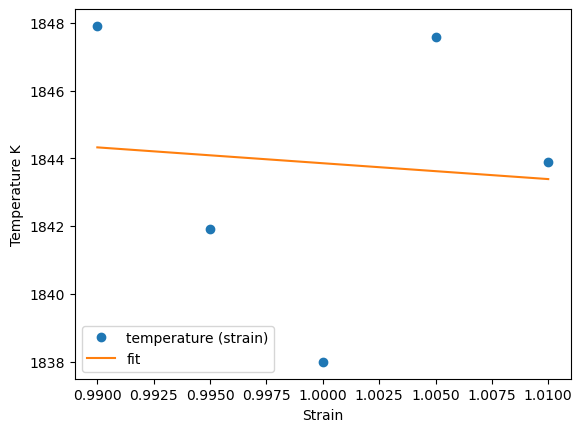

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


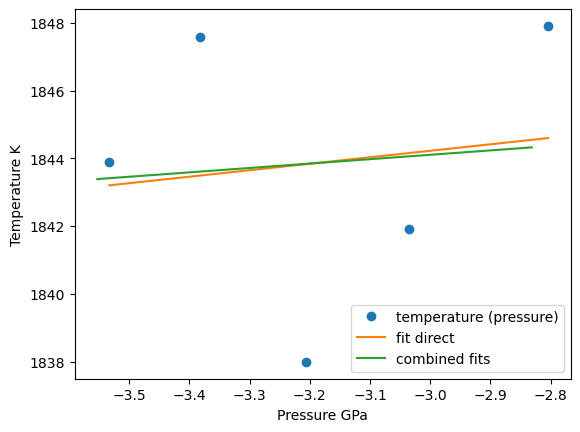

1849.9678086355552 1847.9977939607054
1849.9678086355552 1842.9496457789578 1840.4690532696036 1845.430238288312
{'timestep': 2, 'fit_range': 0.05, 'nve_run_time_steps': 25000, 'boundary_value': 0.25, 'ratio_boundary': 0.25, 'temperature_next': 1849.9678086355552, 'center': 0.91}


The job ham_npt_solid_1849_97 was saved and received the ID: 1004


The job ham_npt_liquid_high_2849_9700000000003 was saved and received the ID: 1005


The job ham_npt_liquid_low_1849_97 was saved and received the ID: 1006


2023-07-03 19:13:59,780 - pyiron_log - WARNING - Job 'ham_nve_0_86_1849_97_0' does not exist and cannot be loaded


The job ham_nvt_0_86_1849_97_0 was saved and received the ID: 1007


2023-07-03 19:14:52,513 - pyiron_log - WARNING - Job 'ham_nve_0_865_1849_97_0' does not exist and cannot be loaded


The job ham_nvt_0_865_1849_97_0 was saved and received the ID: 1008


2023-07-03 19:15:44,279 - pyiron_log - WARNING - Job 'ham_nve_0_87_1849_97_0' does not exist and cannot be loaded


The job ham_nvt_0_87_1849_97_0 was saved and received the ID: 1009


2023-07-03 19:16:35,448 - pyiron_log - WARNING - Job 'ham_nve_0_875_1849_97_0' does not exist and cannot be loaded


The job ham_nvt_0_875_1849_97_0 was saved and received the ID: 1010


2023-07-03 19:17:26,323 - pyiron_log - WARNING - Job 'ham_nve_0_88_1849_97_0' does not exist and cannot be loaded


The job ham_nvt_0_88_1849_97_0 was saved and received the ID: 1011


2023-07-03 19:18:16,801 - pyiron_log - WARNING - Job 'ham_nve_0_885_1849_97_0' does not exist and cannot be loaded


The job ham_nvt_0_885_1849_97_0 was saved and received the ID: 1012


2023-07-03 19:19:06,386 - pyiron_log - WARNING - Job 'ham_nve_0_89_1849_97_0' does not exist and cannot be loaded


The job ham_nvt_0_89_1849_97_0 was saved and received the ID: 1013


2023-07-03 19:19:52,748 - pyiron_log - WARNING - Job 'ham_nve_0_895_1849_97_0' does not exist and cannot be loaded


The job ham_nvt_0_895_1849_97_0 was saved and received the ID: 1014


2023-07-03 19:20:39,715 - pyiron_log - WARNING - Job 'ham_nve_0_9_1849_97_0' does not exist and cannot be loaded


The job ham_nvt_0_9_1849_97_0 was saved and received the ID: 1015


2023-07-03 19:21:26,430 - pyiron_log - WARNING - Job 'ham_nve_0_905_1849_97_0' does not exist and cannot be loaded


The job ham_nvt_0_905_1849_97_0 was saved and received the ID: 1016


2023-07-03 19:22:14,631 - pyiron_log - WARNING - Job 'ham_nve_0_91_1849_97_0' does not exist and cannot be loaded


The job ham_nvt_0_91_1849_97_0 was saved and received the ID: 1017


2023-07-03 19:23:00,252 - pyiron_log - WARNING - Job 'ham_nve_0_915_1849_97_0' does not exist and cannot be loaded


The job ham_nvt_0_915_1849_97_0 was saved and received the ID: 1018


2023-07-03 19:23:45,707 - pyiron_log - WARNING - Job 'ham_nve_0_92_1849_97_0' does not exist and cannot be loaded


The job ham_nvt_0_92_1849_97_0 was saved and received the ID: 1019


2023-07-03 19:24:32,406 - pyiron_log - WARNING - Job 'ham_nve_0_925_1849_97_0' does not exist and cannot be loaded


The job ham_nvt_0_925_1849_97_0 was saved and received the ID: 1020


2023-07-03 19:25:16,950 - pyiron_log - WARNING - Job 'ham_nve_0_93_1849_97_0' does not exist and cannot be loaded


The job ham_nvt_0_93_1849_97_0 was saved and received the ID: 1021


2023-07-03 19:26:01,197 - pyiron_log - WARNING - Job 'ham_nve_0_935_1849_97_0' does not exist and cannot be loaded


The job ham_nvt_0_935_1849_97_0 was saved and received the ID: 1022


2023-07-03 19:26:44,964 - pyiron_log - WARNING - Job 'ham_nve_0_94_1849_97_0' does not exist and cannot be loaded


The job ham_nvt_0_94_1849_97_0 was saved and received the ID: 1023


2023-07-03 19:27:28,472 - pyiron_log - WARNING - Job 'ham_nve_0_945_1849_97_0' does not exist and cannot be loaded


The job ham_nvt_0_945_1849_97_0 was saved and received the ID: 1024


2023-07-03 19:28:11,399 - pyiron_log - WARNING - Job 'ham_nve_0_95_1849_97_0' does not exist and cannot be loaded


The job ham_nvt_0_95_1849_97_0 was saved and received the ID: 1025


2023-07-03 19:28:58,131 - pyiron_log - WARNING - Job 'ham_nve_0_955_1849_97_0' does not exist and cannot be loaded


The job ham_nvt_0_955_1849_97_0 was saved and received the ID: 1026


2023-07-03 19:29:39,861 - pyiron_log - WARNING - Job 'ham_nve_0_96_1849_97_0' does not exist and cannot be loaded


The job ham_nvt_0_96_1849_97_0 was saved and received the ID: 1027


The job ham_nve_0_86_1849_97_0 was saved and received the ID: 1028


The job ham_nve_0_865_1849_97_0 was saved and received the ID: 1029


The job ham_nve_0_87_1849_97_0 was saved and received the ID: 1030


The job ham_nve_0_875_1849_97_0 was saved and received the ID: 1031


The job ham_nve_0_88_1849_97_0 was saved and received the ID: 1032


The job ham_nve_0_885_1849_97_0 was saved and received the ID: 1033


The job ham_nve_0_89_1849_97_0 was saved and received the ID: 1034


The job ham_nve_0_895_1849_97_0 was saved and received the ID: 1035


The job ham_nve_0_9_1849_97_0 was saved and received the ID: 1036


The job ham_nve_0_905_1849_97_0 was saved and received the ID: 1037


The job ham_nve_0_91_1849_97_0 was saved and received the ID: 1038


The job ham_nve_0_915_1849_97_0 was saved and received the ID: 1039


The job ham_nve_0_92_1849_97_0 was saved and received the ID: 1040


The job ham_nve_0_925_1849_97_0 was saved and received the ID: 1041


The job ham_nve_0_93_1849_97_0 was saved and received the ID: 1042


The job ham_nve_0_935_1849_97_0 was saved and received the ID: 1043


The job ham_nve_0_94_1849_97_0 was saved and received the ID: 1044


The job ham_nve_0_945_1849_97_0 was saved and received the ID: 1045


The job ham_nve_0_95_1849_97_0 was saved and received the ID: 1046


The job ham_nve_0_955_1849_97_0 was saved and received the ID: 1047


The job ham_nve_0_96_1849_97_0 was saved and received the ID: 1048


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


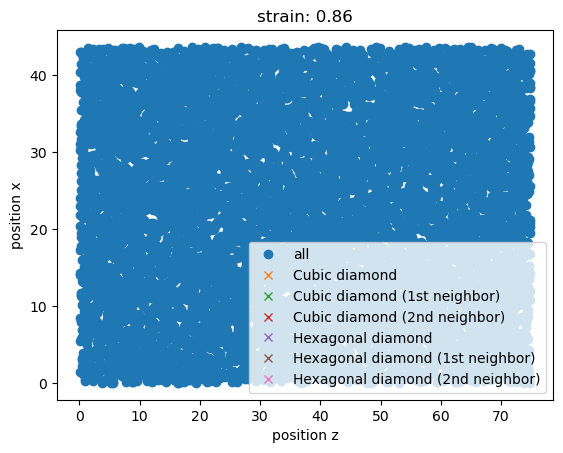

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


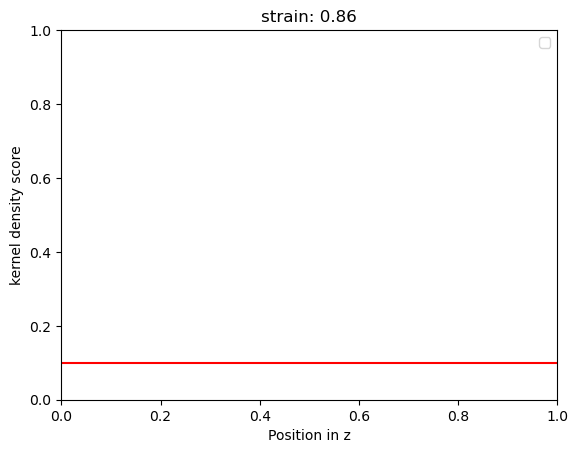

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


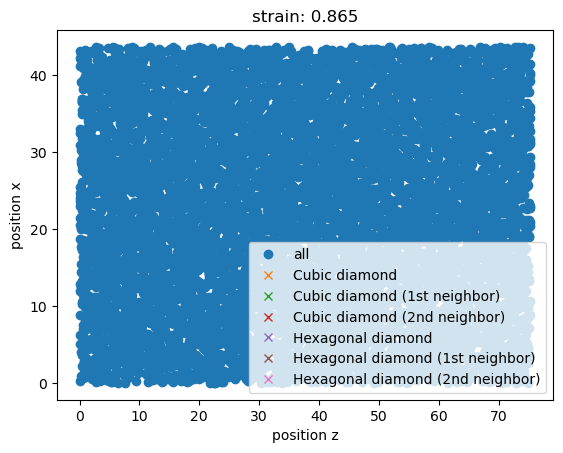

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


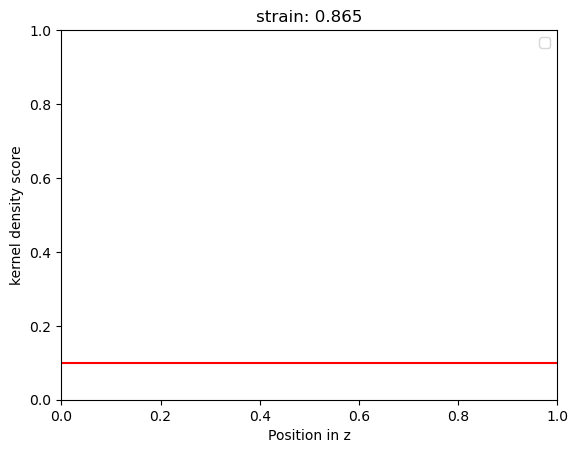

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


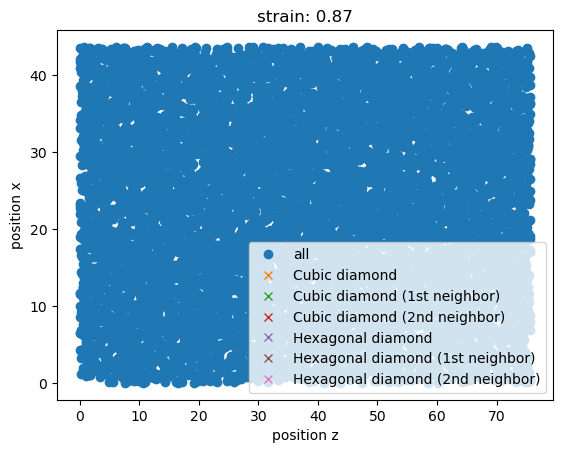

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


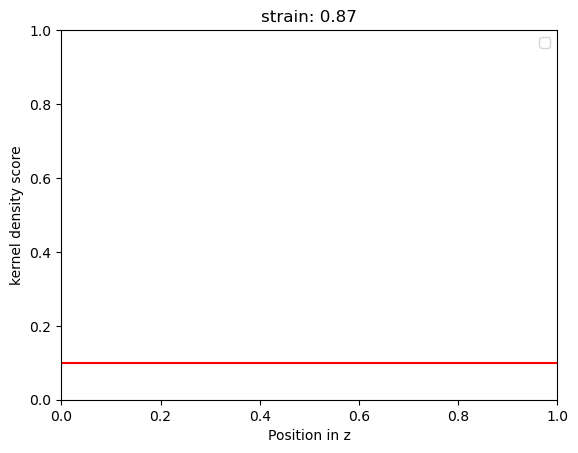

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


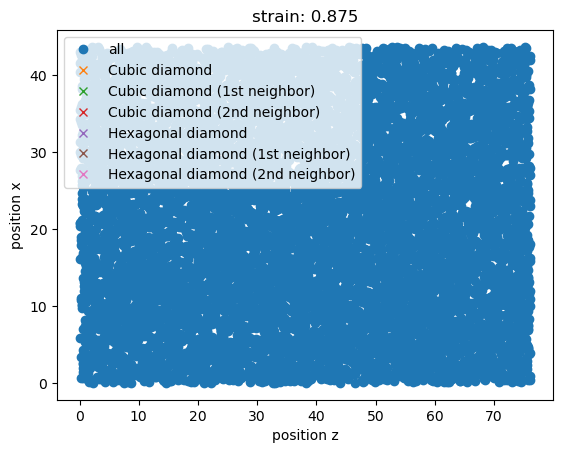

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


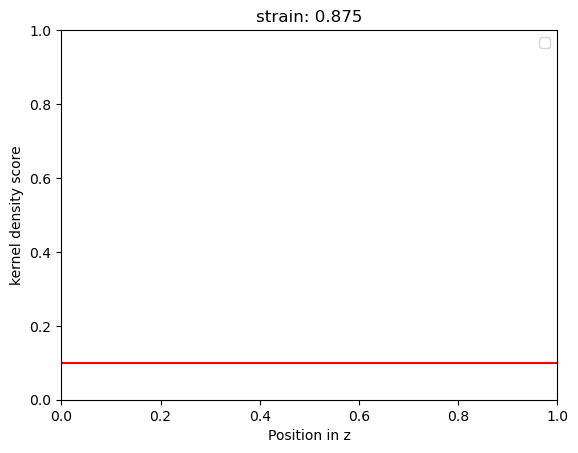

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


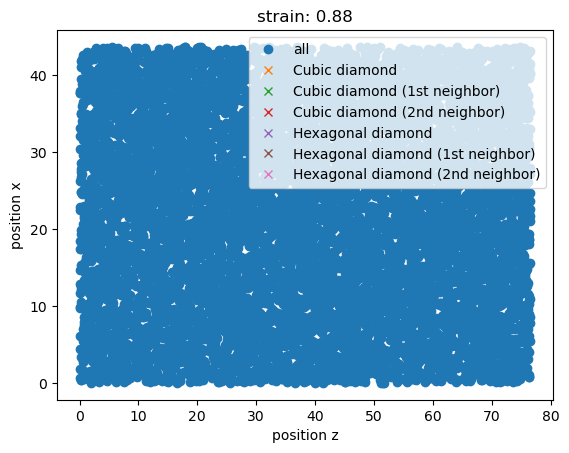

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


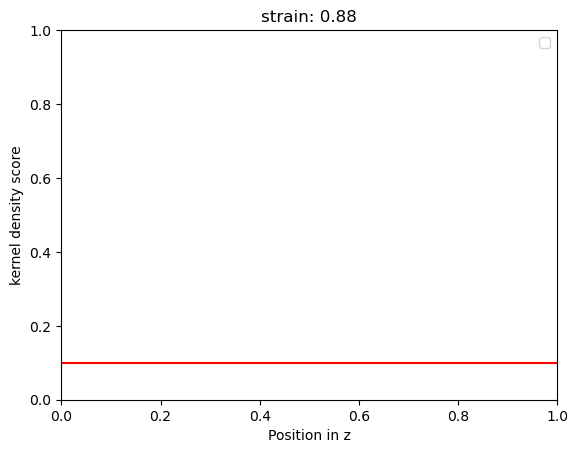

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


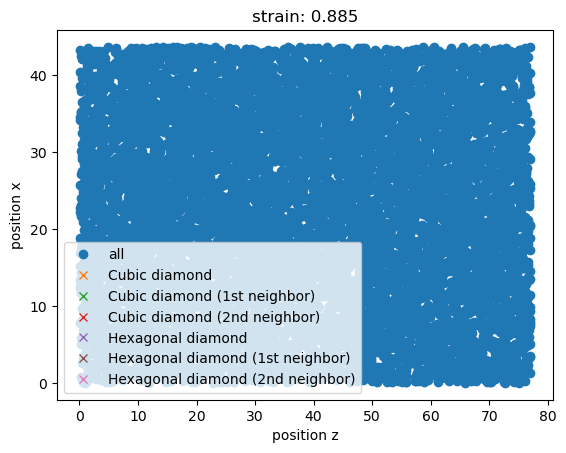

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


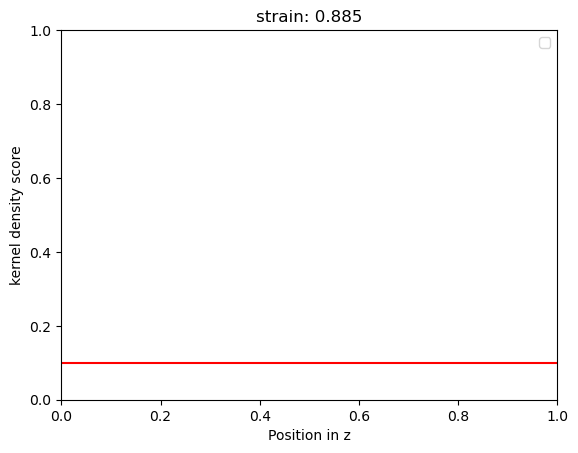

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


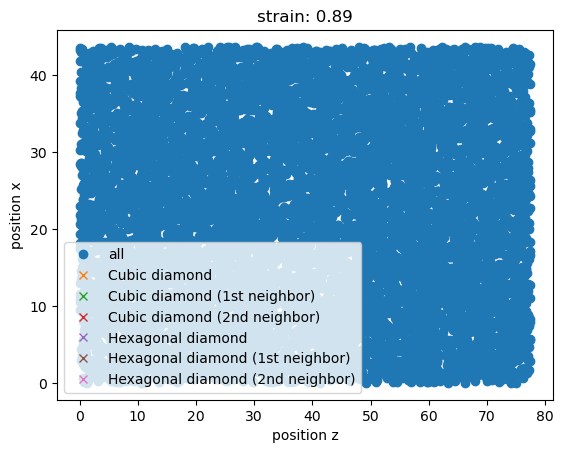

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


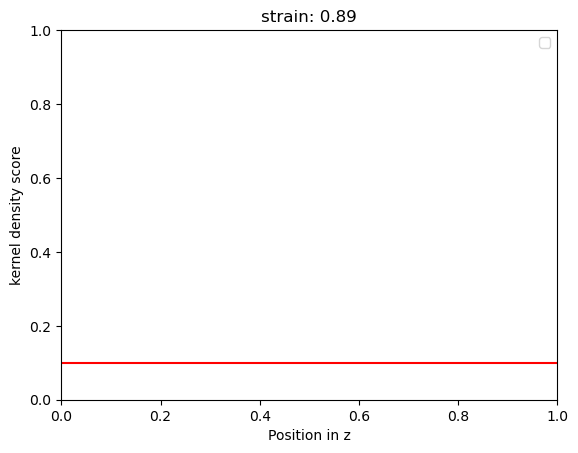

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


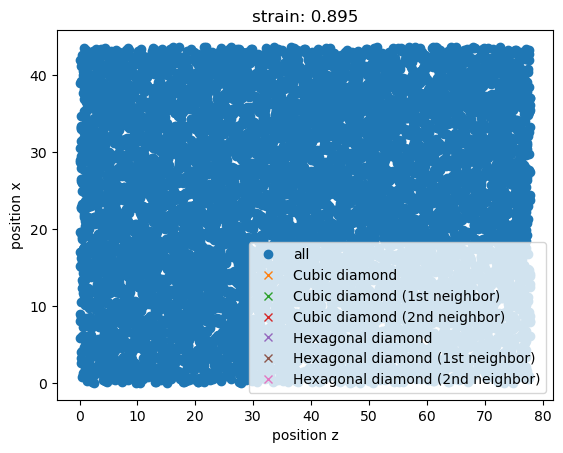

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


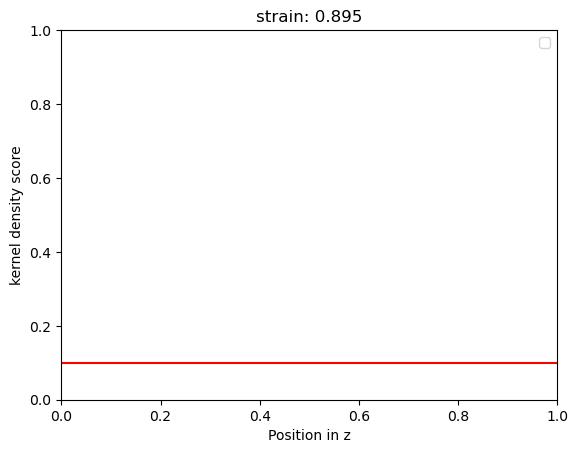

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


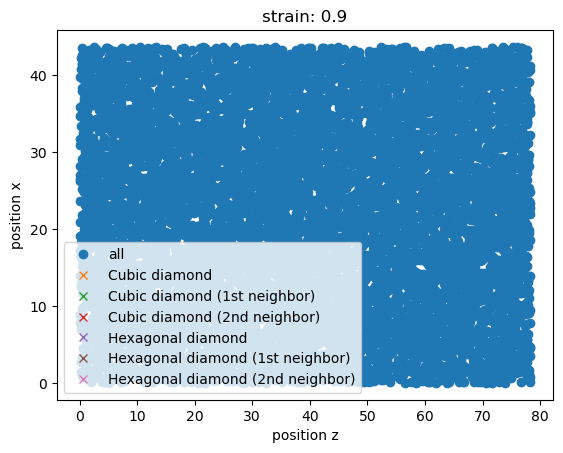

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


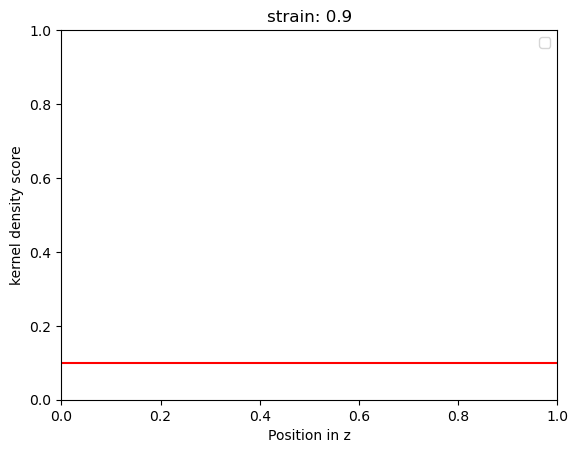

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


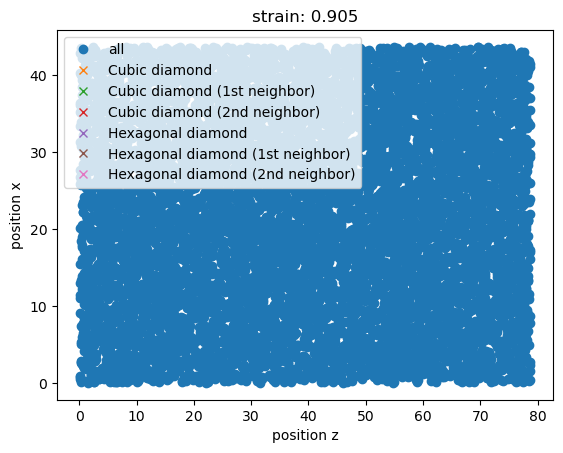

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


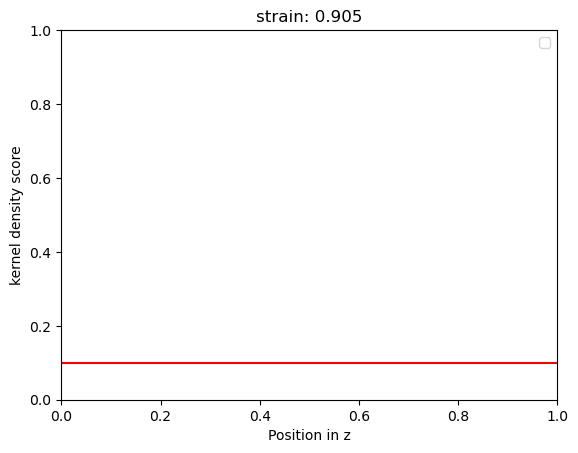

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


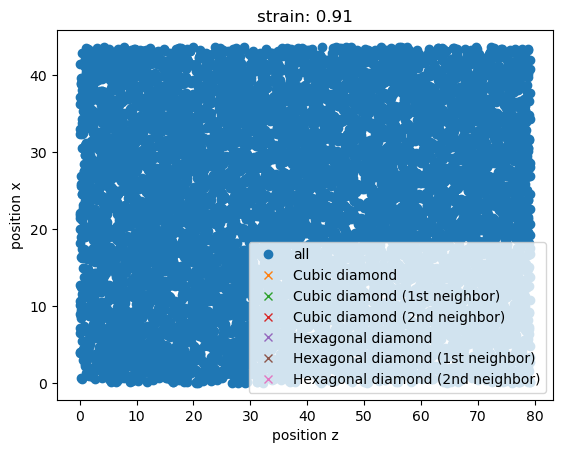

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


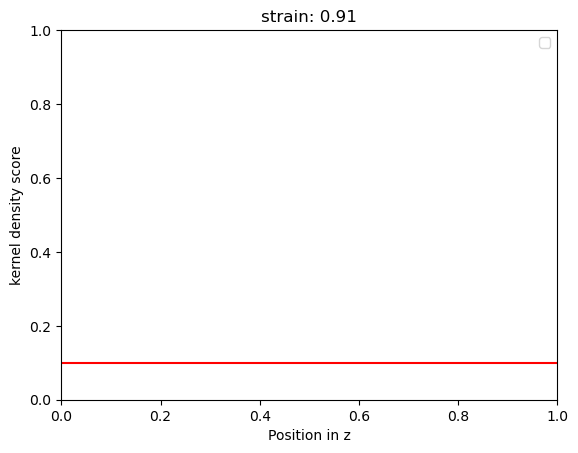

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


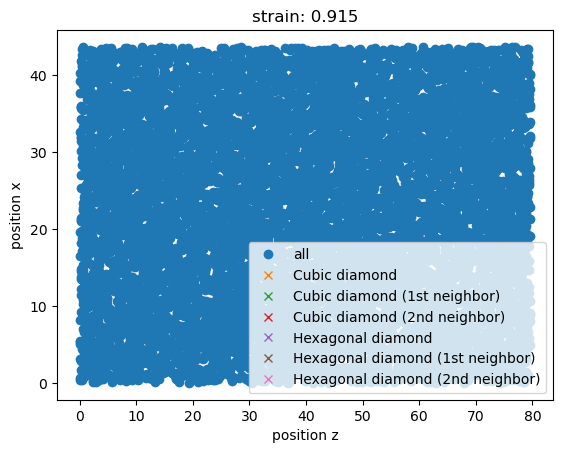

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


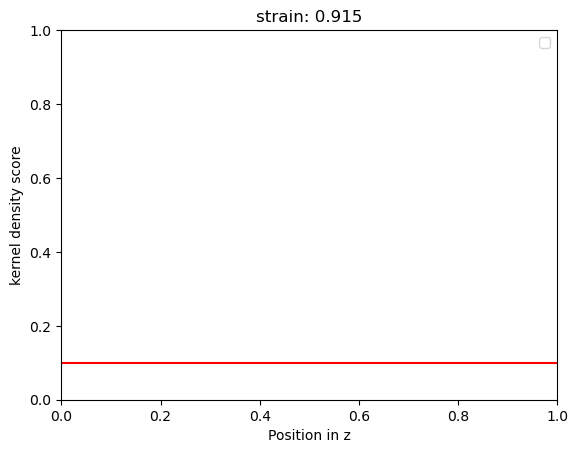

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


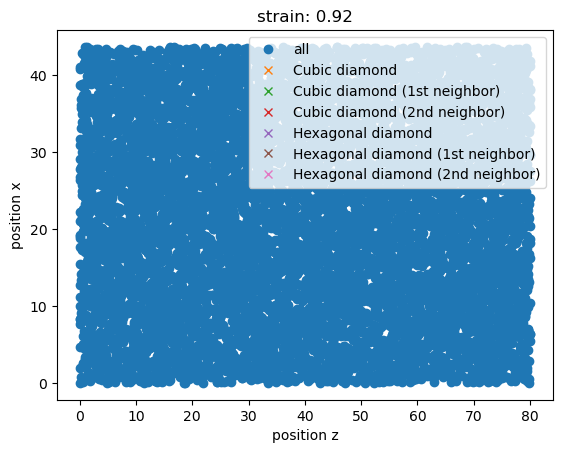

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


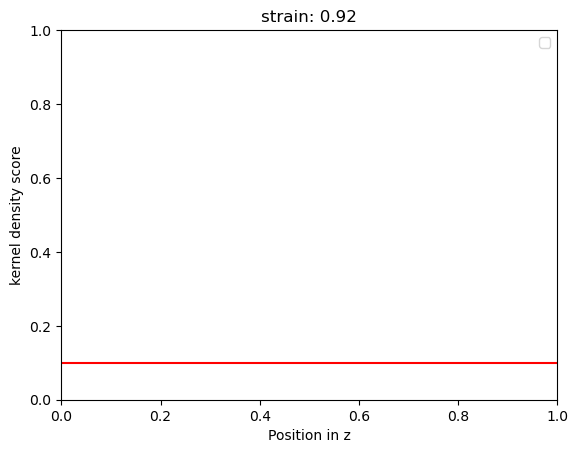

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


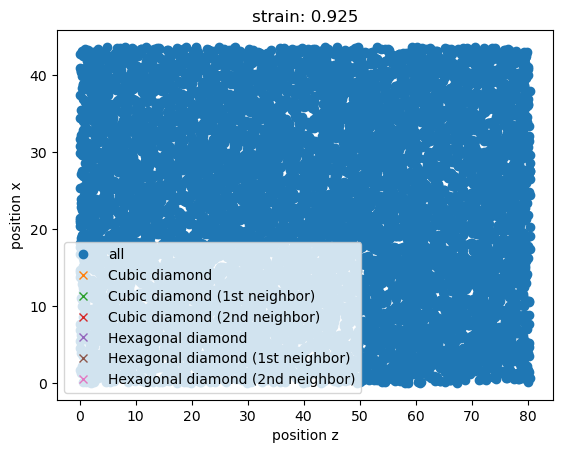

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


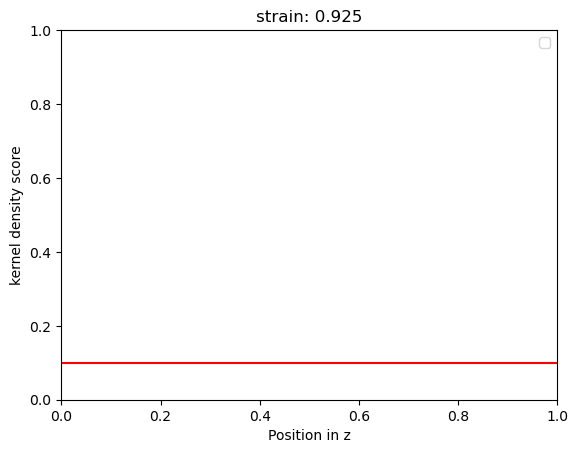

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


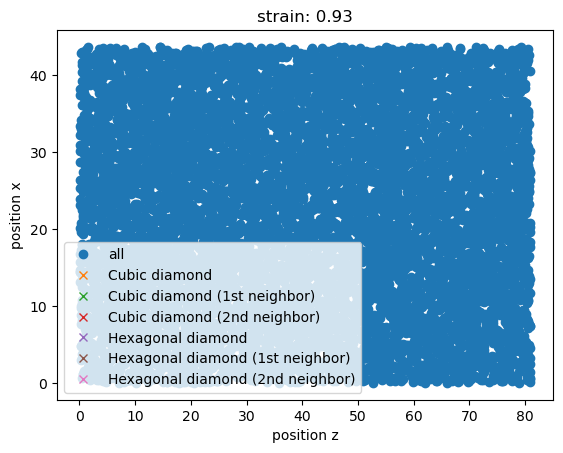

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


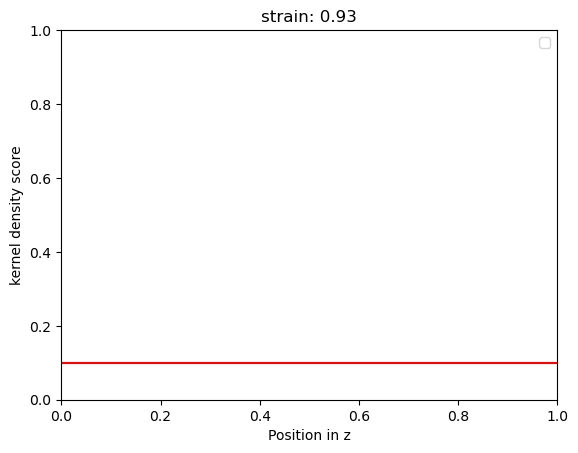

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


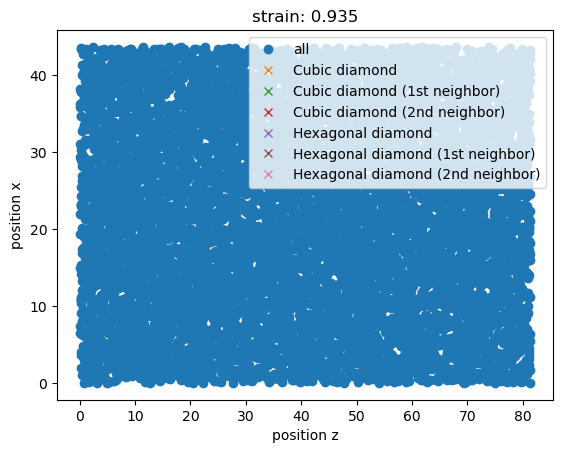

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


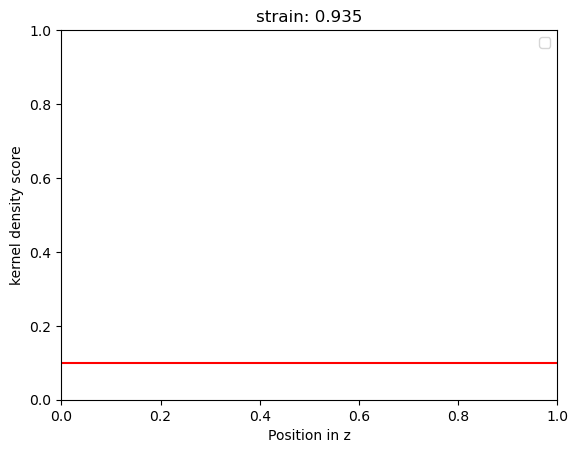

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


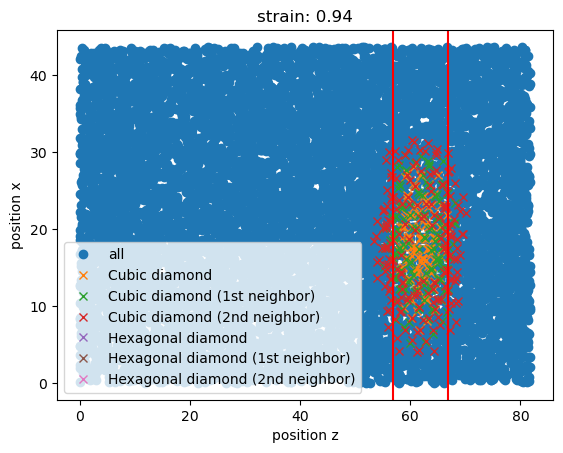

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


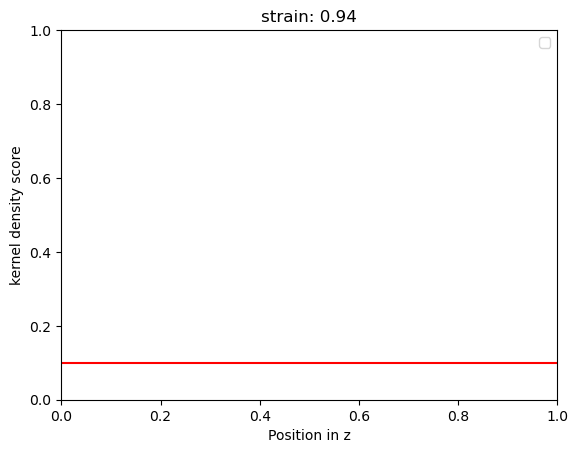

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


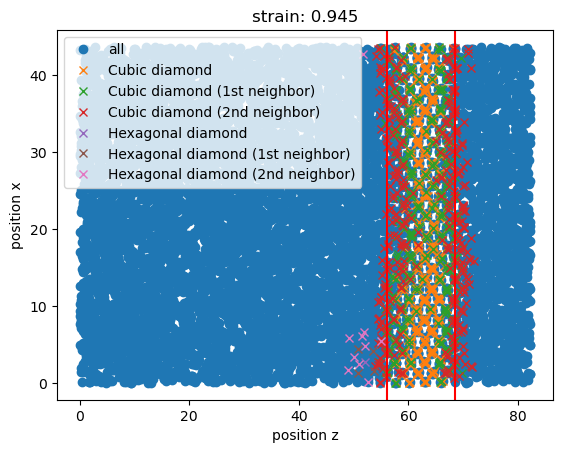

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


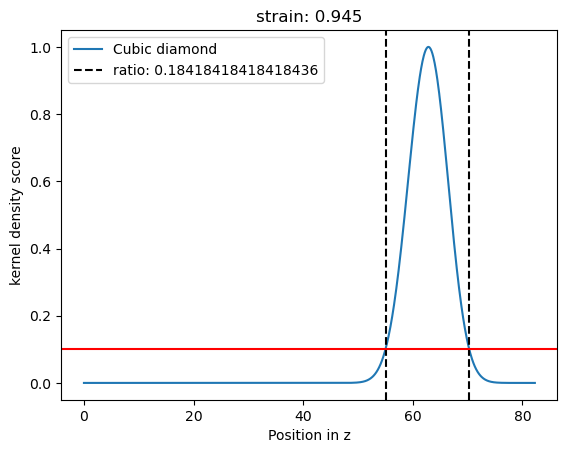

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


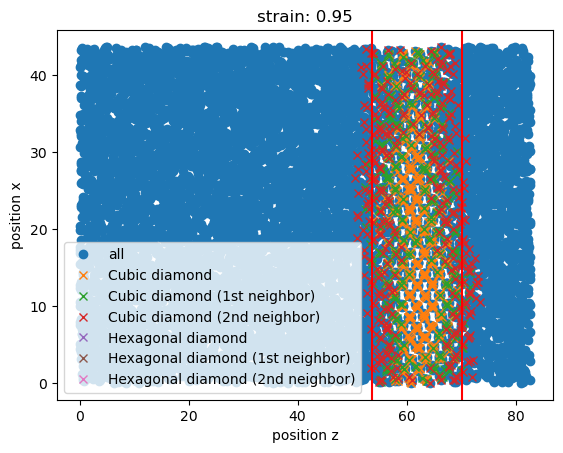

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


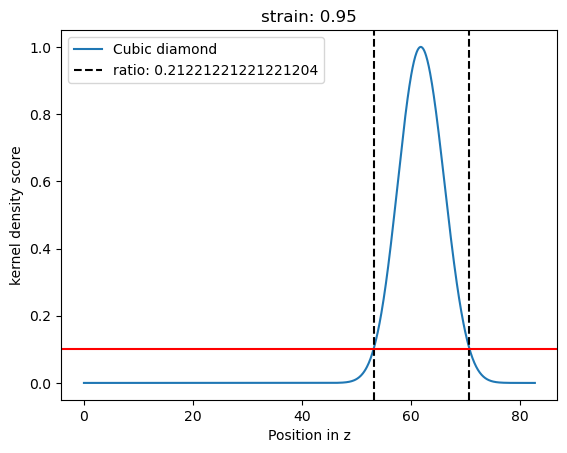

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


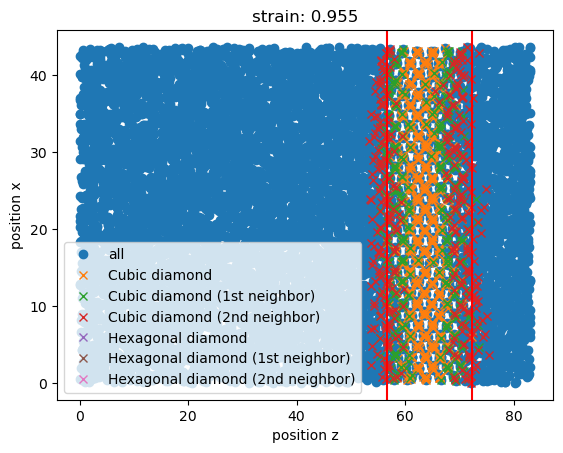

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


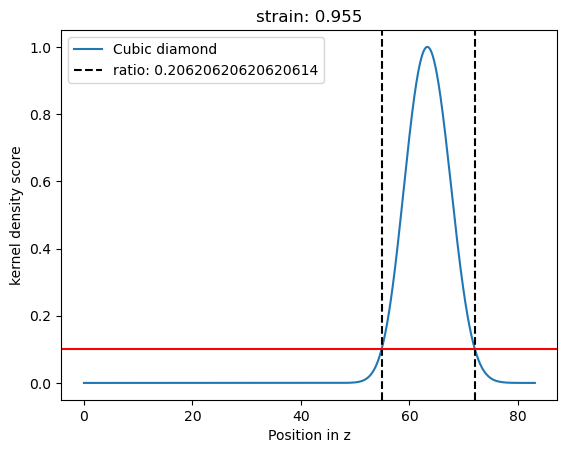

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


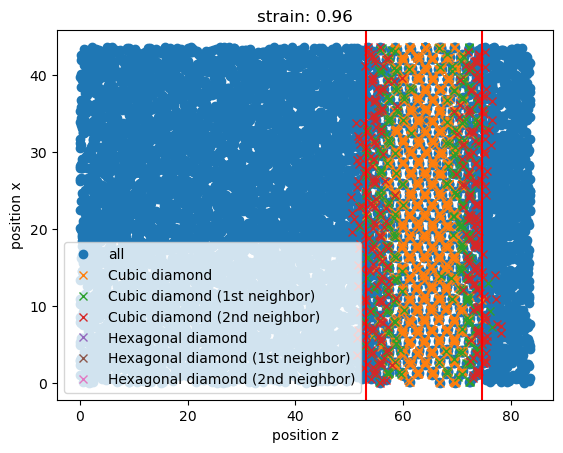

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


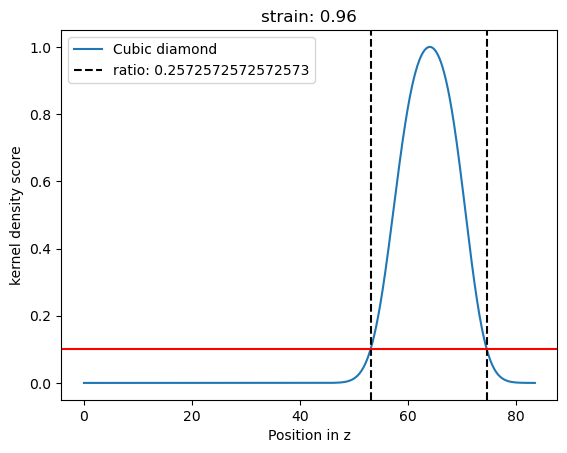

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


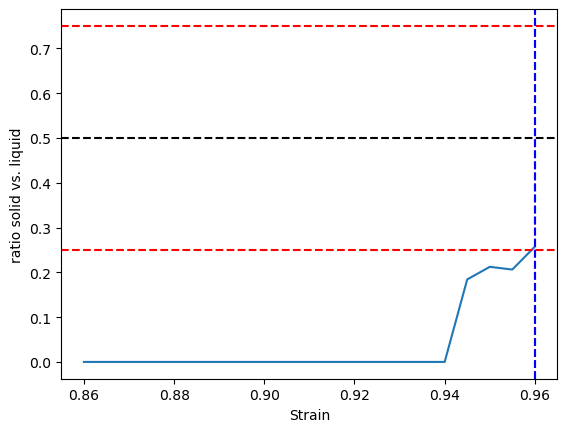

/scratch/janssen/pyiron_meltingpoint/.snakemake/conda/810a48ff96828b631d3deb6ed8757de2_/lib/python3.10/site-packages/pyiron_atomistics/thermodynamics/interfacemethod.py:1388: RankWarning: Polyfit may be poorly conditioned
  get_center_point(


1664.973 0.0 0.0 0.0
{'timestep': 2, 'fit_range': 0.05, 'nve_run_time_steps': 25000, 'boundary_value': 0.25, 'ratio_boundary': 0.25, 'temperature_next': 1664.973, 'center': 0.96}


The job ham_npt_solid_1664_97 was saved and received the ID: 1049


The job ham_npt_liquid_high_2664_9700000000003 was saved and received the ID: 1050


The job ham_npt_liquid_low_1664_97 was saved and received the ID: 1051


2023-07-03 20:17:49,305 - pyiron_log - WARNING - Job 'ham_nve_0_91_1664_97_0' does not exist and cannot be loaded


The job ham_nvt_0_91_1664_97_0 was saved and received the ID: 1052


2023-07-03 20:18:36,237 - pyiron_log - WARNING - Job 'ham_nve_0_915_1664_97_0' does not exist and cannot be loaded


The job ham_nvt_0_915_1664_97_0 was saved and received the ID: 1053


2023-07-03 20:19:23,381 - pyiron_log - WARNING - Job 'ham_nve_0_92_1664_97_0' does not exist and cannot be loaded


The job ham_nvt_0_92_1664_97_0 was saved and received the ID: 1054


2023-07-03 20:20:09,448 - pyiron_log - WARNING - Job 'ham_nve_0_925_1664_97_0' does not exist and cannot be loaded


The job ham_nvt_0_925_1664_97_0 was saved and received the ID: 1055


2023-07-03 20:20:55,948 - pyiron_log - WARNING - Job 'ham_nve_0_93_1664_97_0' does not exist and cannot be loaded


The job ham_nvt_0_93_1664_97_0 was saved and received the ID: 1056


2023-07-03 20:21:41,479 - pyiron_log - WARNING - Job 'ham_nve_0_935_1664_97_0' does not exist and cannot be loaded


The job ham_nvt_0_935_1664_97_0 was saved and received the ID: 1057


2023-07-03 20:22:27,077 - pyiron_log - WARNING - Job 'ham_nve_0_94_1664_97_0' does not exist and cannot be loaded


The job ham_nvt_0_94_1664_97_0 was saved and received the ID: 1058


2023-07-03 20:23:12,089 - pyiron_log - WARNING - Job 'ham_nve_0_945_1664_97_0' does not exist and cannot be loaded


The job ham_nvt_0_945_1664_97_0 was saved and received the ID: 1059


2023-07-03 20:23:56,432 - pyiron_log - WARNING - Job 'ham_nve_0_95_1664_97_0' does not exist and cannot be loaded


The job ham_nvt_0_95_1664_97_0 was saved and received the ID: 1060


2023-07-03 20:24:39,941 - pyiron_log - WARNING - Job 'ham_nve_0_955_1664_97_0' does not exist and cannot be loaded


The job ham_nvt_0_955_1664_97_0 was saved and received the ID: 1061


2023-07-03 20:25:22,708 - pyiron_log - WARNING - Job 'ham_nve_0_96_1664_97_0' does not exist and cannot be loaded


The job ham_nvt_0_96_1664_97_0 was saved and received the ID: 1062


2023-07-03 20:26:04,873 - pyiron_log - WARNING - Job 'ham_nve_0_965_1664_97_0' does not exist and cannot be loaded


The job ham_nvt_0_965_1664_97_0 was saved and received the ID: 1063


2023-07-03 20:26:46,402 - pyiron_log - WARNING - Job 'ham_nve_0_97_1664_97_0' does not exist and cannot be loaded


The job ham_nvt_0_97_1664_97_0 was saved and received the ID: 1064


2023-07-03 20:27:27,539 - pyiron_log - WARNING - Job 'ham_nve_0_975_1664_97_0' does not exist and cannot be loaded


The job ham_nvt_0_975_1664_97_0 was saved and received the ID: 1065


2023-07-03 20:28:07,361 - pyiron_log - WARNING - Job 'ham_nve_0_98_1664_97_0' does not exist and cannot be loaded


The job ham_nvt_0_98_1664_97_0 was saved and received the ID: 1066


2023-07-03 20:28:46,917 - pyiron_log - WARNING - Job 'ham_nve_0_985_1664_97_0' does not exist and cannot be loaded


The job ham_nvt_0_985_1664_97_0 was saved and received the ID: 1067


2023-07-03 20:29:24,642 - pyiron_log - WARNING - Job 'ham_nve_0_99_1664_97_0' does not exist and cannot be loaded


The job ham_nvt_0_99_1664_97_0 was saved and received the ID: 1068


2023-07-03 20:30:02,067 - pyiron_log - WARNING - Job 'ham_nve_0_995_1664_97_0' does not exist and cannot be loaded


The job ham_nvt_0_995_1664_97_0 was saved and received the ID: 1069


2023-07-03 20:30:39,168 - pyiron_log - WARNING - Job 'ham_nve_1_0_1664_97_0' does not exist and cannot be loaded


The job ham_nvt_1_0_1664_97_0 was saved and received the ID: 1070


2023-07-03 20:31:15,540 - pyiron_log - WARNING - Job 'ham_nve_1_005_1664_97_0' does not exist and cannot be loaded


The job ham_nvt_1_005_1664_97_0 was saved and received the ID: 1071


2023-07-03 20:31:51,158 - pyiron_log - WARNING - Job 'ham_nve_1_01_1664_97_0' does not exist and cannot be loaded


The job ham_nvt_1_01_1664_97_0 was saved and received the ID: 1072


The job ham_nve_0_91_1664_97_0 was saved and received the ID: 1073


The job ham_nve_0_915_1664_97_0 was saved and received the ID: 1074


The job ham_nve_0_92_1664_97_0 was saved and received the ID: 1075


The job ham_nve_0_925_1664_97_0 was saved and received the ID: 1076


The job ham_nve_0_93_1664_97_0 was saved and received the ID: 1077


The job ham_nve_0_935_1664_97_0 was saved and received the ID: 1078


The job ham_nve_0_94_1664_97_0 was saved and received the ID: 1079


The job ham_nve_0_945_1664_97_0 was saved and received the ID: 1080


The job ham_nve_0_95_1664_97_0 was saved and received the ID: 1081


The job ham_nve_0_955_1664_97_0 was saved and received the ID: 1082


The job ham_nve_0_96_1664_97_0 was saved and received the ID: 1083


The job ham_nve_0_965_1664_97_0 was saved and received the ID: 1084


The job ham_nve_0_97_1664_97_0 was saved and received the ID: 1085


The job ham_nve_0_975_1664_97_0 was saved and received the ID: 1086


The job ham_nve_0_98_1664_97_0 was saved and received the ID: 1087


The job ham_nve_0_985_1664_97_0 was saved and received the ID: 1088


The job ham_nve_0_99_1664_97_0 was saved and received the ID: 1089


The job ham_nve_0_995_1664_97_0 was saved and received the ID: 1090


The job ham_nve_1_0_1664_97_0 was saved and received the ID: 1091


The job ham_nve_1_005_1664_97_0 was saved and received the ID: 1092


The job ham_nve_1_01_1664_97_0 was saved and received the ID: 1093


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


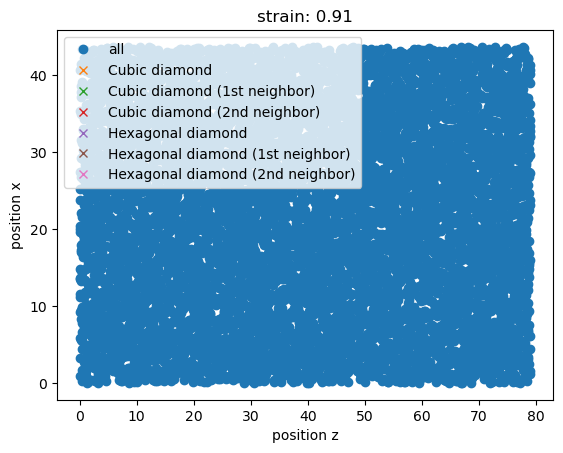

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


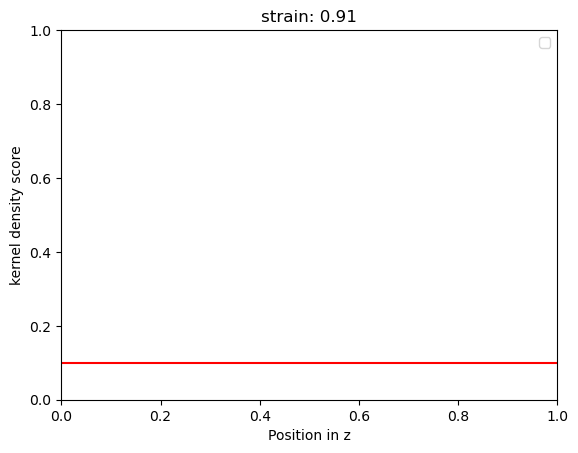

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


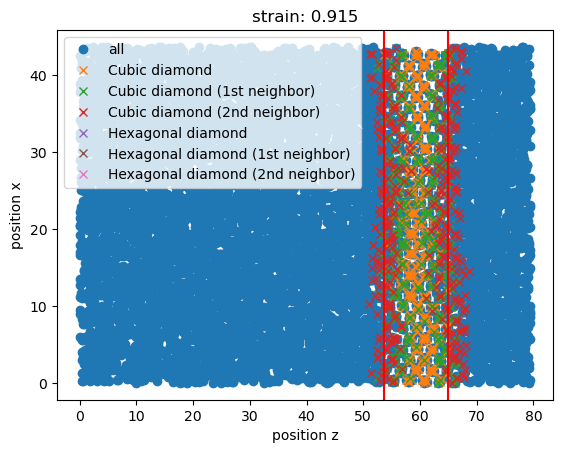

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


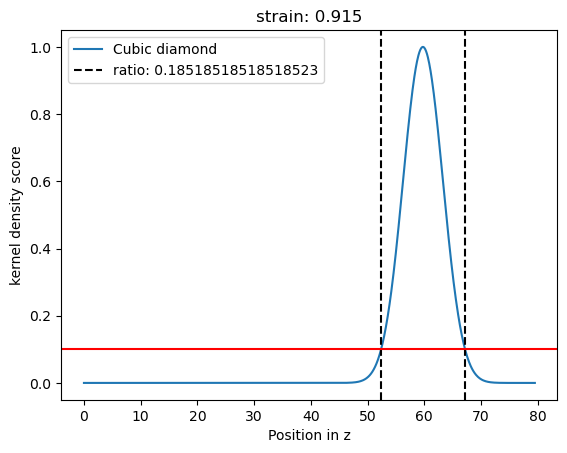

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


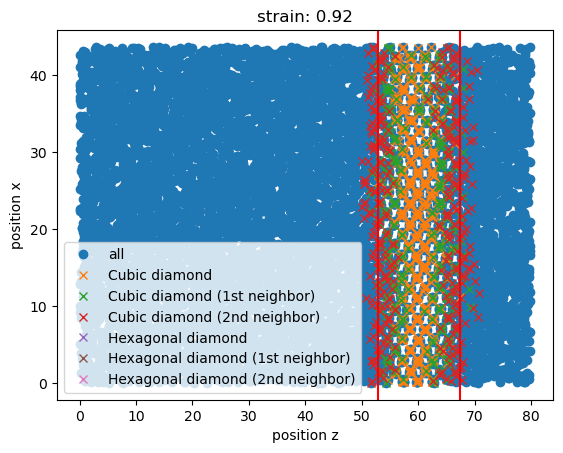

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


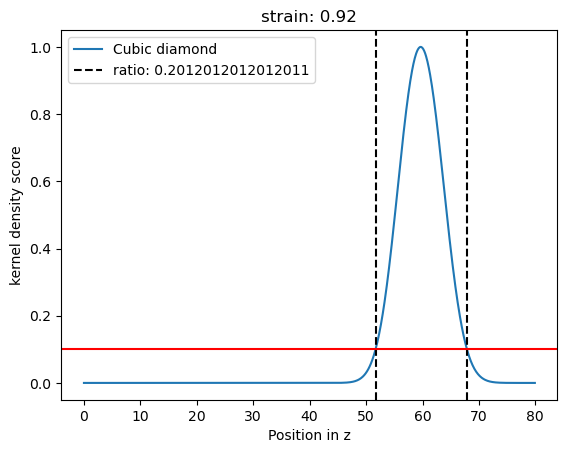

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


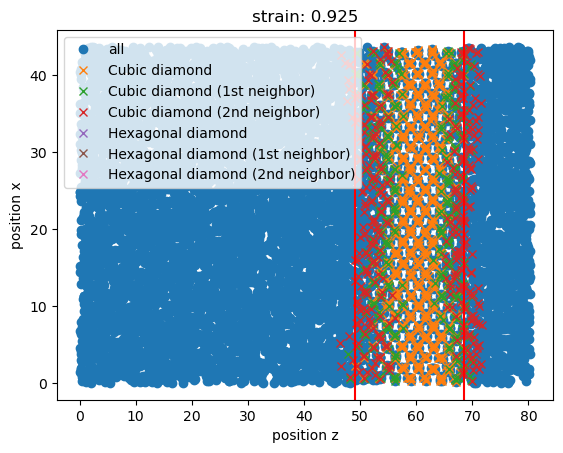

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


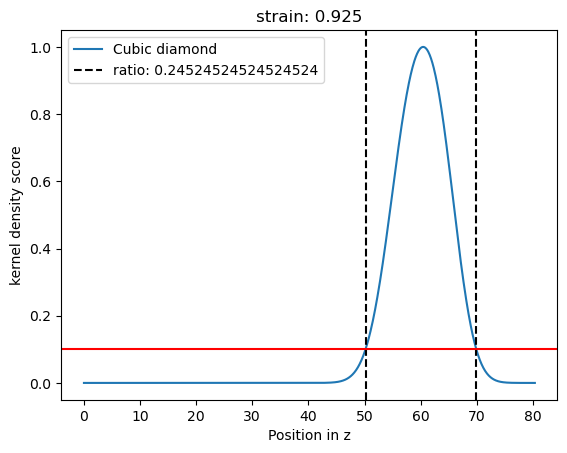

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


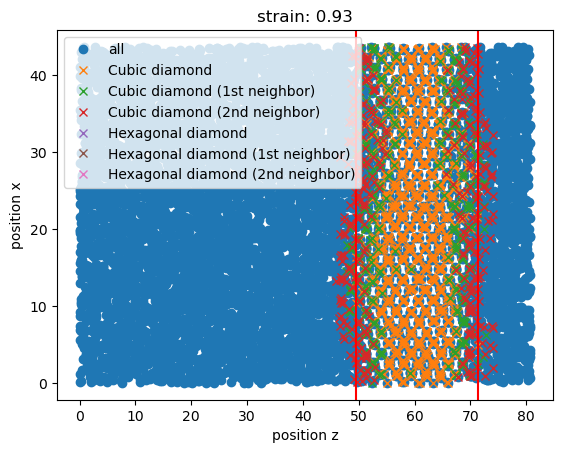

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


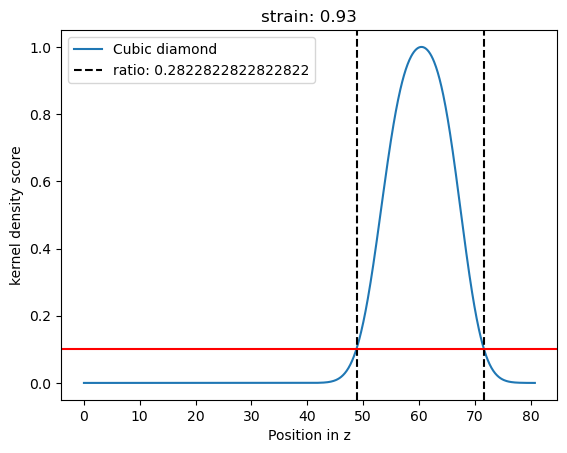

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


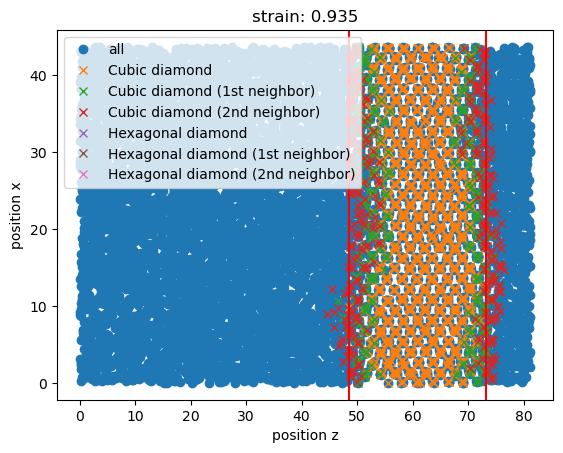

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


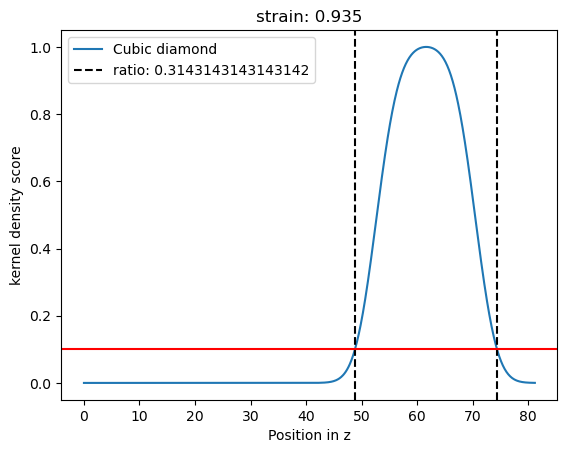

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


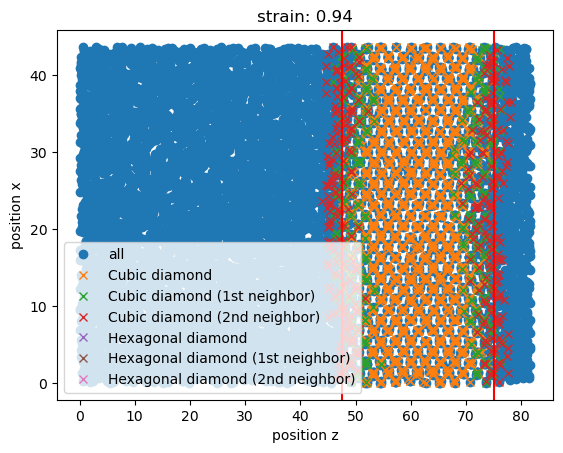

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


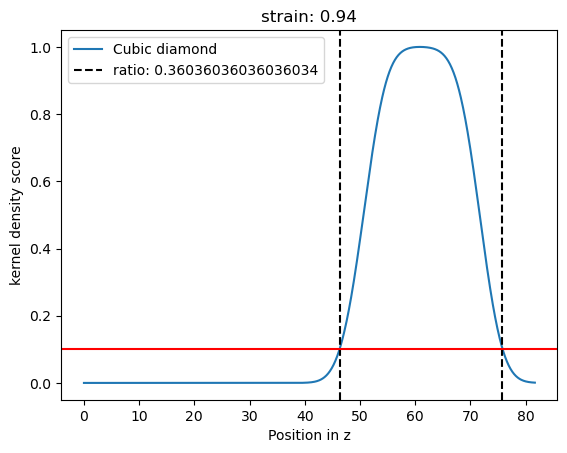

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


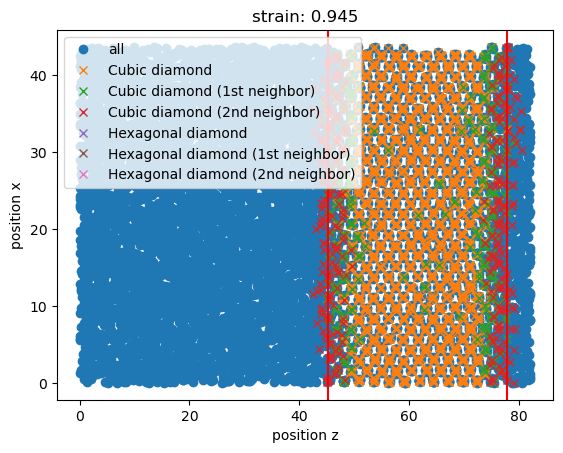

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


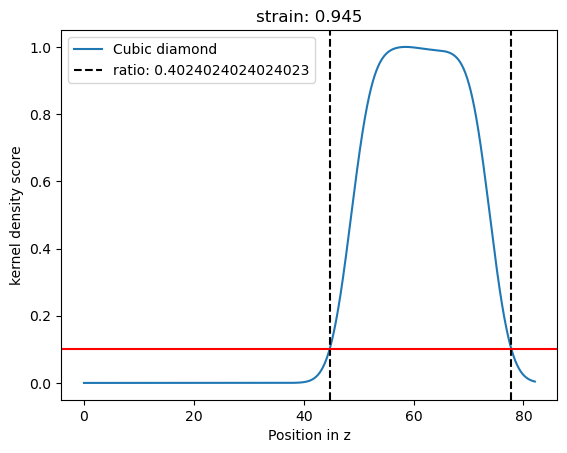

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


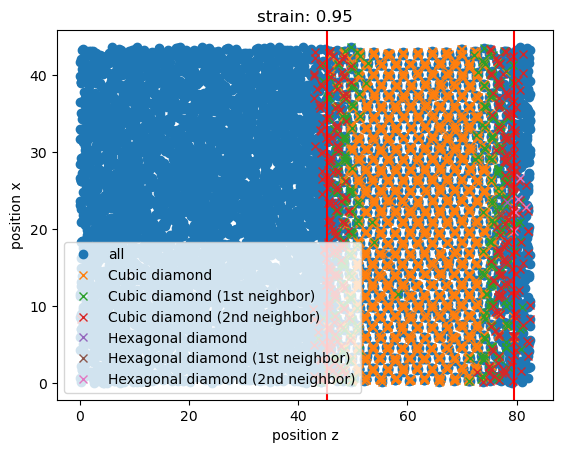

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


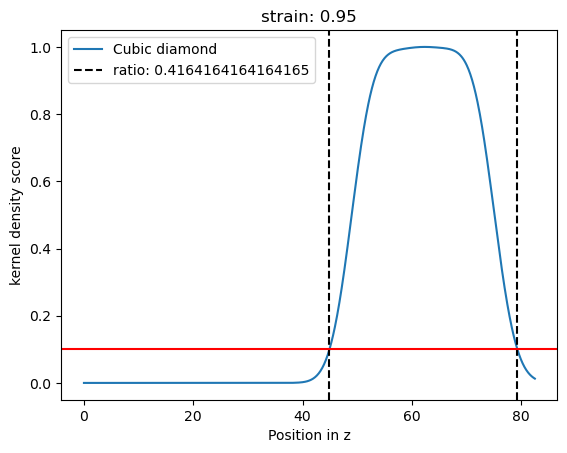

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


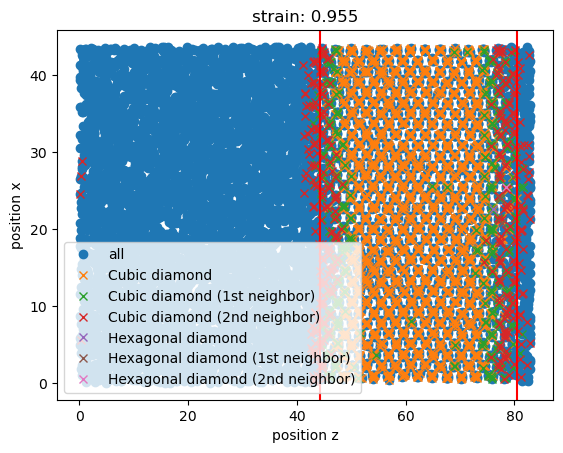

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


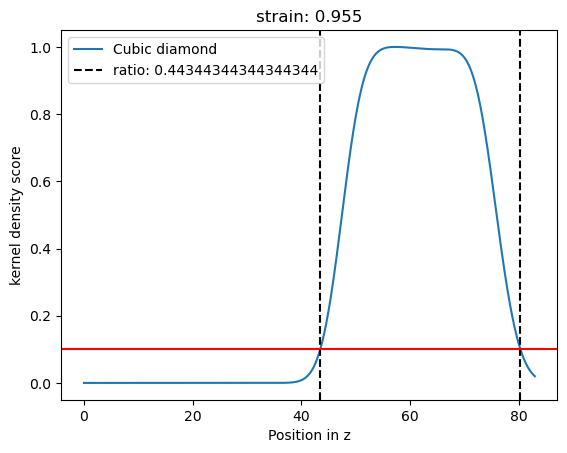

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


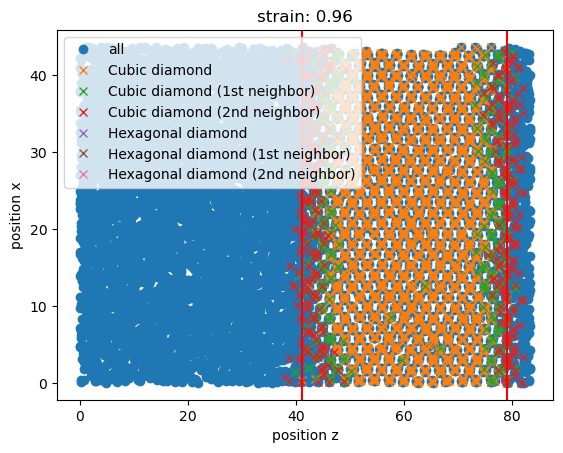

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


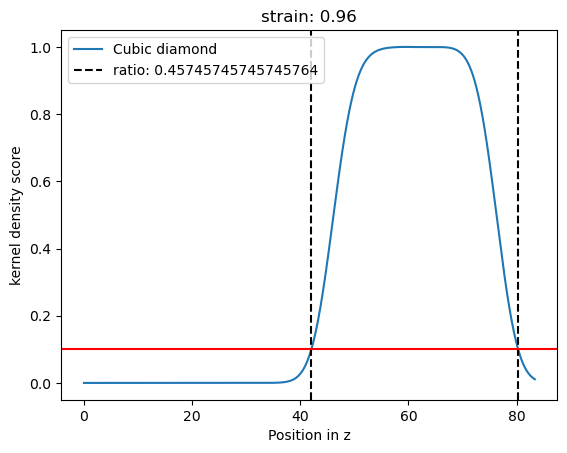

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


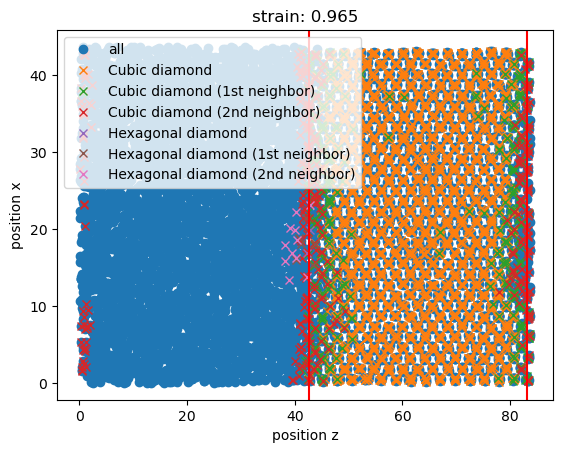

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


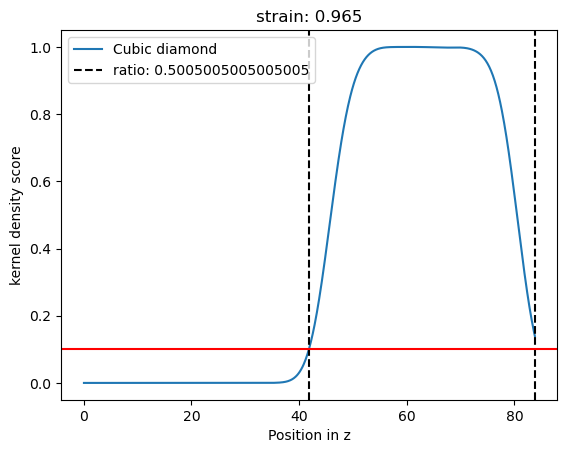

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


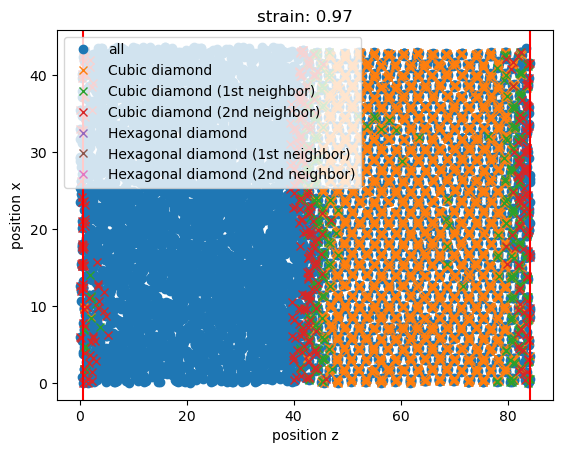

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


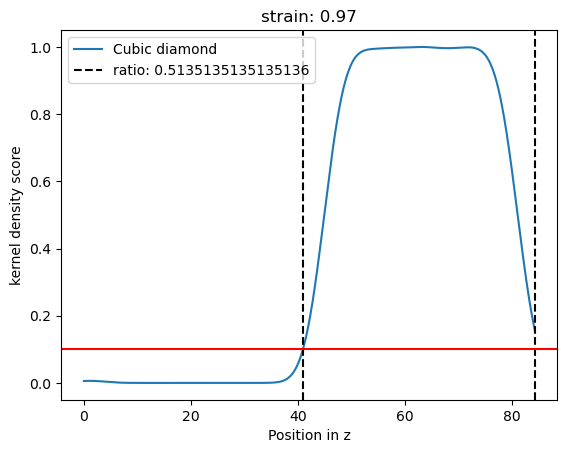

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


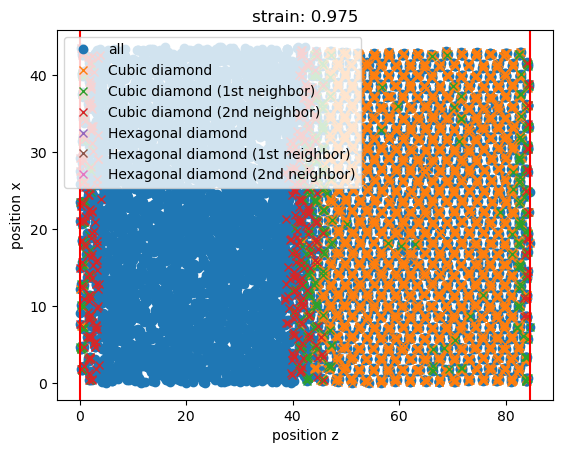

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


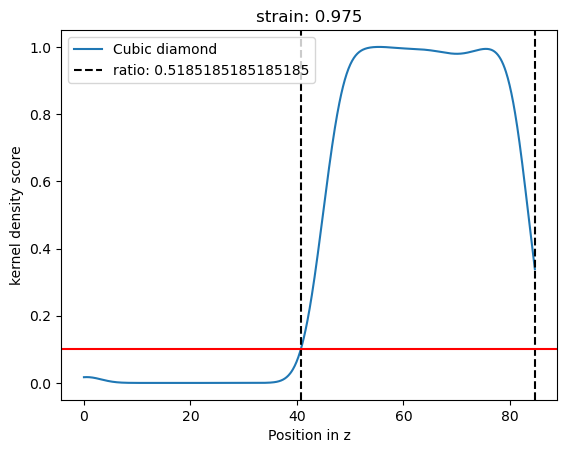

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


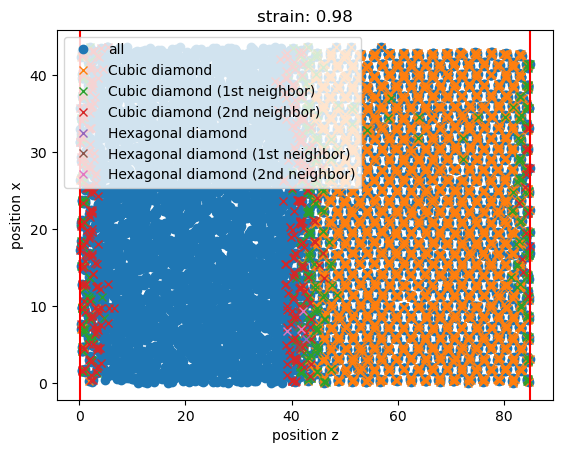

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


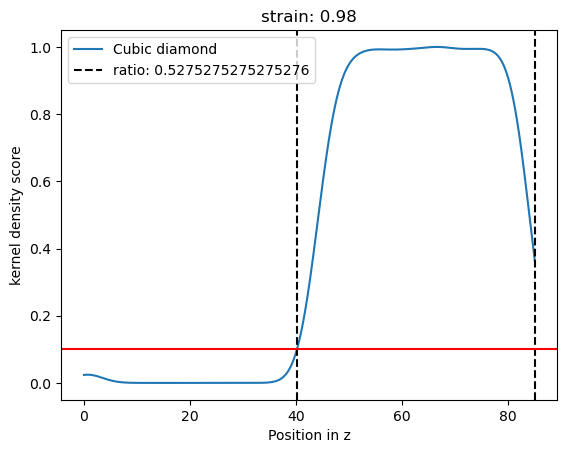

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


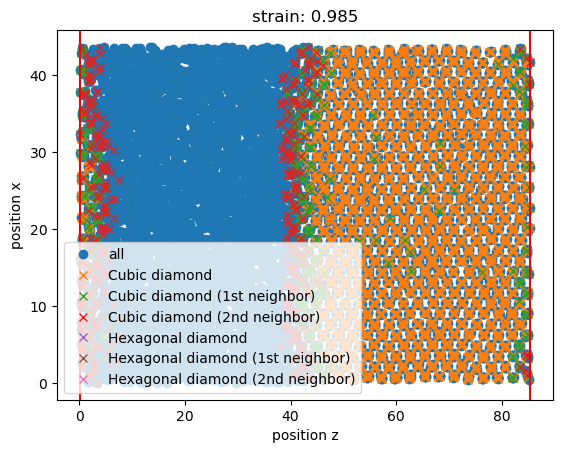

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


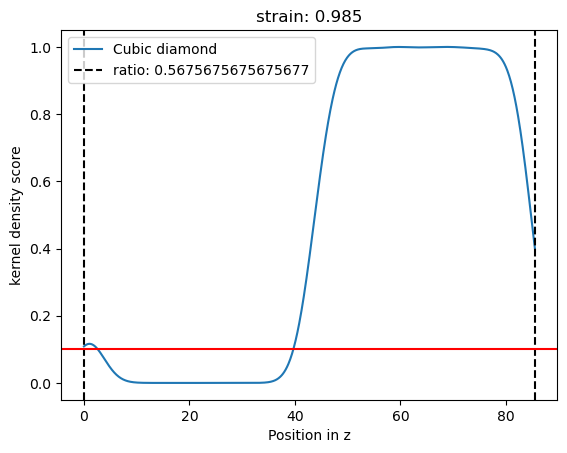

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


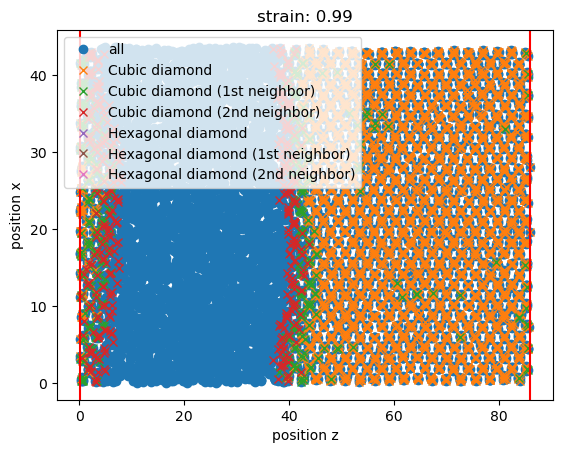

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


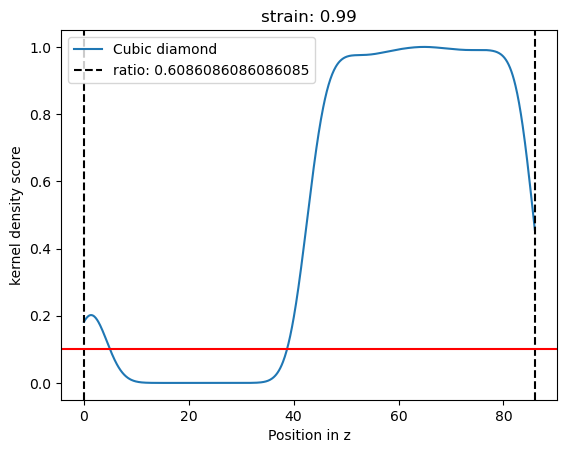

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


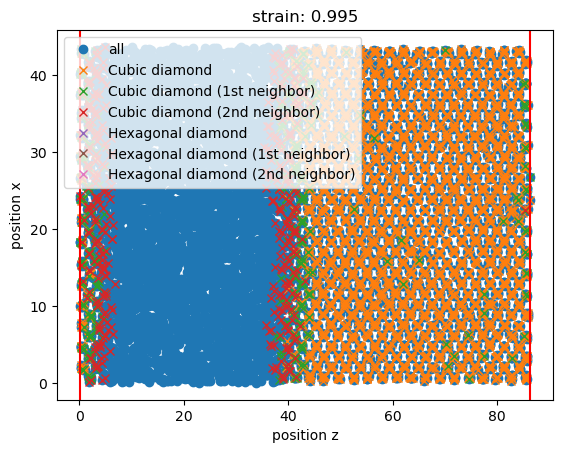

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


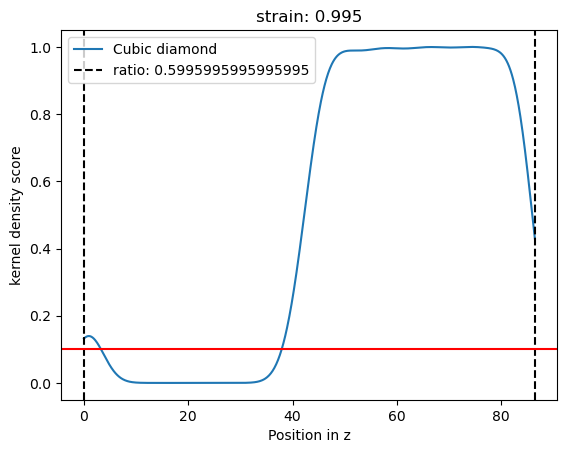

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


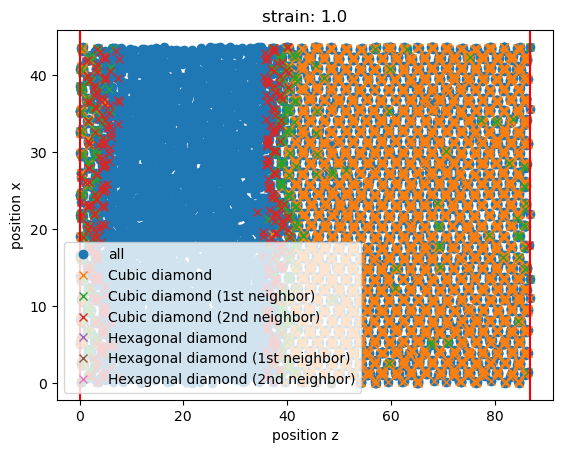

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


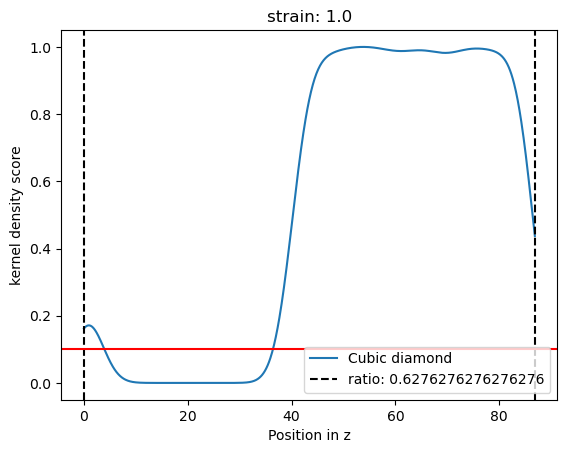

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


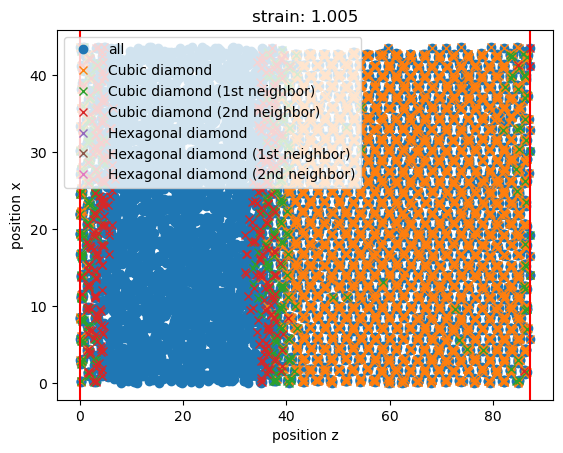

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


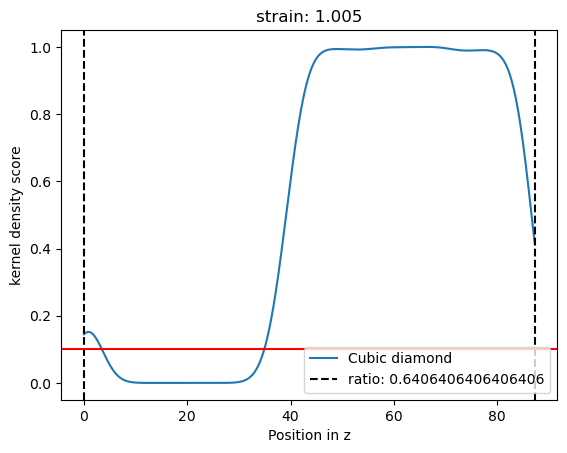

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


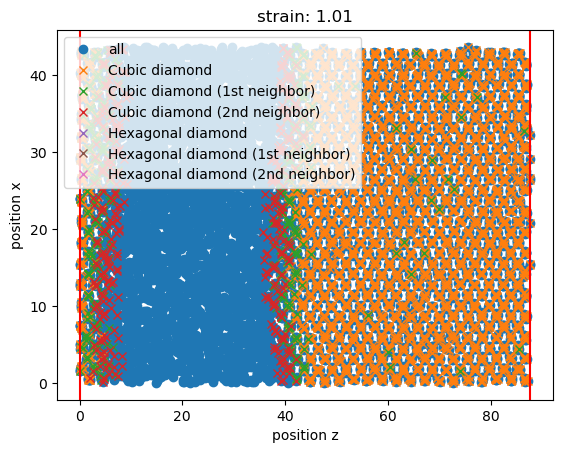

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


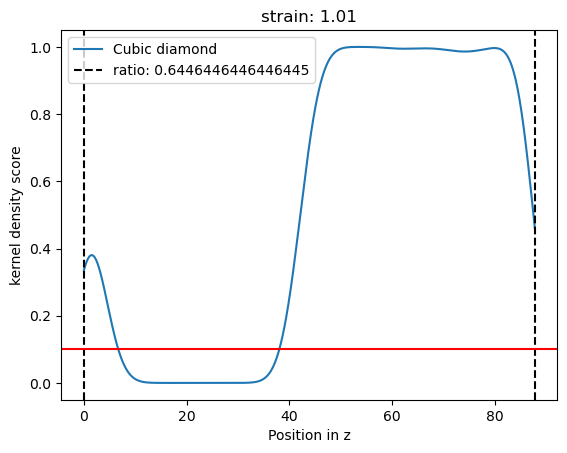

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


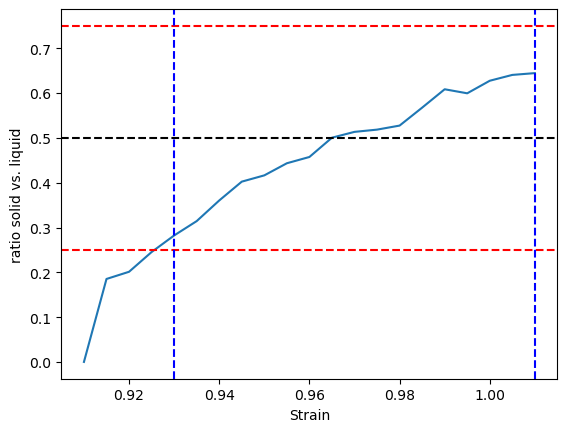

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


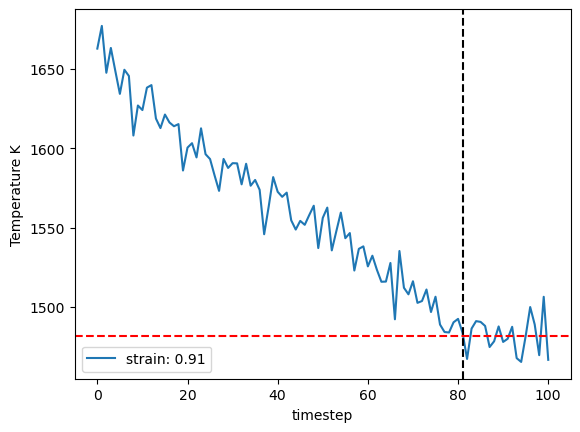

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


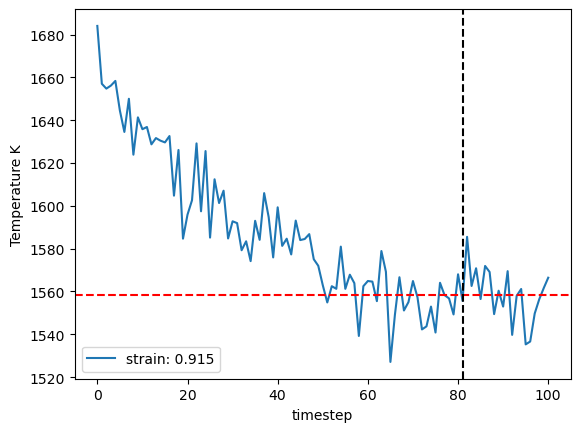

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


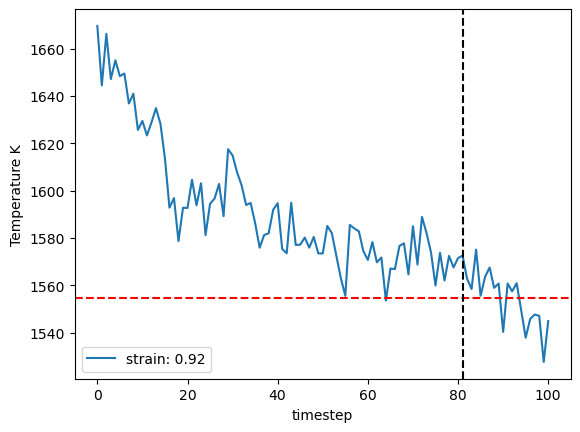

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


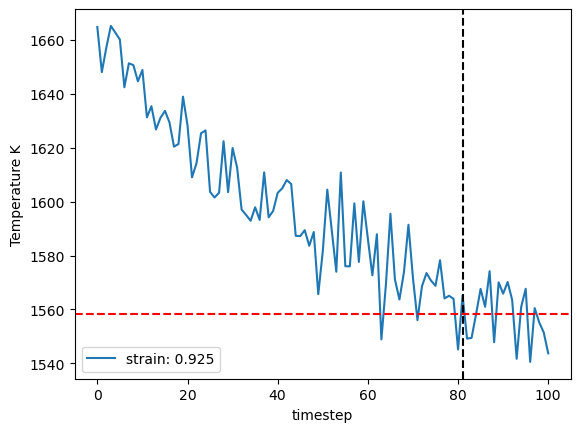

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


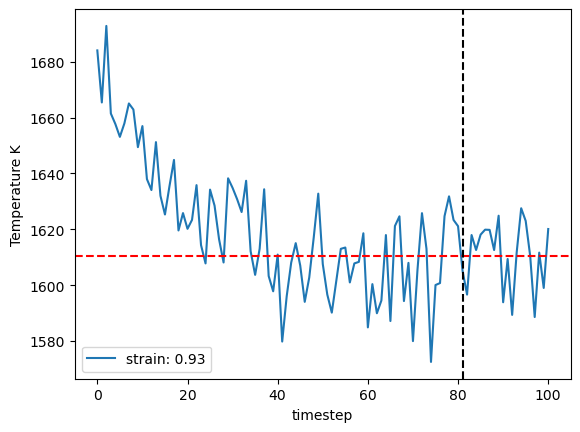

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


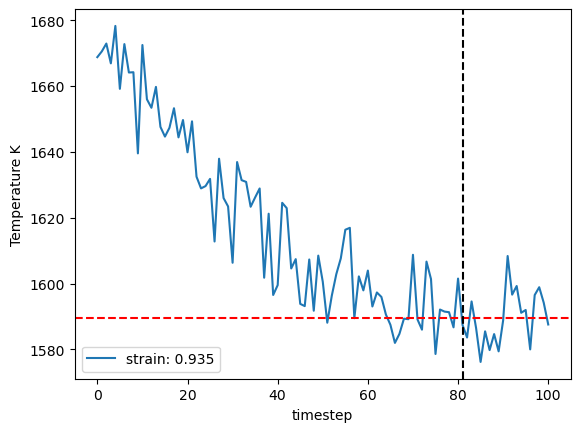

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


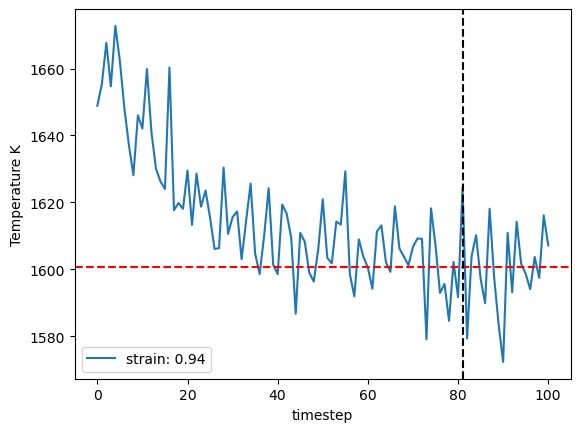

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


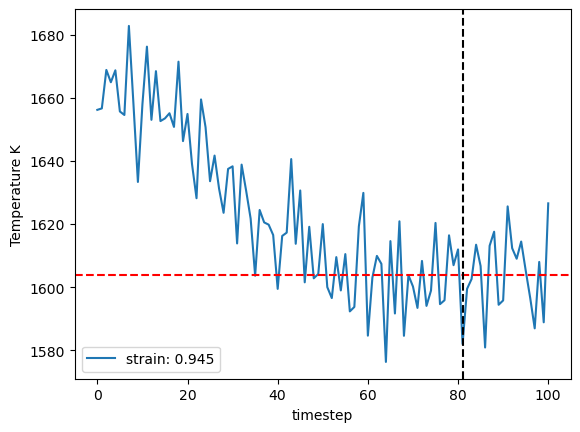

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


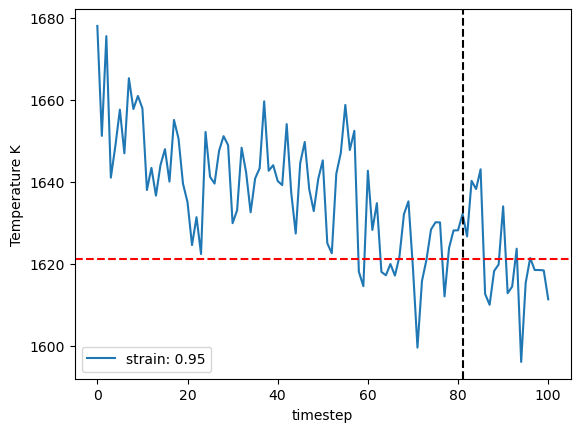

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


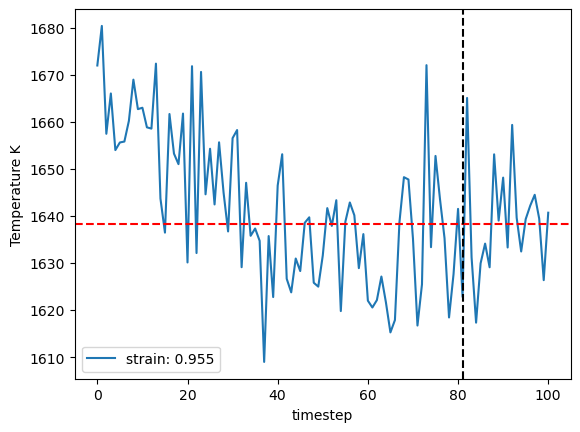

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


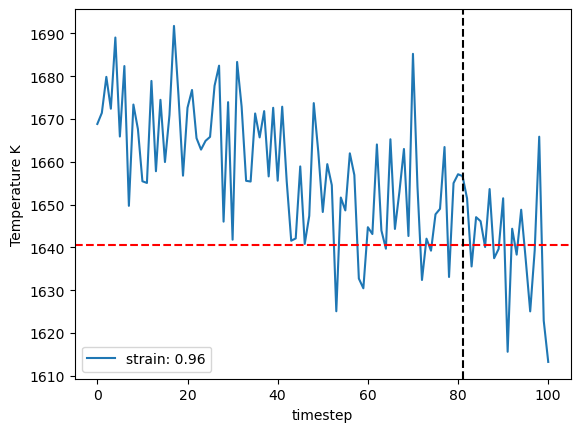

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


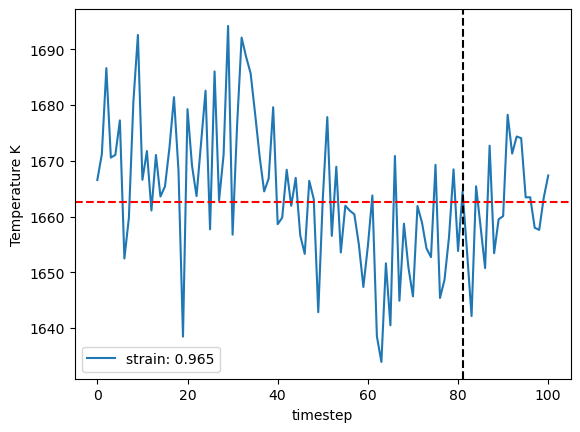

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


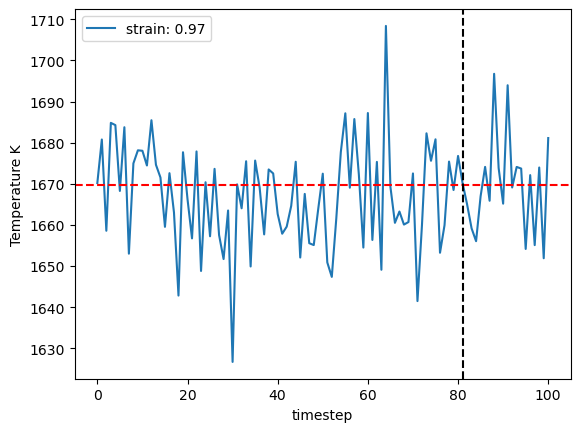

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


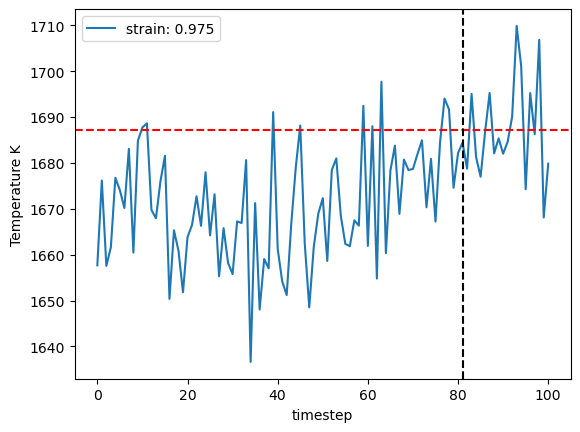

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


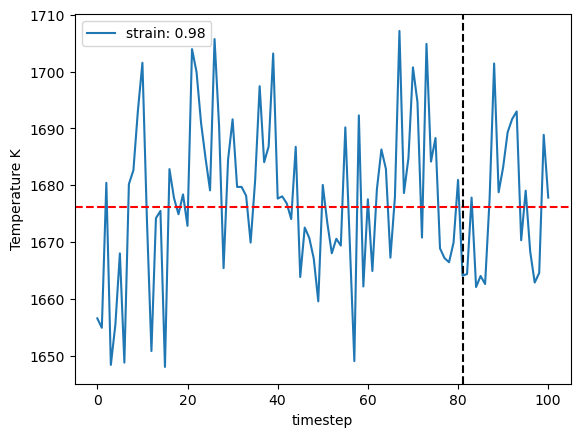

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


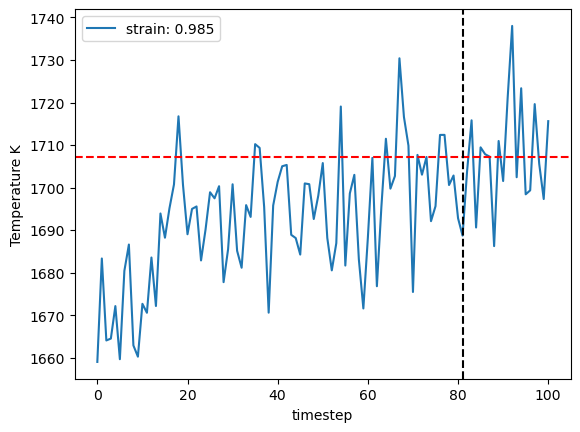

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


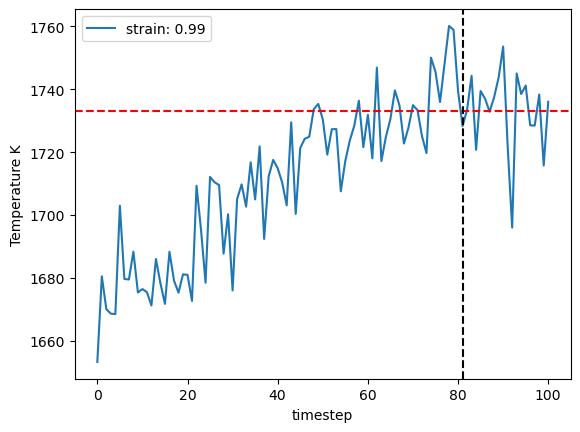

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


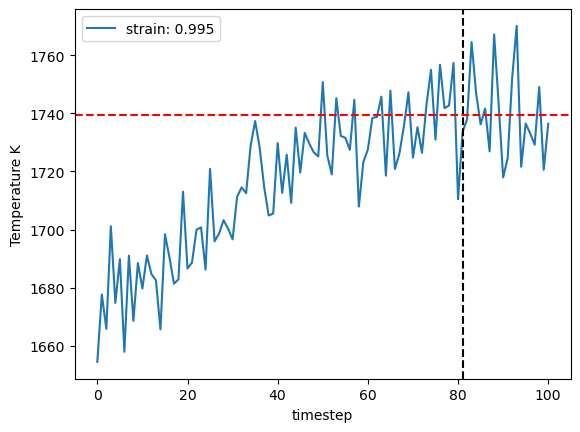

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


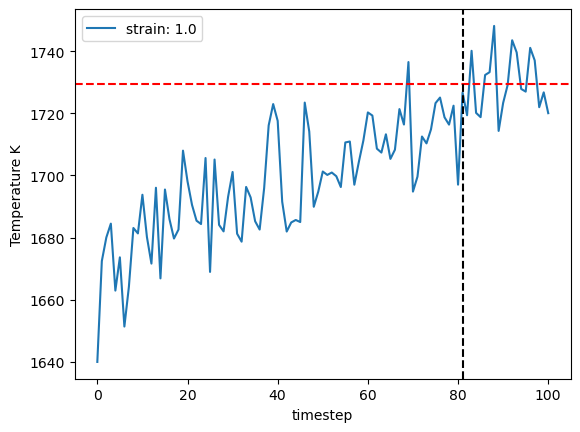

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


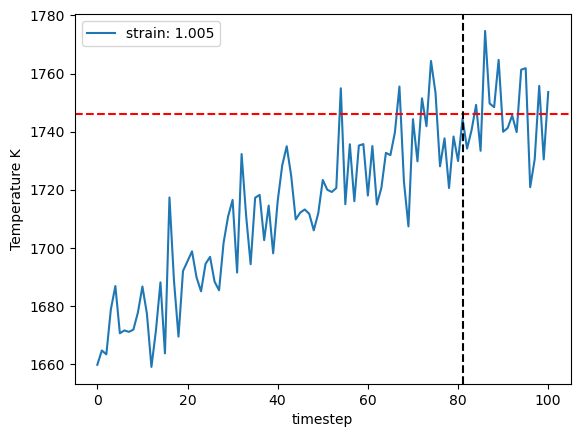

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


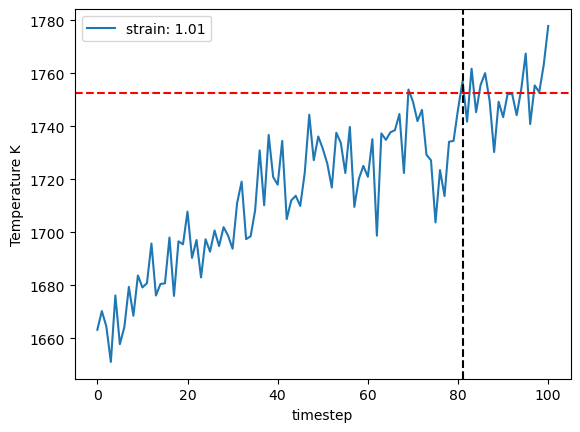

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


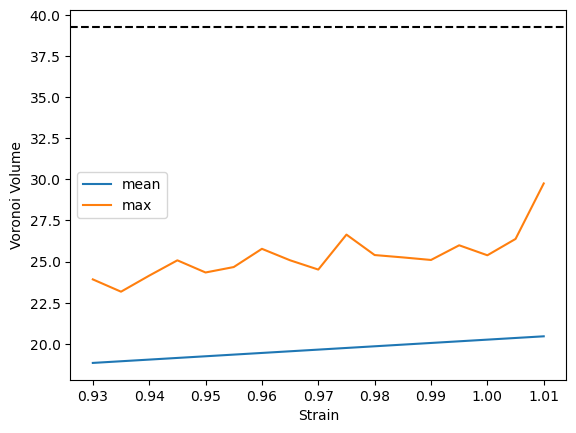

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


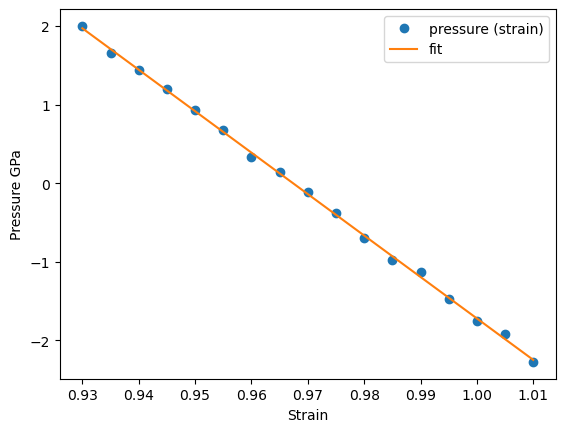

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


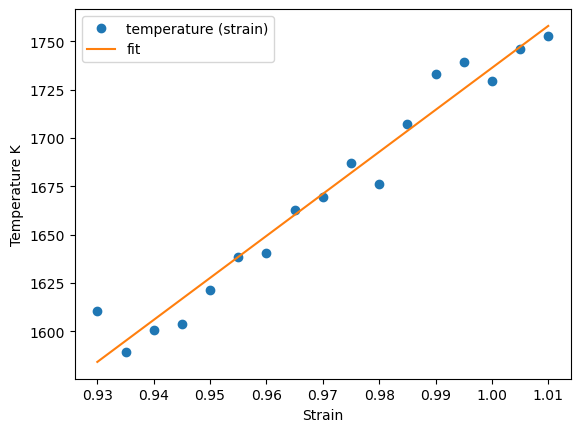

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


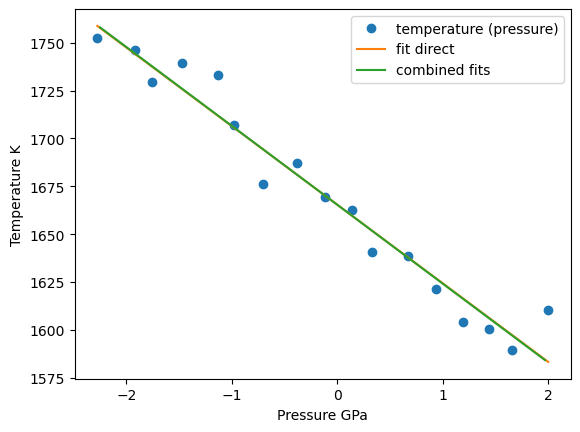

1665.3999517106286 1665.3801776492155
1665.3999517106286 1671.1151140903412 1630.3247617600946 1711.9054664205878
{'timestep': 2, 'fit_range': 0.01, 'nve_run_time_steps': 20000, 'boundary_value': 0.25, 'ratio_boundary': 0.25, 'temperature_next': 1665.3999517106286, 'center': 0.97}


In [36]:
temperature_estimate_lst, temperature_calculated_lst = [], []
while len(temperature_calculated_lst) < 3 or not convergence_goal_achieved and len(temperature_calculated_lst) < 10:
    temperature_estimate_lst.append(temperature_next)
    temperature_next, temperature_mean, temperature_left, temperature_right, strain_result_lst, pressure_result_lst = calc_temp_iteration(
        basis=ham_minimize_vol.get_structure().repeat([1,1,2]), 
        temperature_next=temperature_next, 
        project_parameter=project_parameter,
        timestep=timestep,
        nve_run_time_steps=nve_run_time_steps, 
        fit_range=fit_range,  
        center=center,
        debug_plot=True)
    print(temperature_next, temperature_mean, temperature_left, temperature_right)
    output = validate_convergence(pr=pr,
                                  temperature_left=temperature_left, 
                                  temperature_next=temperature_next, 
                                  temperature_right=temperature_right, 
                                  enable_iteration=enable_iteration,
                                  timestep_iter=timestep_iter,
                                  timestep_lst=project_parameter['timestep_lst'],
                                  timestep=timestep,
                                  fit_range_iter=fit_range_iter, 
                                  fit_range_lst=project_parameter['fit_range_lst'], 
                                  fit_range=fit_range, 
                                  nve_run_time_steps_iter=nve_run_time_steps_iter, 
                                  nve_run_time_steps_lst=project_parameter['nve_run_time_steps_lst'], 
                                  nve_run_time_steps=nve_run_time_steps,
                                  strain_result_lst=strain_result_lst, 
                                  pressure_result_lst=pressure_result_lst, 
                                  step_count=step_count, 
                                  step_dict=step_dict, 
                                  boundary_value=project_parameter['boundary_value'], 
                                  ratio_boundary=project_parameter['ratio_boundary'],
                                  convergence_goal=project_parameter['convergence_criterion'],
                                  output_file=output_file)
    convergence_goal_achieved, enable_iteration, step_count, step_dict, timestep, fit_range, nve_run_time_steps, boundary_value, ratio_boundary, temperature_next, center = output
    print(step_dict[step_count])
    temperature_calculated_lst.append(temperature_next)

In [37]:
if not os.path.exists(output_file):
    with open(output_file, 'w') as f:
        json.dump(step_dict, f)

In [38]:
step_dict

{0: {'temperature_next': 2992},
 1: {'timestep': 2,
  'fit_range': 0.05,
  'nve_run_time_steps': 25000,
  'boundary_value': 0.25,
  'ratio_boundary': 0.25,
  'temperature_next': 2692.8,
  'center': 1.0},
 2: {'timestep': 2,
  'fit_range': 0.05,
  'nve_run_time_steps': 25000,
  'boundary_value': 0.25,
  'ratio_boundary': 0.25,
  'temperature_next': 2423.5200000000004,
  'center': 1.0},
 3: {'timestep': 2,
  'fit_range': 0.05,
  'nve_run_time_steps': 25000,
  'boundary_value': 0.25,
  'ratio_boundary': 0.25,
  'temperature_next': 2181.168,
  'center': 1.0},
 4: {'timestep': 2,
  'fit_range': 0.05,
  'nve_run_time_steps': 25000,
  'boundary_value': 0.25,
  'ratio_boundary': 0.25,
  'temperature_next': 1963.053,
  'center': 1.0},
 5: {'timestep': 2,
  'fit_range': 0.05,
  'nve_run_time_steps': 25000,
  'boundary_value': 0.25,
  'ratio_boundary': 0.25,
  'temperature_next': 1849.9678086355552,
  'center': 0.91},
 6: {'timestep': 2,
  'fit_range': 0.05,
  'nve_run_time_steps': 25000,
  'boun

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family ['Times New Roman'] not found. Falling back to DejaVu Sans.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.


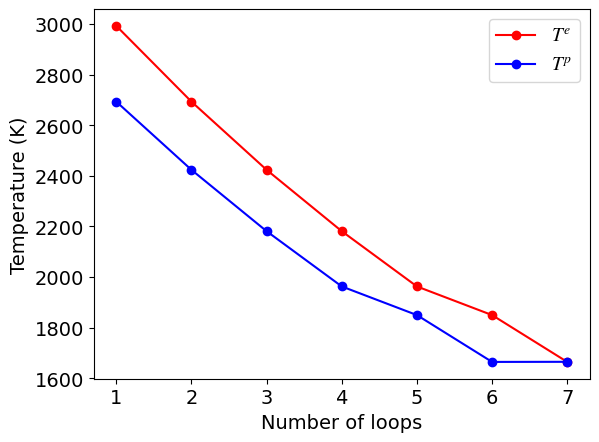

In [39]:
#plot the convergence of loop calculations
first_key = list(step_dict.keys())[-1]
second_key = 'temperature_next'
allt = [step_dict[key][second_key] for key in list(step_dict.keys())]
plt.plot(np.arange(1, len(allt)), allt[0:-1], 'ro-', label=r"$T^e$")
plt.plot(np.arange(1, len(allt)), allt[1:], 'bo-', label=r"$T^p$")
plt.legend(fontsize=14)
plt.tick_params(axis='both', labelsize=14)
plt.xlabel('Number of loops', fontsize=14)
plt.ylabel('Temperature (K)', fontsize=14)
plt.show()

In [40]:
df = pr.job_table()
df

,id,status,chemicalformula,job,subjob,projectpath,project,timestart,timestop,totalcputime,computer,hamilton,hamversion,parentid,masterid
0,19,finished,Fe4394,temp_heating_1625_0,/temp_heating_1625_0,/scratch/janssen/pyiron_meltingpoint/,melting/,2023-06-28 08:06:49.070773,2023-06-28 08:06:51.689618,2.0,pyiron@ljubi#12,Lammps,0.1,NaN,None
1,20,finished,Fe4394,temp_heating_1687_5,/temp_heating_1687_5,/scratch/janssen/pyiron_meltingpoint/,melting/,2023-06-28 08:06:52.706454,2023-06-28 08:06:54.354728,1.0,pyiron@ljubi#12,Lammps,0.1,NaN,None
2,21,finished,Fe4394,temp_heating_1718_75,/temp_heating_1718_75,/scratch/janssen/pyiron_meltingpoint/,melting/,2023-06-28 08:06:55.346286,2023-06-28 08:06:57.026526,1.0,pyiron@ljubi#12,Lammps,0.1,NaN,None
3,22,finished,Fe4394,temp_heating_1703_125,/temp_heating_1703_125,/scratch/janssen/pyiron_meltingpoint/,melting/,2023-06-28 08:06:58.037308,2023-06-28 08:06:59.772702,1.0,pyiron@ljubi#12,Lammps,0.1,NaN,None
4,23,finished,Fe4394,temp_heating_1710_9375,/temp_heating_1710_9375,/scratch/janssen/pyiron_meltingpoint/,melting/,2023-06-28 08:07:00.772416,2023-06-28 08:07:02.410603,1.0,pyiron@ljubi#12,Lammps,0.1,NaN,None
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1045,1089,finished,Si8192,ham_nve_0_99_1664_97_0,/ham_nve_0_99_1664_97_0,/scratch/janssen/pyiron_meltingpoint/,melting/,2023-07-03 21:01:07.279498,2023-07-03 21:02:40.074627,92.0,pyiron@ljubi#12,Lammps,0.1,1068.0,None
1046,1090,finished,Si8192,ham_nve_0_995_1664_97_0,/ham_nve_0_995_1664_97_0,/scratch/janssen/pyiron_meltingpoint/,melting/,2023-07-03 21:02:40.632252,2023-07-03 21:04:12.154222,91.0,pyiron@ljubi#12,Lammps,0.1,1069.0,None
1047,1091,finished,Si8192,ham_nve_1_0_1664_97_0,/ham_nve_1_0_1664_97_0,/scratch/janssen/pyiron_meltingpoint/,melting/,2023-07-03 21:04:12.694153,2023-07-03 21:05:42.758703,90.0,pyiron@ljubi#12,Lammps,0.1,1070.0,None
1048,1092,finished,Si8192,ham_nve_1_005_1664_97_0,/ham_nve_1_005_1664_97_0,/scratch/janssen/pyiron_meltingpoint/,melting/,2023-07-03 21:05:43.311083,2023-07-03 21:07:11.667371,88.0,pyiron@ljubi#12,Lammps,0.1,1071.0,None
